# Phase 1: Jigsaw Puzzle Edge Detection Pipeline

This pipeline processes puzzle images to detect and enhance piece edges:
1. Load puzzle images (2x2, 4x4, 8x8 grids)
2. Detect grid size automatically
3. Split into individual pieces
4. Apply edge detection (CLAHE + Bilateral Filter + Canny)
5. Save processed artifacts for analysis


## 1. Imports and Configuration


In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import json
from pathlib import Path
from PIL import Image
from image_utils import load_image, detect_grid_size, split_image

%matplotlib inline


In [2]:
# Configuration
BASE_DIR = "./Gravity Falls"
OUTPUT_DIR = "./processed_artifacts"

# Processing parameters
GAUSSIAN_KERNEL_SIZE = (5, 5)
CANNY_THRESHOLD_LOW = 50
CANNY_THRESHOLD_HIGH = 150
CLAHE_CLIP_LIMIT = 2.0
CLAHE_TILE_GRID_SIZE = (8, 8)
MORPH_KERNEL_SIZE = (3, 3)

# Create output directory structure
os.makedirs(OUTPUT_DIR, exist_ok=True)
for puzzle_type in ['puzzle_2x2', 'puzzle_4x4', 'puzzle_8x8']:
    os.makedirs(os.path.join(OUTPUT_DIR, puzzle_type), exist_ok=True)


## 2. Enhancement Functions for Puzzle Pieces


In [3]:
def visualize_grid_detection(image, grid_size):
    """Visualize gradient analysis for grid detection."""
    if len(image.shape) == 3:
        gray = np.mean(image, axis=2)
    else:
        gray = image
    
    grad_y = np.abs(np.diff(gray, axis=0))
    grad_x = np.abs(np.diff(gray, axis=1))
    row_profile = np.mean(grad_y, axis=1)
    col_profile = np.mean(grad_x, axis=0)
    
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))
    axes[0, 0].imshow(gray, cmap='gray')
    axes[0, 0].set_title('Grayscale Image')
    axes[0, 0].axis('off')
    
    axes[0, 1].imshow(grad_y, cmap='hot')
    axes[0, 1].set_title('Vertical Gradients')
    axes[0, 1].axis('off')
    
    axes[1, 0].plot(row_profile)
    axes[1, 0].set_title(f'Row Profile (Detected: {grid_size}x{grid_size})')
    axes[1, 0].set_xlabel('Row')
    axes[1, 0].set_ylabel('Gradient Intensity')
    
    axes[1, 1].plot(col_profile)
    axes[1, 1].set_title('Column Profile')
    axes[1, 1].set_xlabel('Column')
    axes[1, 1].set_ylabel('Gradient Intensity')
    
    plt.tight_layout()
    plt.show()

def visualize_patches(patches, grid_size):
    """Visualize split patches with indices."""
    fig, axes = plt.subplots(grid_size, grid_size, figsize=(12, 12))
    
    if grid_size > 1:
        axes = axes.flatten()
    else:
        axes = [axes]
    
    for idx, ax in enumerate(axes):
        if idx < len(patches):
            ax.imshow(patches[idx])
            ax.set_title(f"Piece {idx}")
            ax.axis('off')
    
    plt.tight_layout()
    plt.show()

def enhance_puzzle_piece(patch, apply_clahe=True, apply_morphology=True):
    """Edge detection pipeline for puzzle pieces.
    
    Steps:
    1. Grayscale conversion
    2. CLAHE contrast enhancement
    3. Bilateral filtering (noise reduction + edge preservation)
    4. Gaussian smoothing
    5. Canny edge detection
    6. Morphological closing (connect broken edges)
    """
    processing_steps = {}

    image_gray = cv2.cvtColor(patch, cv2.COLOR_BGR2GRAY)
    processing_steps['grayscale'] = image_gray.copy()
    
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(image_gray)
    processing_steps['clahe'] = enhanced.copy()
    
    bilateral = cv2.bilateralFilter(enhanced, 9, 75, 75)
    processing_steps['bilateral'] = bilateral.copy()
    
    image_blurred = cv2.GaussianBlur(bilateral, (3, 3), 0)
    processing_steps['blurred'] = image_blurred.copy()
    
    edges = cv2.Canny(image_blurred, threshold1=30, threshold2=100)
    processing_steps['canny_edges'] = edges.copy()
    
    kernel = np.ones((2, 2), np.uint8)
    edges_closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
    processing_steps['morphology'] = edges_closed.copy()
    
    return image_blurred, edges_closed, processing_steps


In [4]:
def process_puzzle_image(image_path, output_base_dir, save_artifacts=True, visualize=False):
    """Process a single puzzle image through the edge detection pipeline."""
    path_parts = Path(image_path).parts
    puzzle_type = None
    image_id = None
    
    for part in path_parts:
        if 'puzzle_' in part:
            puzzle_type = part
        if part.endswith('.jpg') or part.endswith('.png'):
            image_id = Path(part).stem
    
    if puzzle_type is None or image_id is None:
        return None
    
    image = load_image(image_path)
    if image is None:
        return None
    
    grid_size = detect_grid_size(image_path)
    if grid_size is None:
        return None
    
    patches = split_image(image, grid_size)
    print(f"  Split into {len(patches)} pieces")
    
    if visualize:
        visualize_grid_detection(image, grid_size)
        visualize_patches(patches, grid_size)
    
    enhanced_patches = []
    edge_images = []
    
    for idx, patch in enumerate(patches):
        enhanced, edges, steps = enhance_puzzle_piece(patch)
        enhanced_patches.append(enhanced)
        edge_images.append(edges)
    
    # Step 5: Save artifacts
    if save_artifacts:
        image_output_dir = os.path.join(output_base_dir, puzzle_type, f"image_{image_id}")
        os.makedirs(image_output_dir, exist_ok=True)
        
        # Create subdirectories
        enhanced_dir = os.path.join(image_output_dir, "enhanced_pieces")
        edges_dir = os.path.join(image_output_dir, "edge_images")
        
        os.makedirs(enhanced_dir, exist_ok=True)
        os.makedirs(edges_dir, exist_ok=True)
        
        # Save enhanced pieces
        for idx, enhanced in enumerate(enhanced_patches):
            cv2.imwrite(os.path.join(enhanced_dir, f"piece_{idx:02d}_enhanced.png"), enhanced)
        
        # Save edge images
        for idx, edges in enumerate(edge_images):
            cv2.imwrite(os.path.join(edges_dir, f"piece_{idx:02d}_edges.png"), edges)
        
        # Save processing metadata
        metadata = {
            'image_path': str(image_path),
            'grid_size': grid_size,
            'num_pieces': len(patches),
            'image_shape': list(image.shape),
            'processing_parameters': {
                'gaussian_kernel_size': GAUSSIAN_KERNEL_SIZE,
                'canny_low': CANNY_THRESHOLD_LOW,
                'canny_high': CANNY_THRESHOLD_HIGH,
                'clahe_clip_limit': CLAHE_CLIP_LIMIT,
                'clahe_tile_size': CLAHE_TILE_GRID_SIZE
            }
        }
        
        with open(os.path.join(image_output_dir, "metadata.json"), 'w') as f:
            json.dump(metadata, f, indent=2)
        
        print(f"  Saved artifacts to {image_output_dir}")
    
    # Step 6: Visualization (optional)
    if visualize and len(patches) > 0:
        visualize_processing_results(patches, enhanced_patches, edge_images, grid_size)
    
    # Return summary
    return {
        'image_path': image_path,
        'puzzle_type': puzzle_type,
        'image_id': image_id,
        'grid_size': grid_size,
        'num_pieces': len(patches),
        'success': True
    }


In [5]:
def visualize_processing_results(original_patches, enhanced_patches, edge_images, grid_size, num_examples=4):
    """
    Visualize before/after processing results for a few example pieces.
    
    NOTE: All patches are processed and saved to disk. This function only displays
    a sample of patches (default: 4) to keep the visualization manageable.
    The patches are evenly distributed across the full set.
    
    Args:
        num_examples: Number of example patches to display (default: 4)
    """
    # Select a few pieces to visualize
    num_to_show = min(num_examples, len(original_patches))
    indices = np.linspace(0, len(original_patches) - 1, num_to_show, dtype=int)
    
    fig, axes = plt.subplots(num_to_show, 3, figsize=(12, 4 * num_to_show))
    
    if num_to_show == 1:
        axes = axes.reshape(1, -1)
    
    for row, idx in enumerate(indices):
        # Original patch
        axes[row, 0].imshow(original_patches[idx])
        axes[row, 0].set_title(f"Original Piece {idx}")
        axes[row, 0].axis('off')
        
        # Enhanced patch
        axes[row, 1].imshow(enhanced_patches[idx], cmap='gray')
        axes[row, 1].set_title(f"Enhanced Piece {idx}")
        axes[row, 1].axis('off')
        
        # Edge image
        axes[row, 2].imshow(edge_images[idx], cmap='gray')
        axes[row, 2].set_title(f"Edges Piece {idx}")
        axes[row, 2].axis('off')
    
    plt.tight_layout()
    plt.show()


## 5. Test on Single Image


  Split into 16 pieces


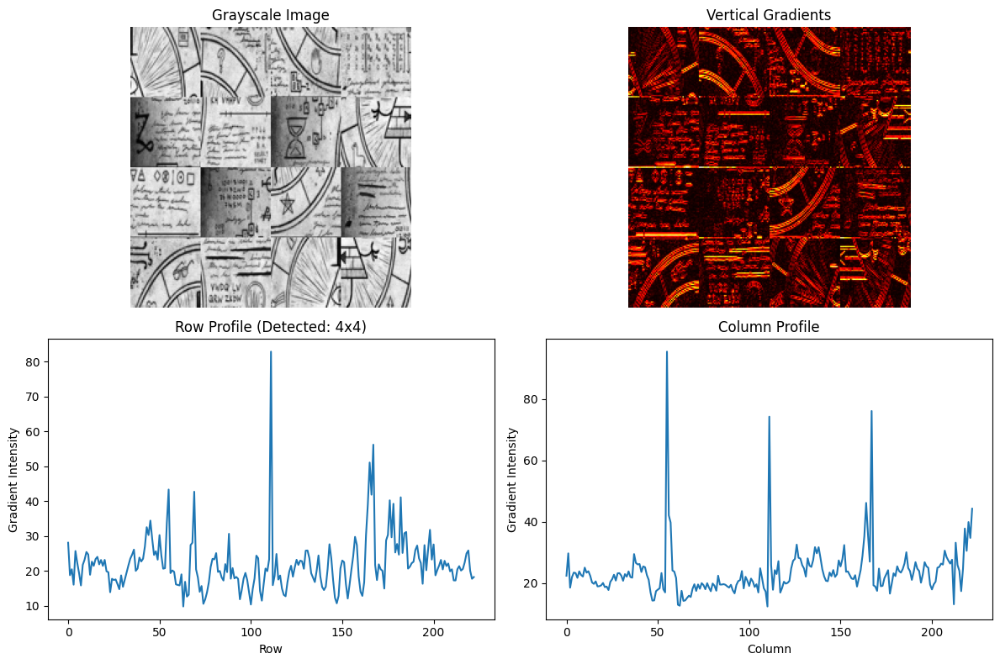

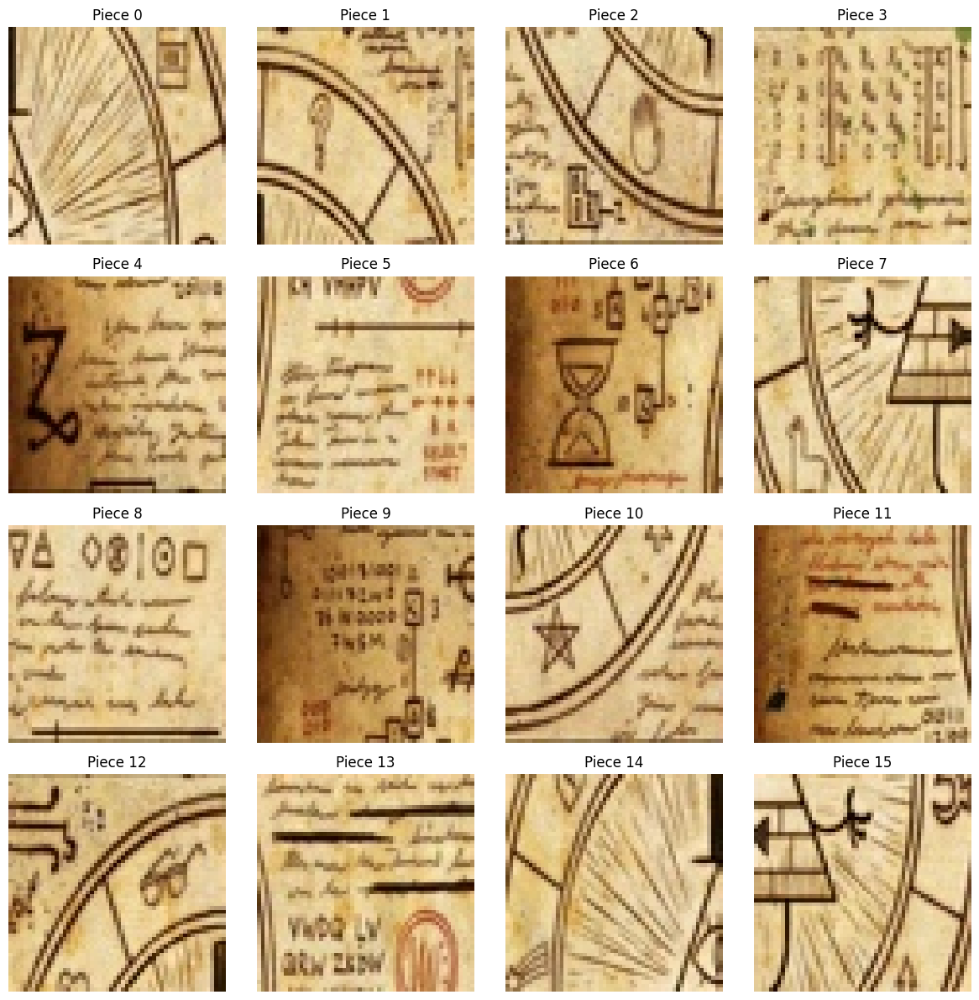

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_6


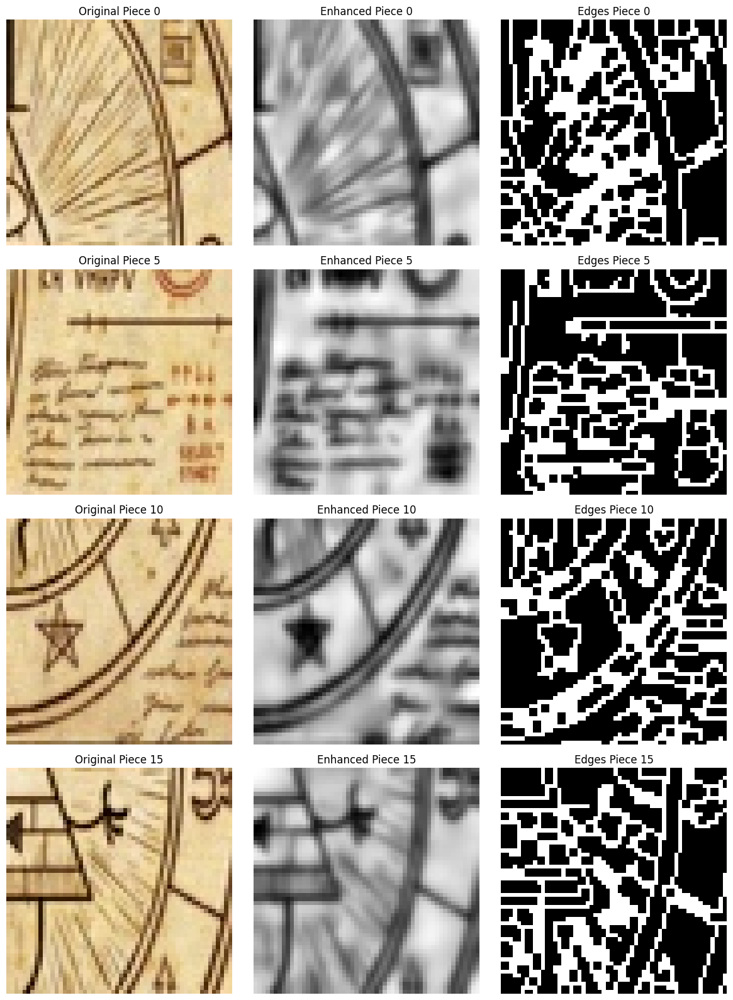


Processing Summary:
  Puzzle Type: puzzle_4x4
  Image ID: 6
  Grid Size: 4x4
  Number of Pieces: 16


In [6]:
# Test the pipeline on a single image
test_image_path = "./Gravity Falls/puzzle_4x4/6.jpg"

result = process_puzzle_image(
    test_image_path, 
    OUTPUT_DIR, 
    save_artifacts=True, 
    visualize=True
)

if result:
    print("\nProcessing Summary:")
    print(f"  Puzzle Type: {result['puzzle_type']}")
    print(f"  Image ID: {result['image_id']}")
    print(f"  Grid Size: {result['grid_size']}x{result['grid_size']}")
    print(f"  Number of Pieces: {result['num_pieces']}")


## 6. Batch Processing: Process Entire Dataset


In [7]:
def process_dataset(base_dir, output_dir, puzzle_types=None, max_images_per_type=None, visualize_every_n=10):
    """
    Process all images in the dataset.
    
    Args:
        base_dir: base directory containing puzzle folders
        output_dir: directory to save processed artifacts
        puzzle_types: list of puzzle types to process (None = all)
        max_images_per_type: maximum number of images to process per type (None = all)
        visualize_every_n: visualize every Nth image
    """
    if puzzle_types is None:
        puzzle_types = ['puzzle_2x2', 'puzzle_4x4', 'puzzle_8x8']
    
    all_results = []
    
    for puzzle_type in puzzle_types:
        puzzle_dir = os.path.join(base_dir, puzzle_type)
        
        if not os.path.exists(puzzle_dir):
            print(f"Directory not found: {puzzle_dir}")
            continue
        
        # Get all image files
        image_files = sorted([f for f in os.listdir(puzzle_dir) if f.endswith(('.jpg', '.png', '.jpeg'))])
        
        if max_images_per_type:
            image_files = image_files[:max_images_per_type]
        
        print(f"\n{'='*60}")
        print(f"Processing {puzzle_type}: {len(image_files)} images")
        print(f"{'='*60}")
        
        for idx, image_file in enumerate(image_files):
            image_path = os.path.join(puzzle_dir, image_file)
            
            # Visualize every Nth image
            should_visualize = (idx % visualize_every_n == 0)
            
            result = process_puzzle_image(
                image_path, 
                output_dir, 
                save_artifacts=True, 
                visualize=should_visualize
            )
            
            if result:
                all_results.append(result)
            
            # Progress update
            if (idx + 1) % 10 == 0:
                print(f"  Progress: {idx + 1}/{len(image_files)} images processed")
    
    # Save overall summary
    summary = {
        'total_images_processed': len(all_results),
        'results_by_type': {},
        'processing_parameters': {
            'gaussian_kernel_size': GAUSSIAN_KERNEL_SIZE,
            'canny_low': CANNY_THRESHOLD_LOW,
            'canny_high': CANNY_THRESHOLD_HIGH,
            'clahe_clip_limit': CLAHE_CLIP_LIMIT,
            'clahe_tile_size': CLAHE_TILE_GRID_SIZE
        }
    }
    
    for result in all_results:
        puzzle_type = result['puzzle_type']
        if puzzle_type not in summary['results_by_type']:
            summary['results_by_type'][puzzle_type] = 0
        summary['results_by_type'][puzzle_type] += 1
    
    summary_path = os.path.join(output_dir, 'processing_summary.json')
    with open(summary_path, 'w') as f:
        json.dump(summary, f, indent=2)
    
    print(f"\n{'='*60}")
    print("Processing Complete!")
    print(f"Total images processed: {len(all_results)}")
    print(f"Summary saved to: {summary_path}")
    print(f"{'='*60}")
    
    return all_results, summary



Processing puzzle_2x2: 110 images
  Split into 4 pieces


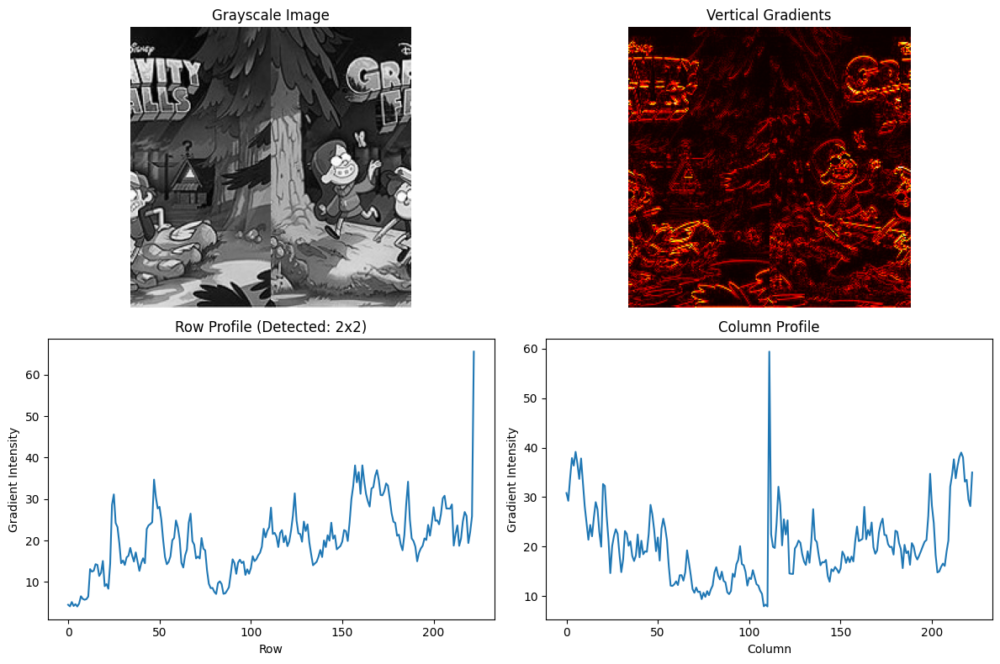

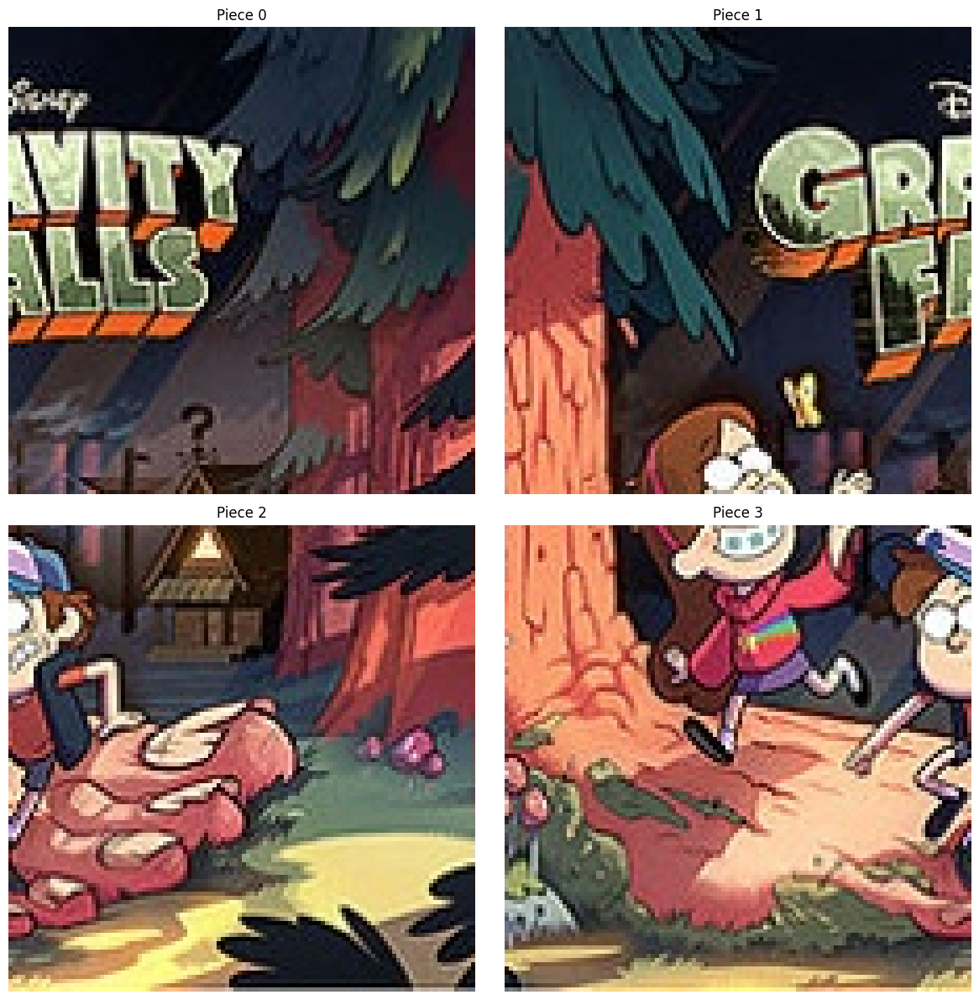

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_0


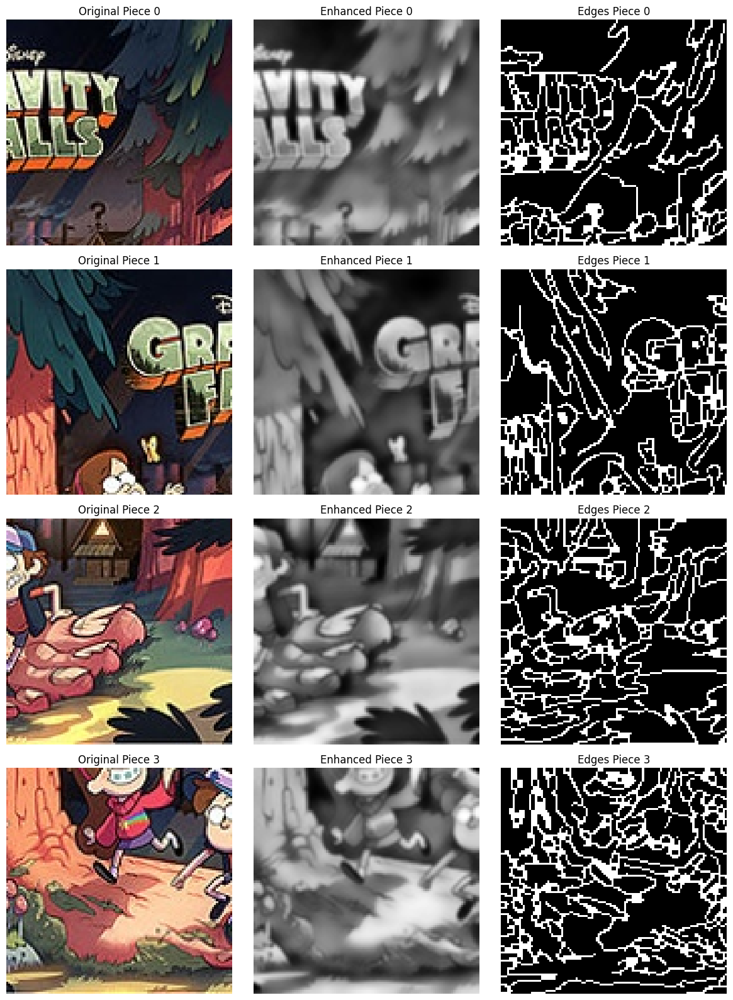

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_1
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_10
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_100
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_101
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_102
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_103
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_104
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_105
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_106
  Progress: 10/110 images processed
  Split into 4 pieces


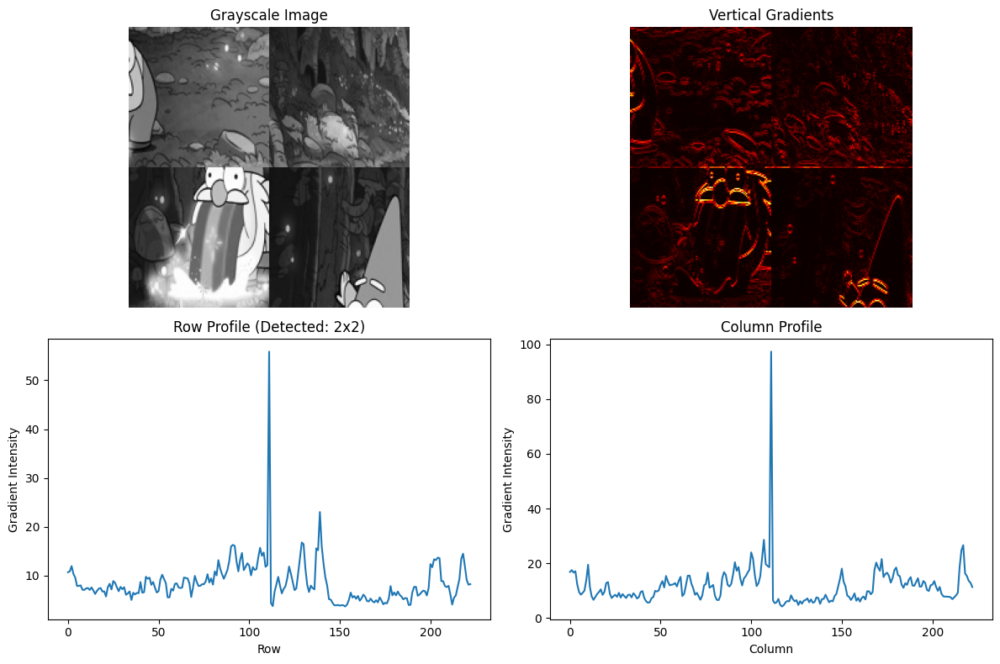

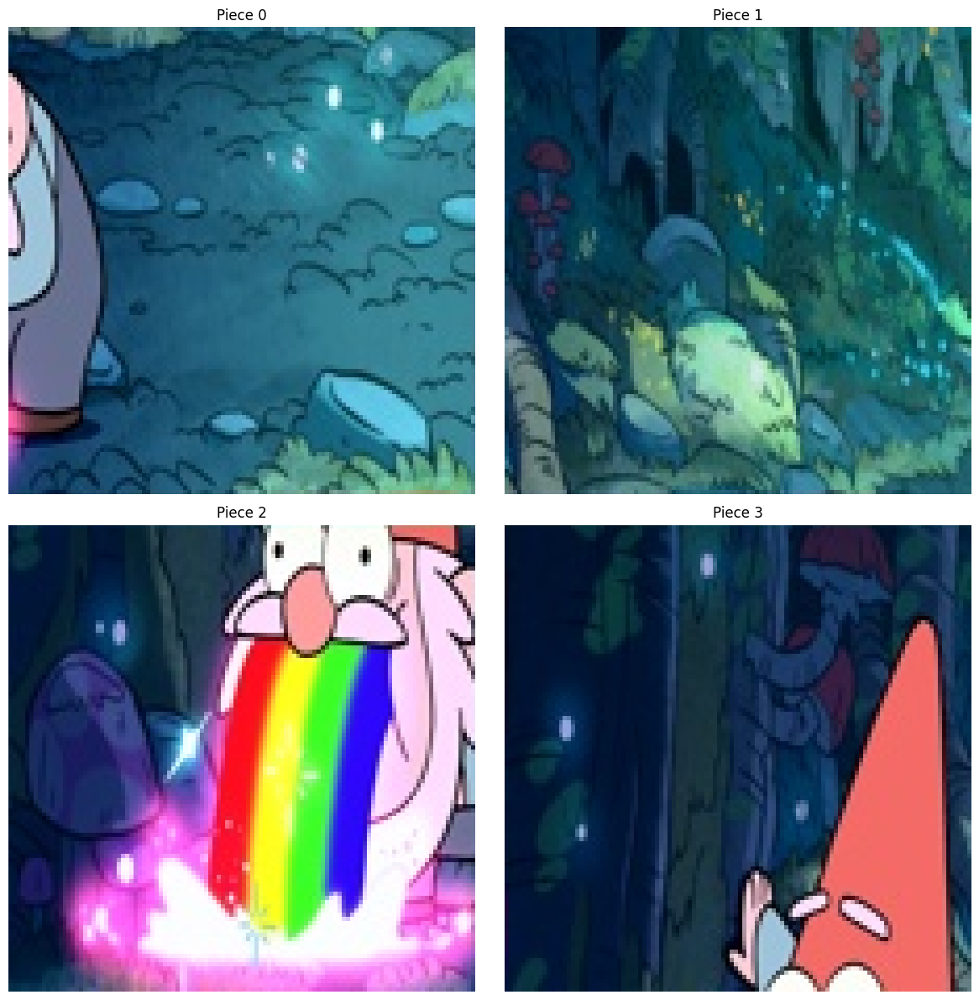

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_107


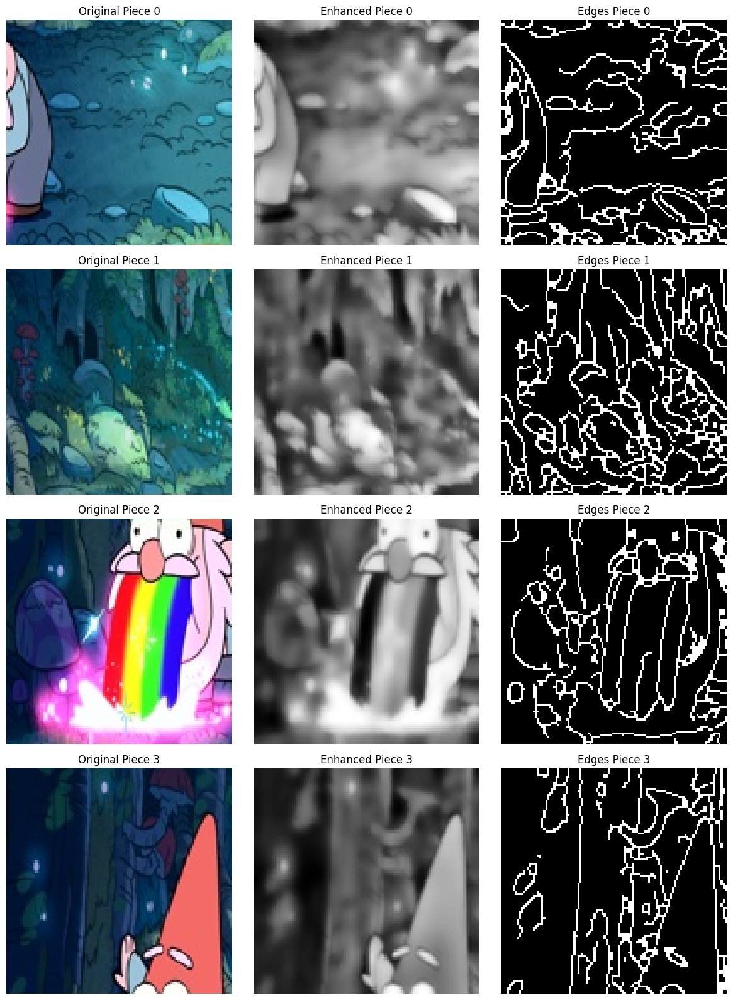

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_108
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_109
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_11
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_12
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_13
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_14
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_15
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_16
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_17
  Progress: 20/110 images processed
  Split into 4 pieces


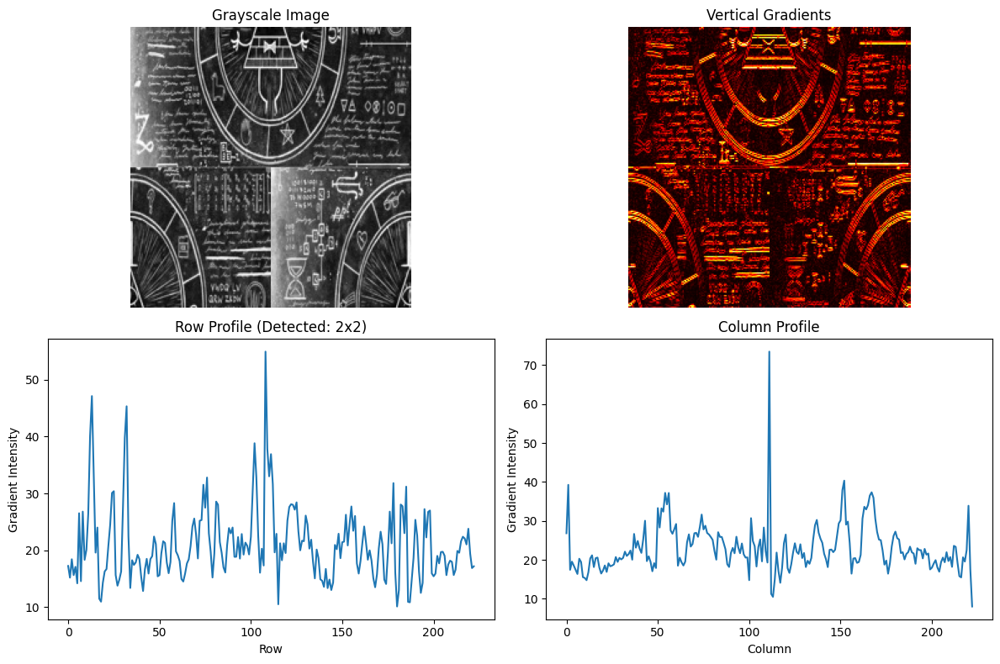

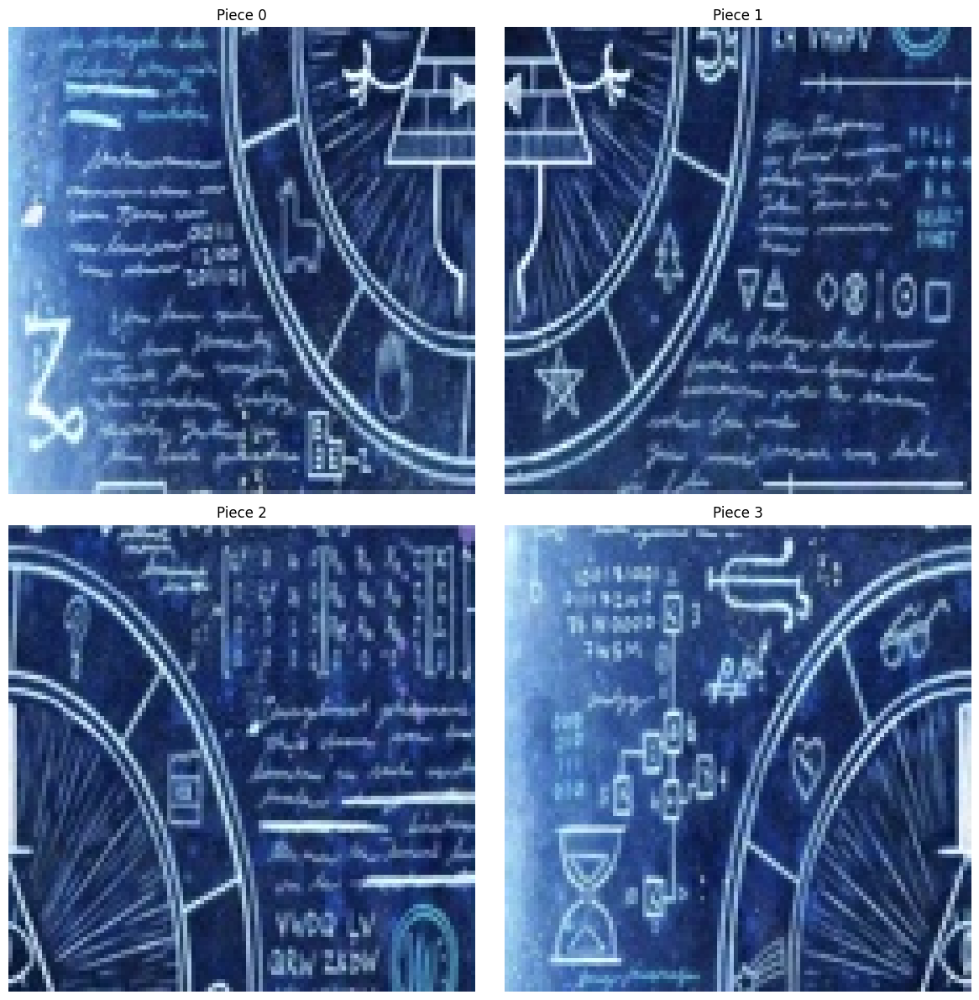

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_18


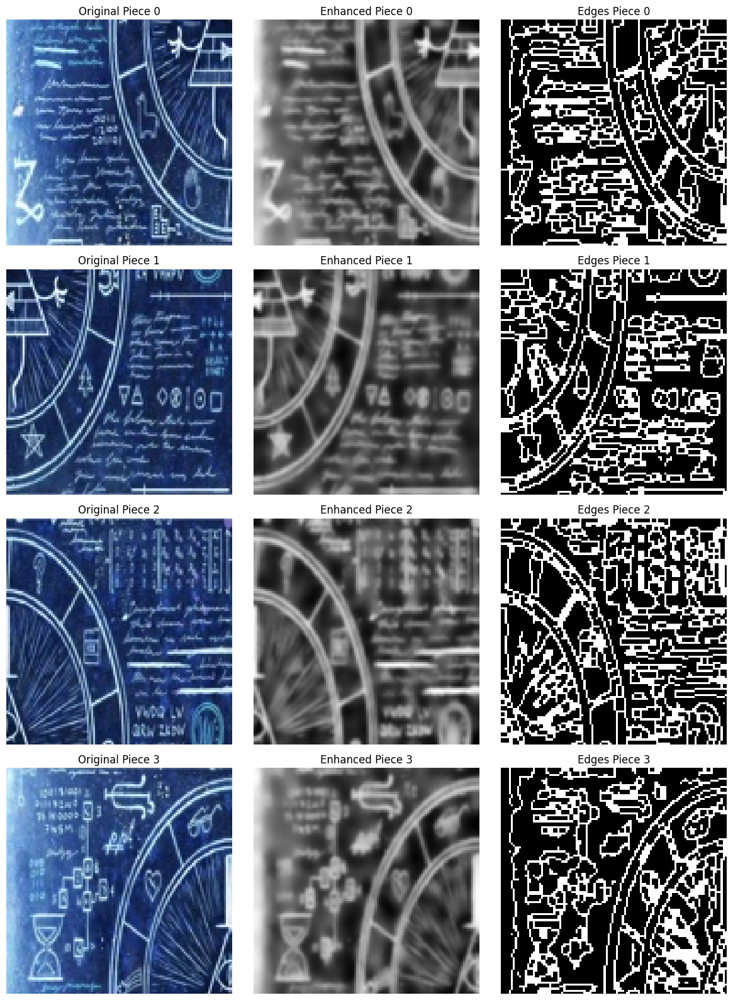

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_19
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_2
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_20
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_21
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_22
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_23
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_24
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_25
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_26
  Progress: 30/110 images processed
  Split into 16 pieces


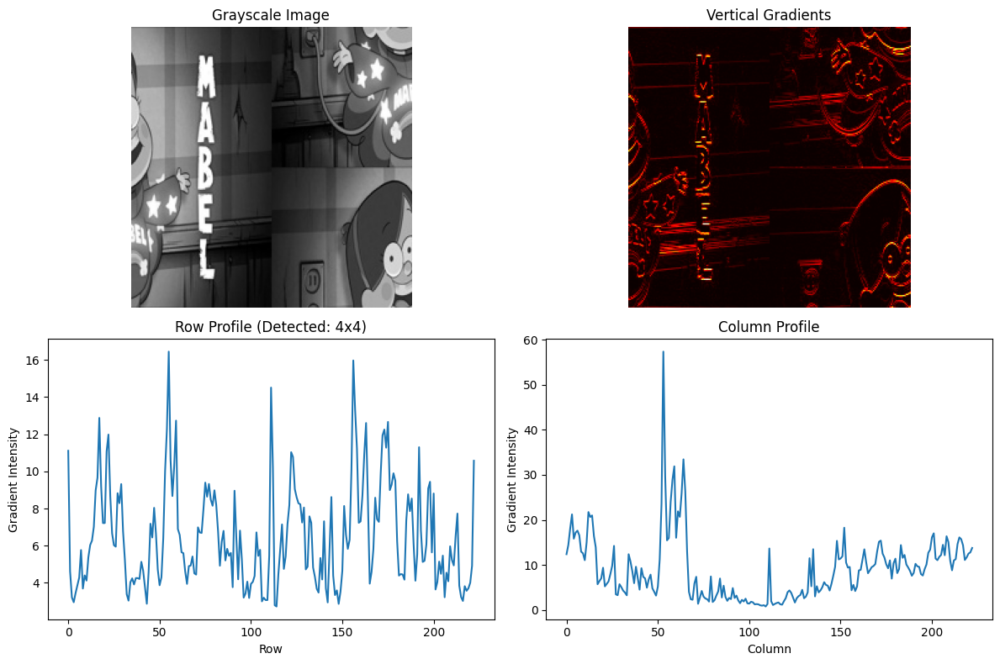

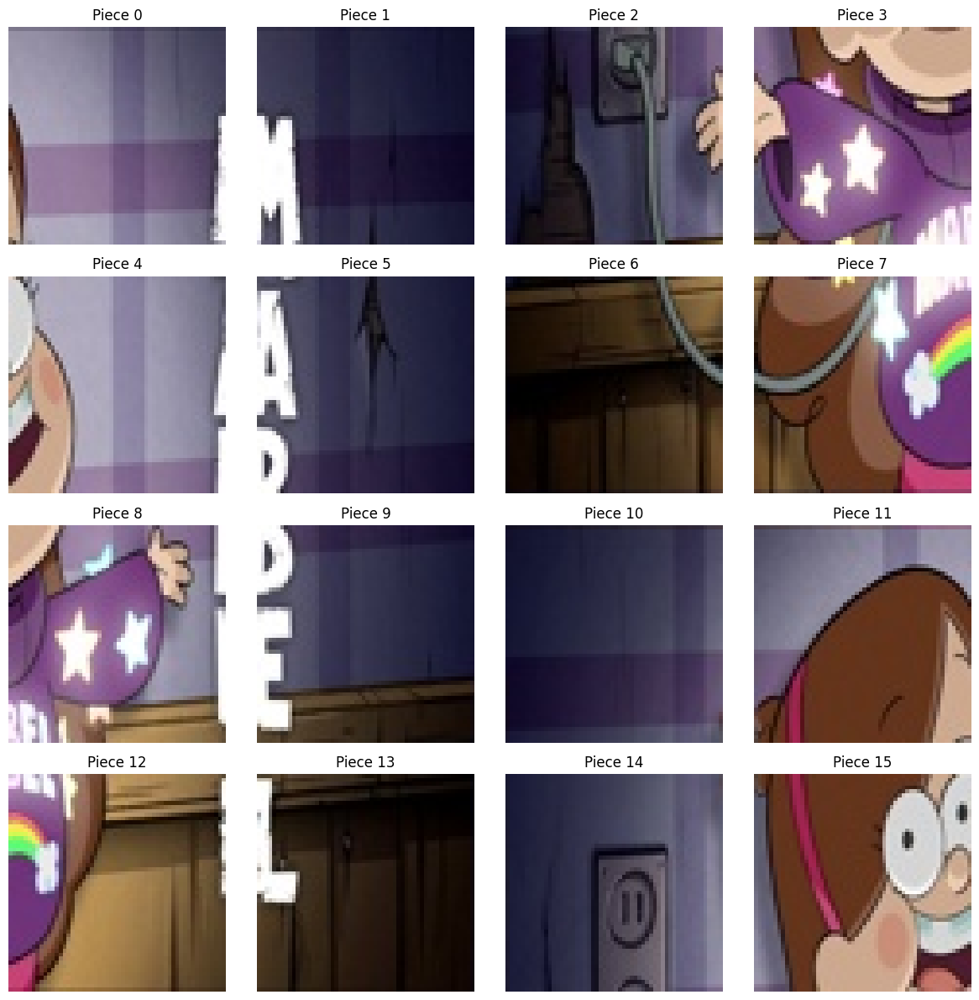

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_27


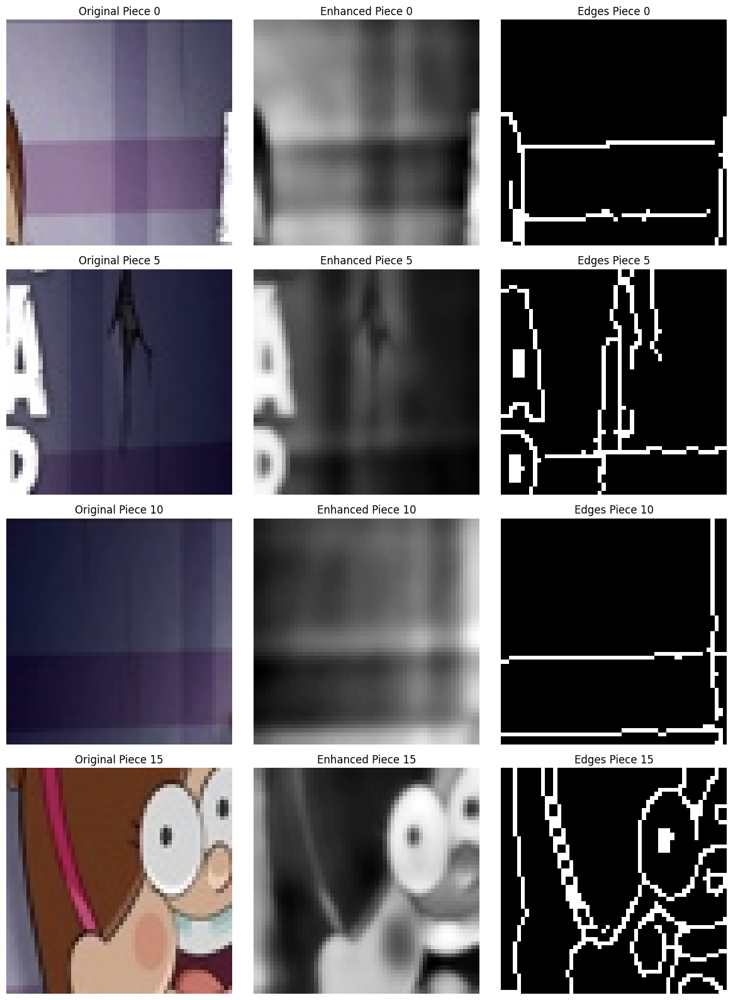

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_28
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_29
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_3
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_30
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_31
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_32
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_33
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_34
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_35
  Progress: 40/110 images processed
  Split into 4 pieces


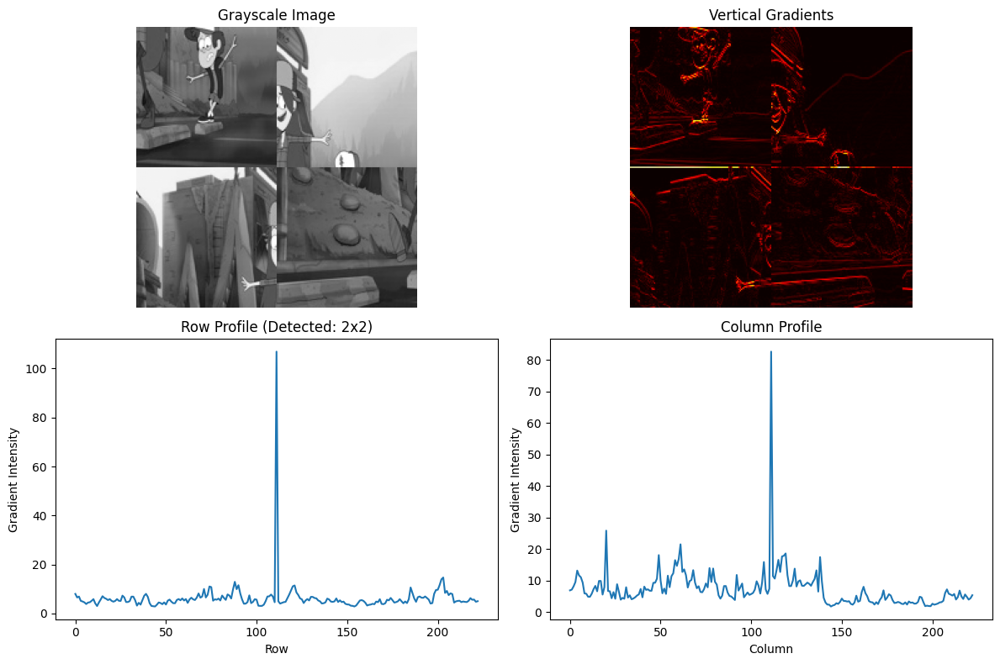

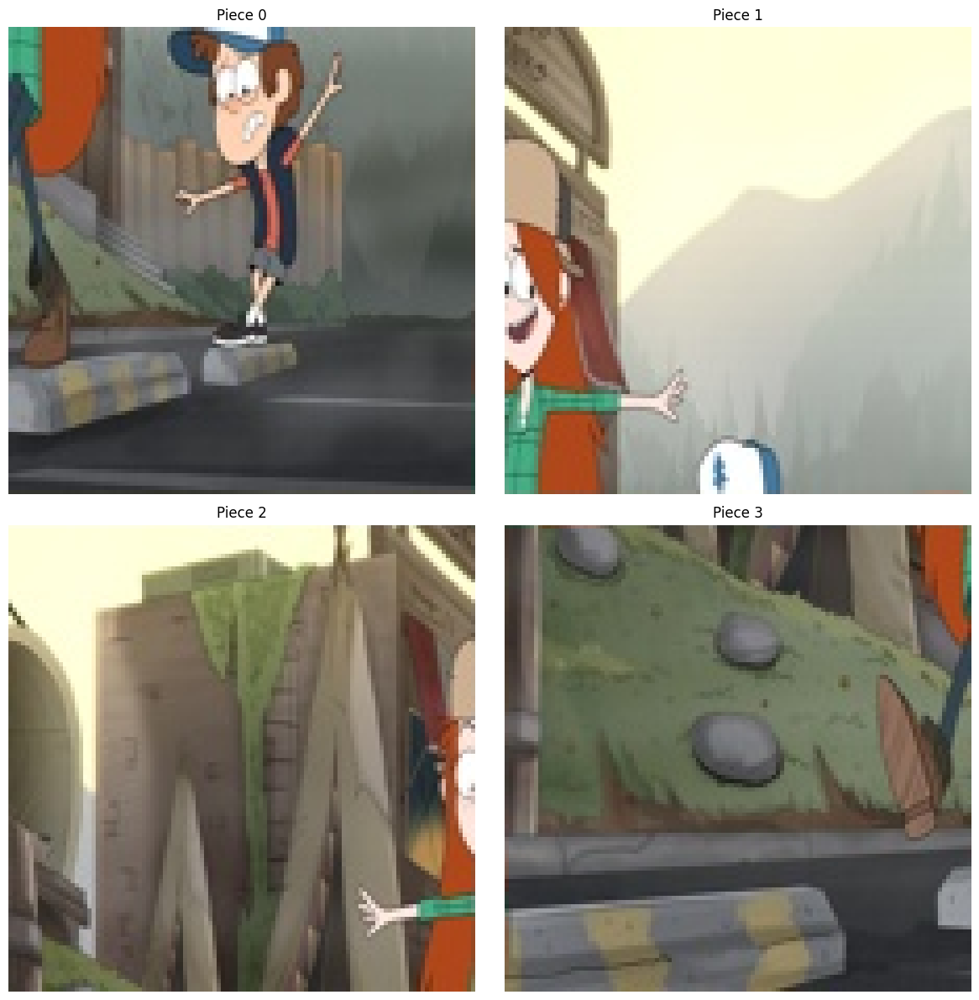

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_36


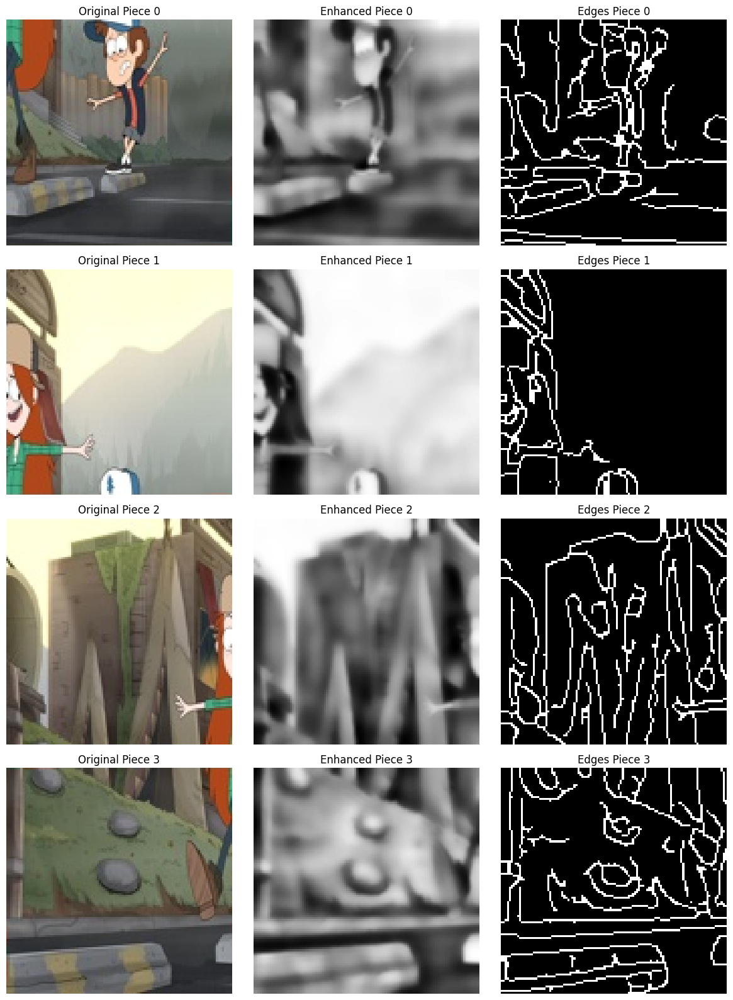

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_37
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_38
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_39
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_4
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_40
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_41
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_42
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_43
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_44
  Progress: 50/110 images processed
  Split into 4 pieces


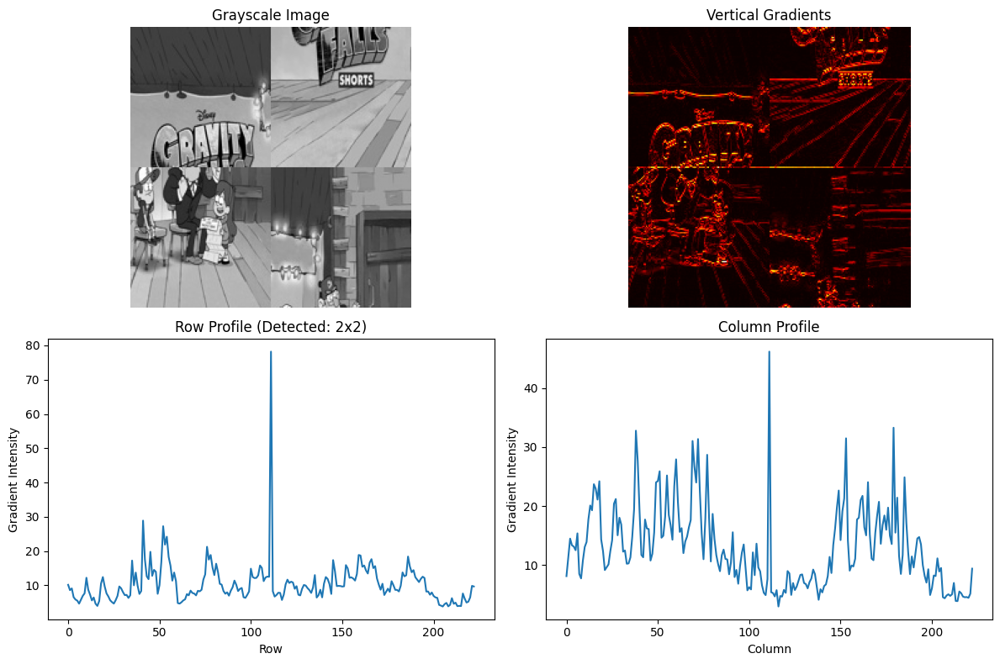

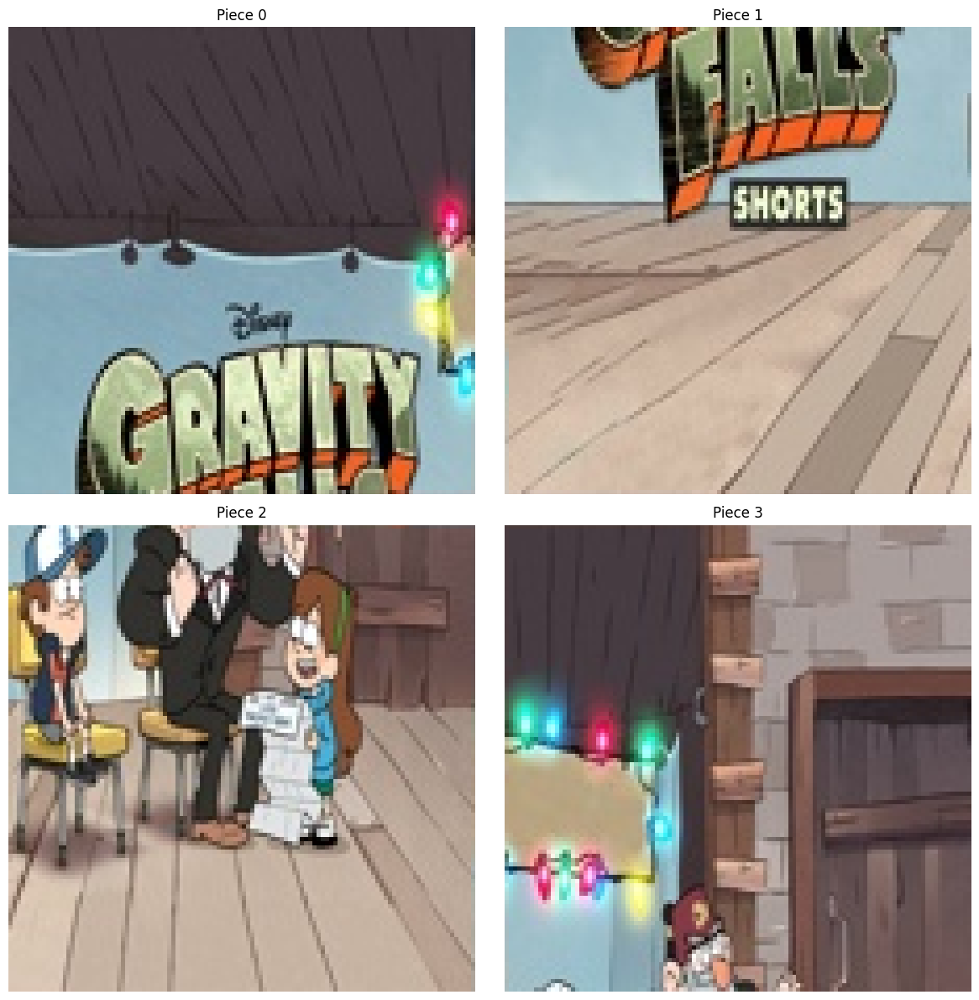

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_45


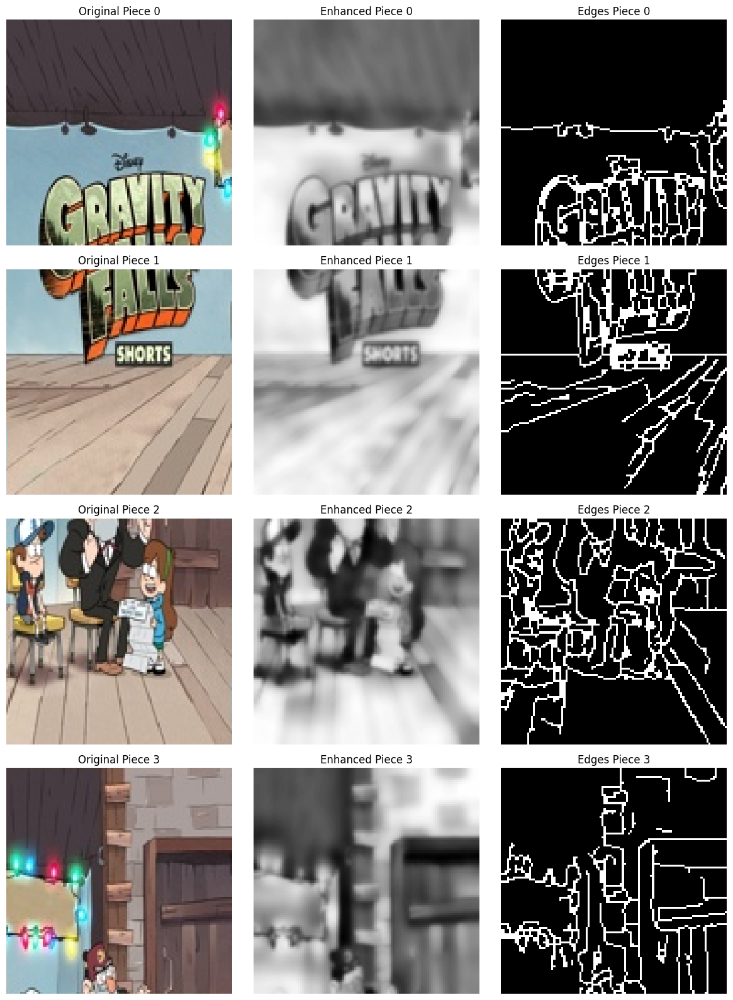

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_46
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_47
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_48
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_49
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_5
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_50
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_51
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_52
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_53
  Progress: 60/110 images processed
  Split into 4 pieces


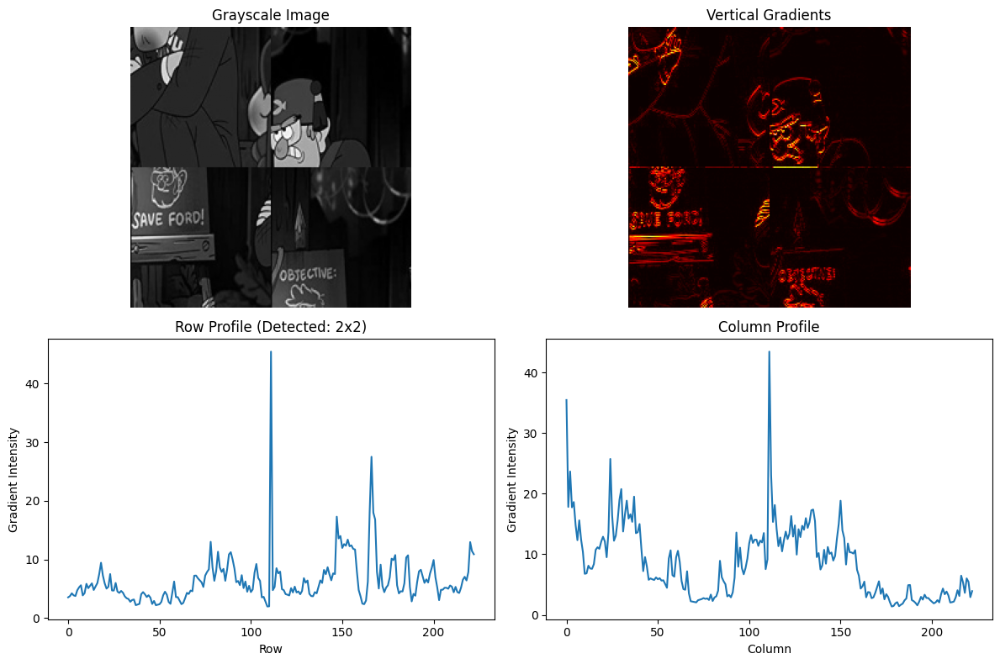

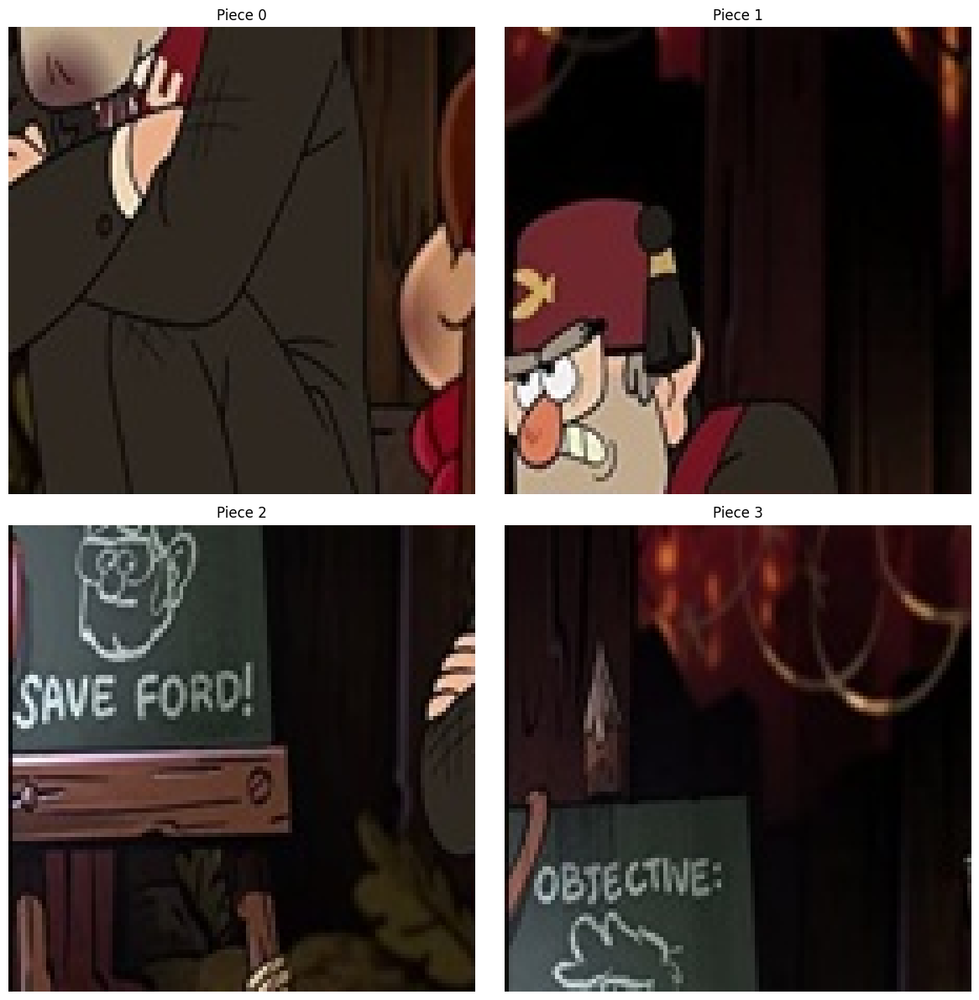

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_54


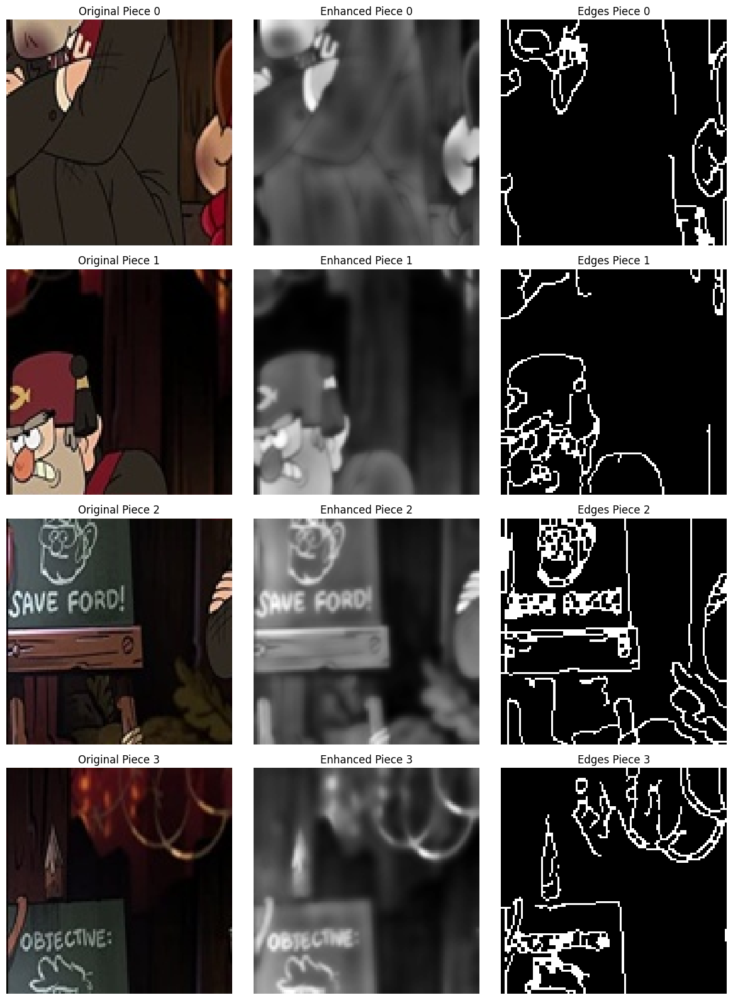

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_55
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_56
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_57
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_58
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_59
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_6
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_60
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_61
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_62
  Progress: 70/110 images processed
  Split into 4 pieces


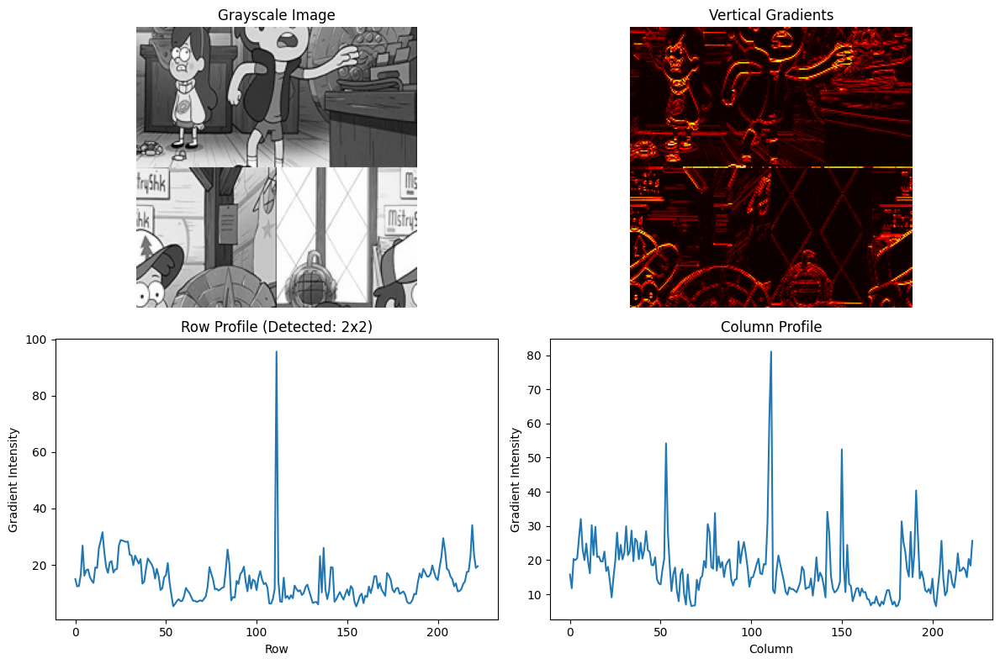

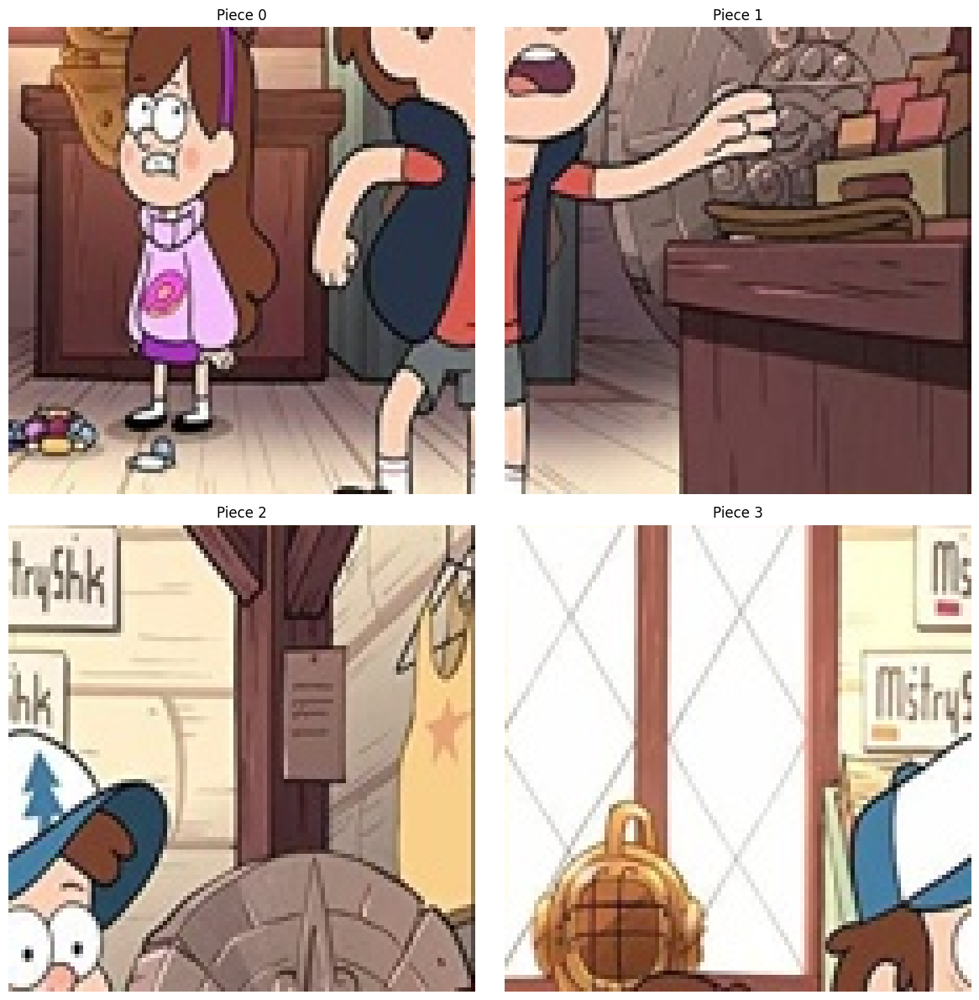

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_63


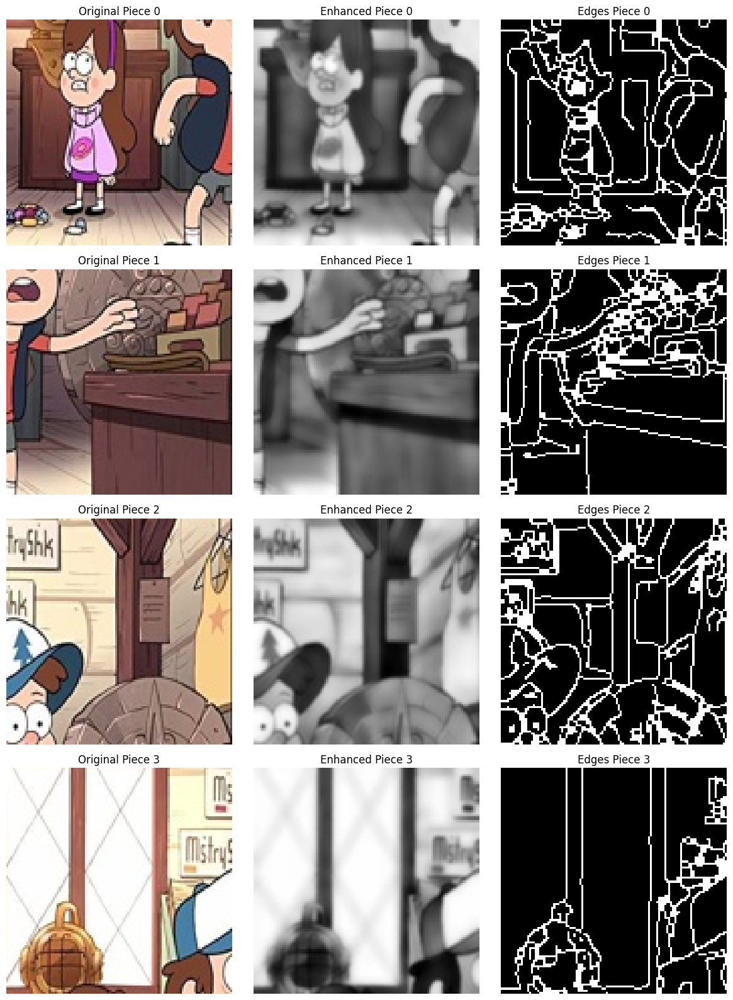

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_64
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_65
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_66
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_67
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_68
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_69
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_7
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_70
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_71
  Progress: 80/110 images processed
  Split into 4 pieces


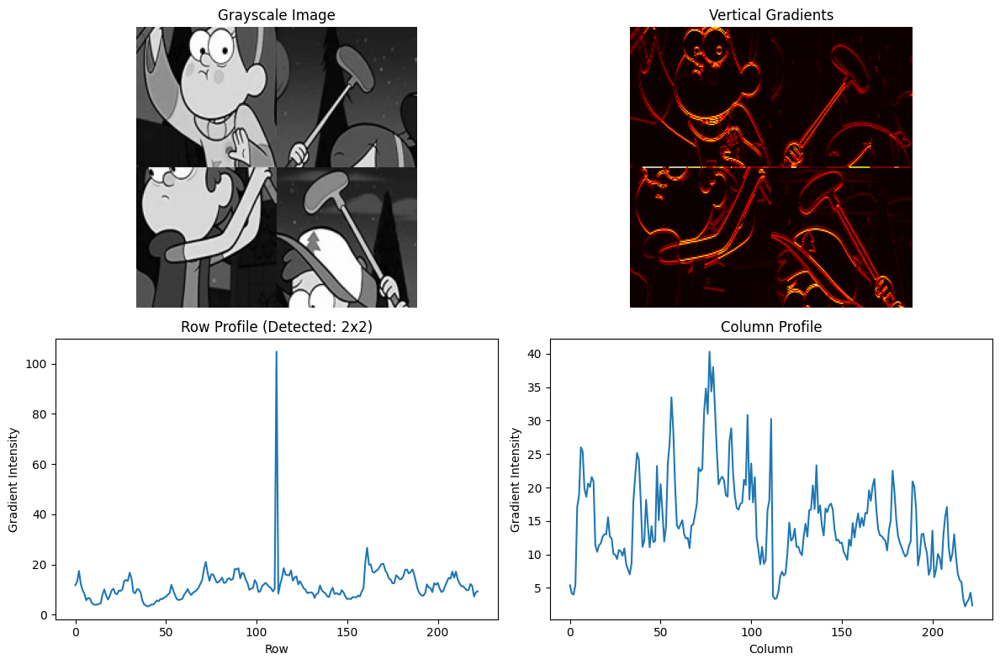

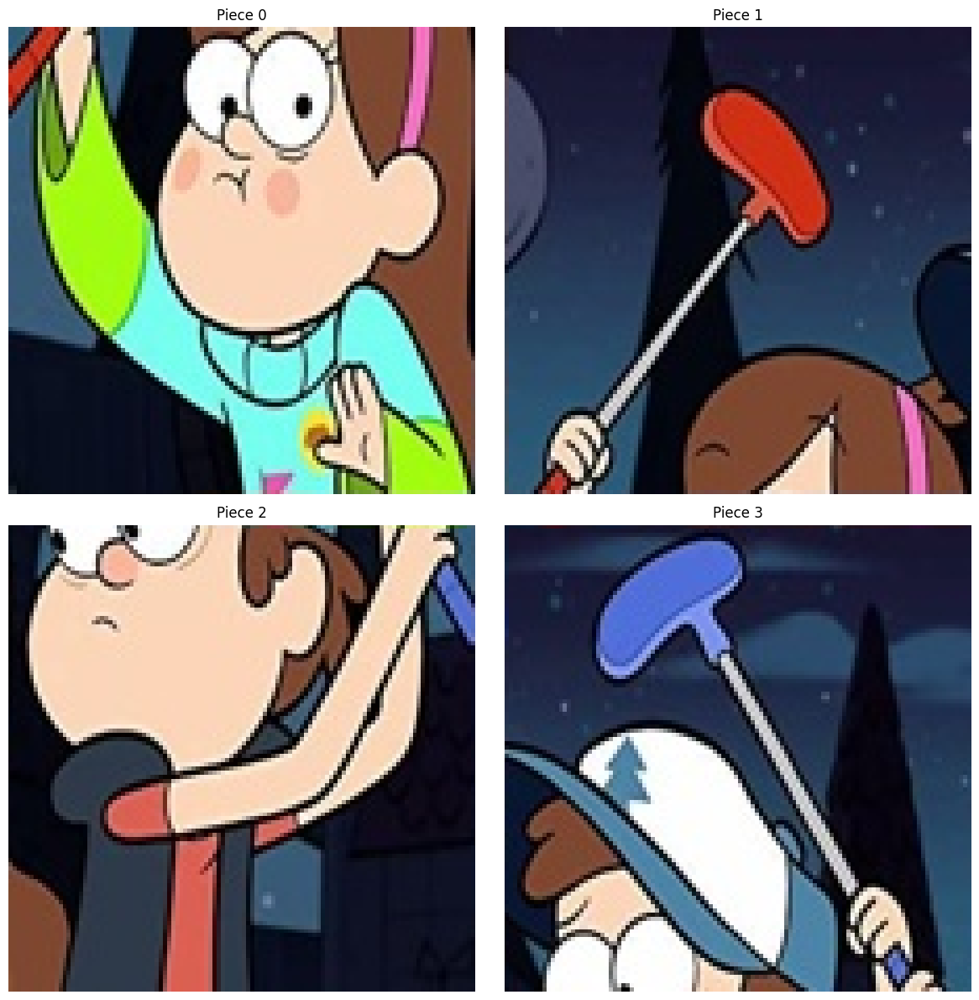

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_72


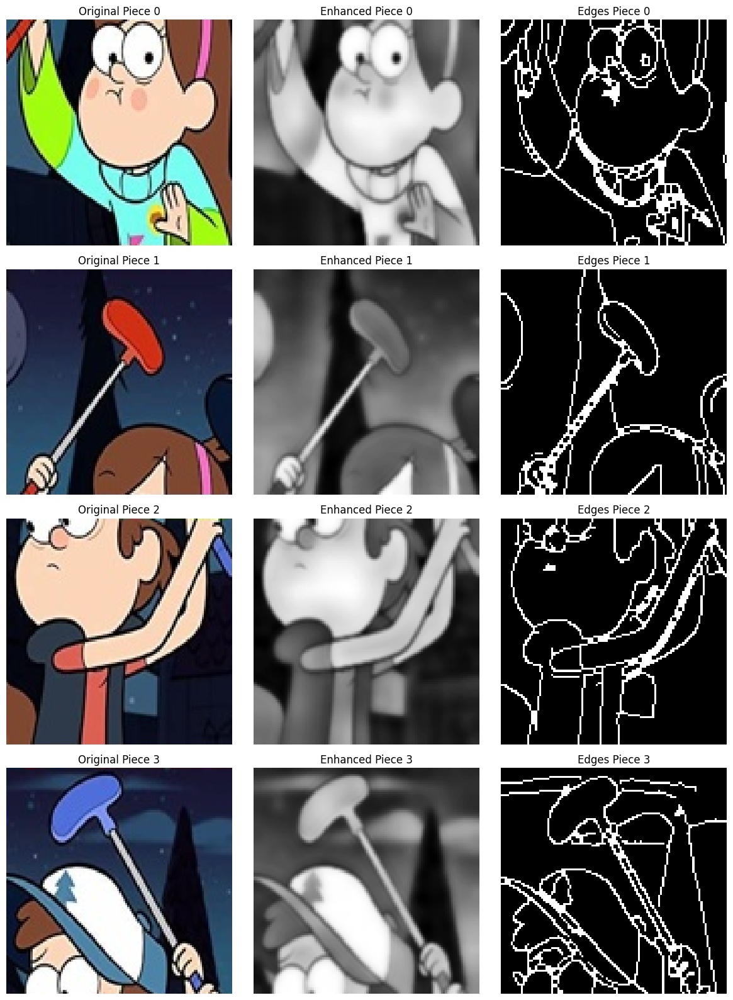

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_73
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_74
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_75
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_76
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_77
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_78
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_79
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_8
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_80
  Progress: 90/110 images processed
  Split into 4 pieces


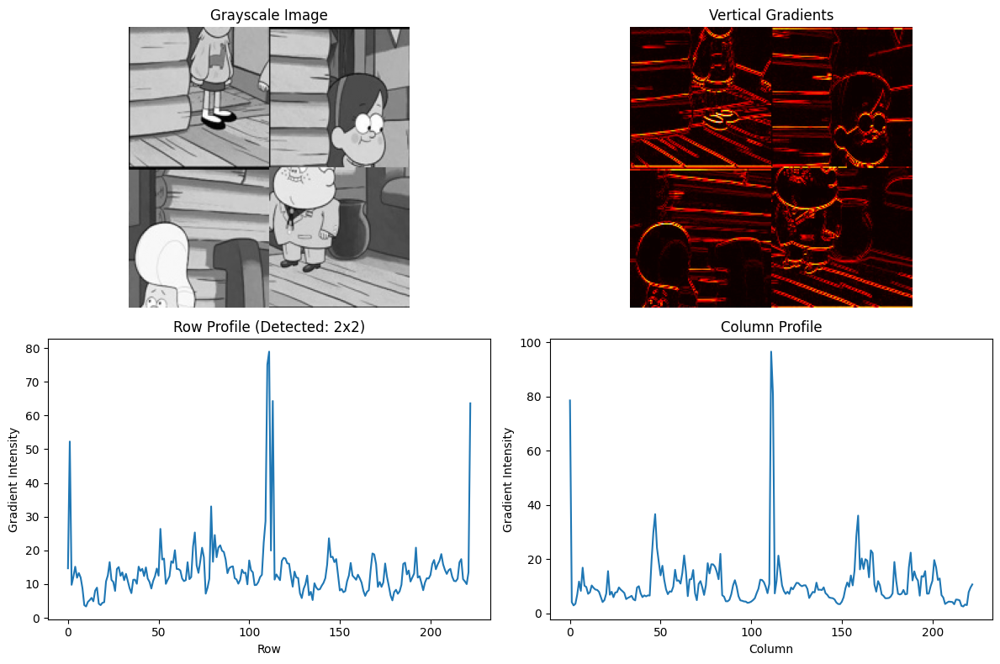

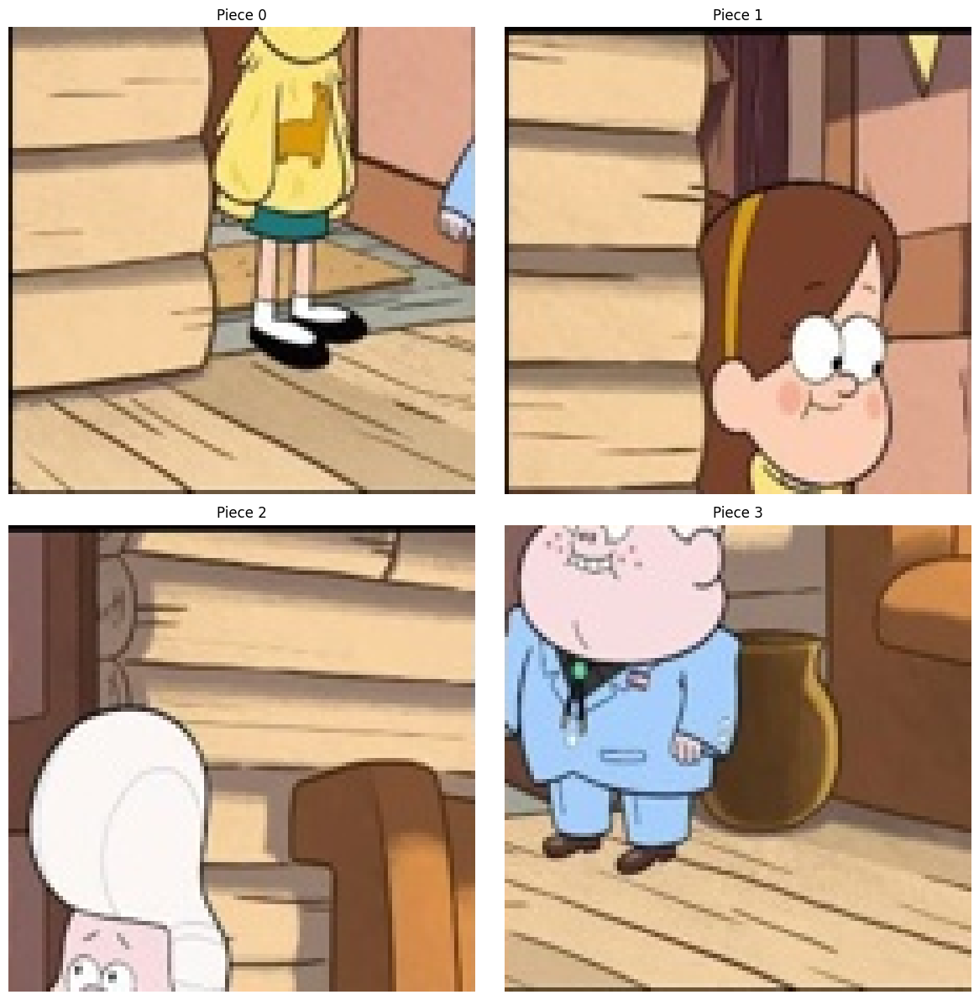

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_81


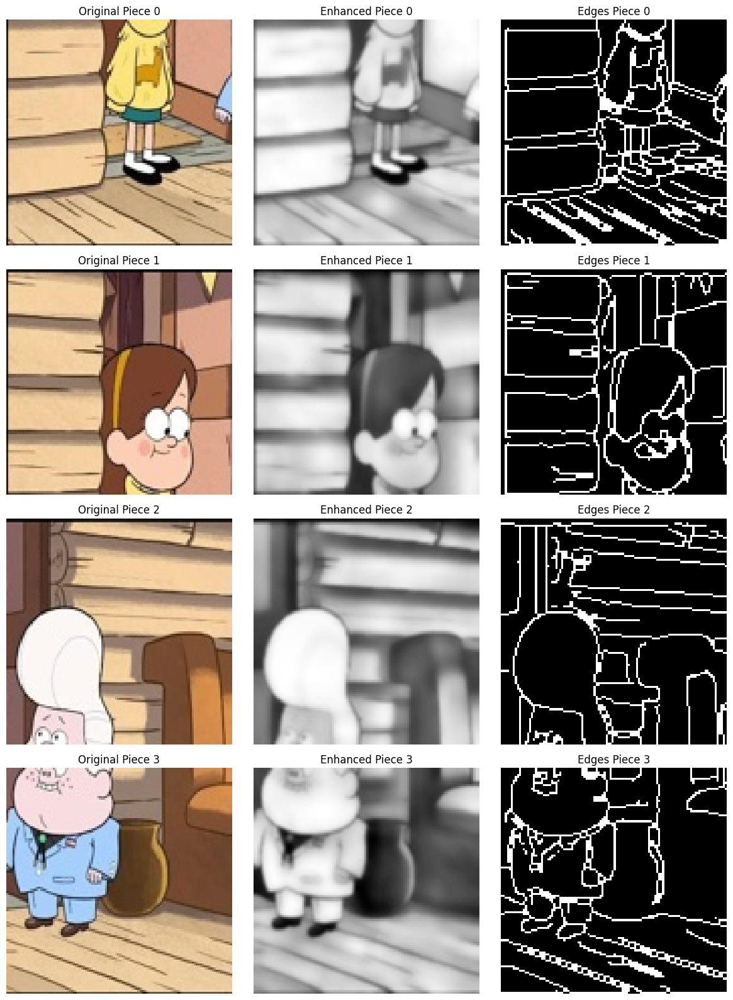

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_82
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_83
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_84
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_85
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_86
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_87
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_88
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_89
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_9
  Progress: 100/110 images processed
  Split into 4 pieces


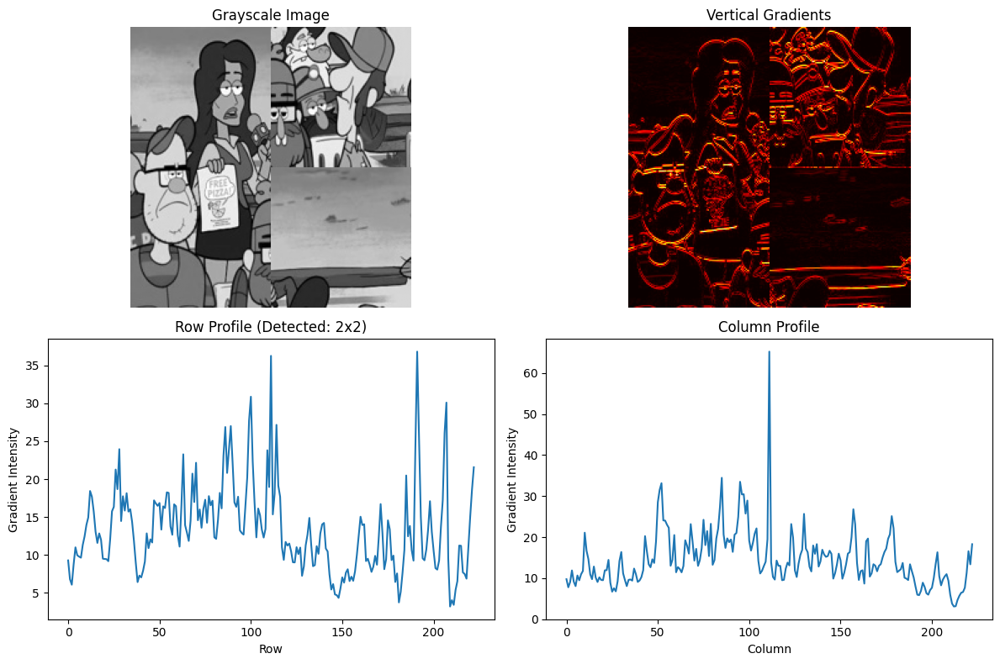

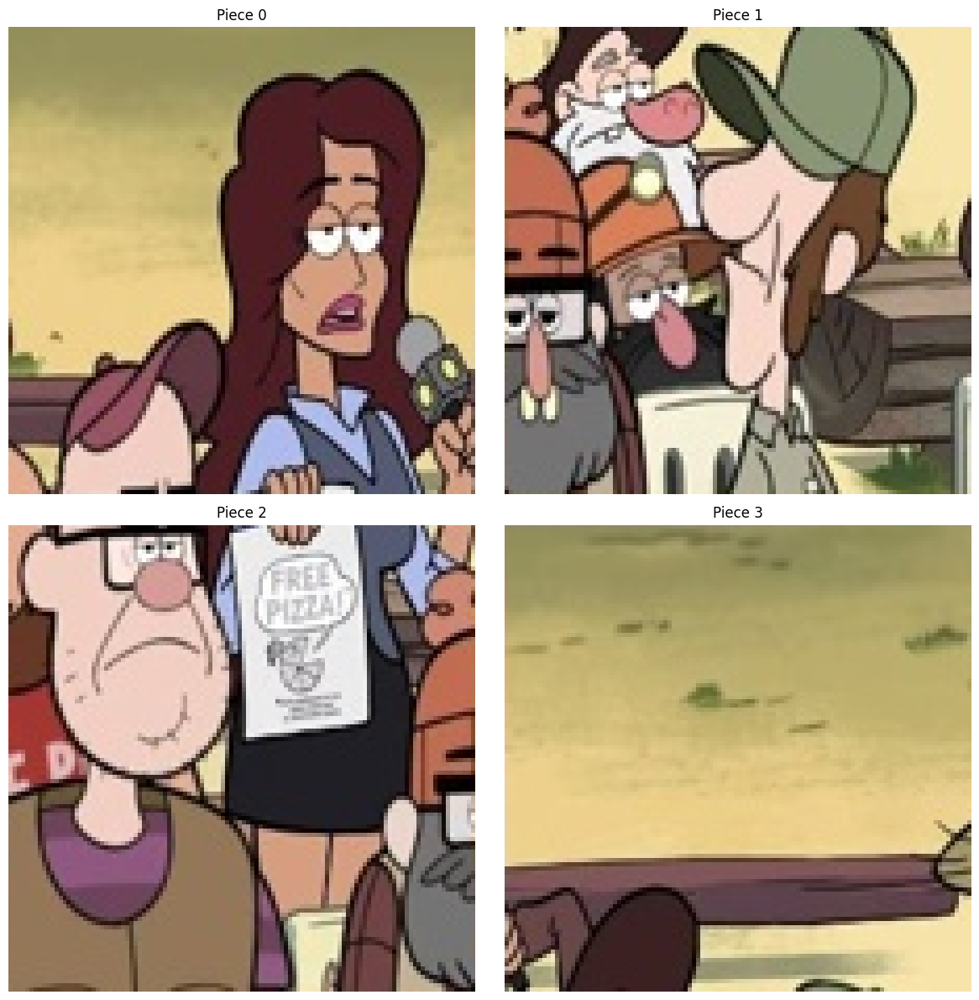

  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_90


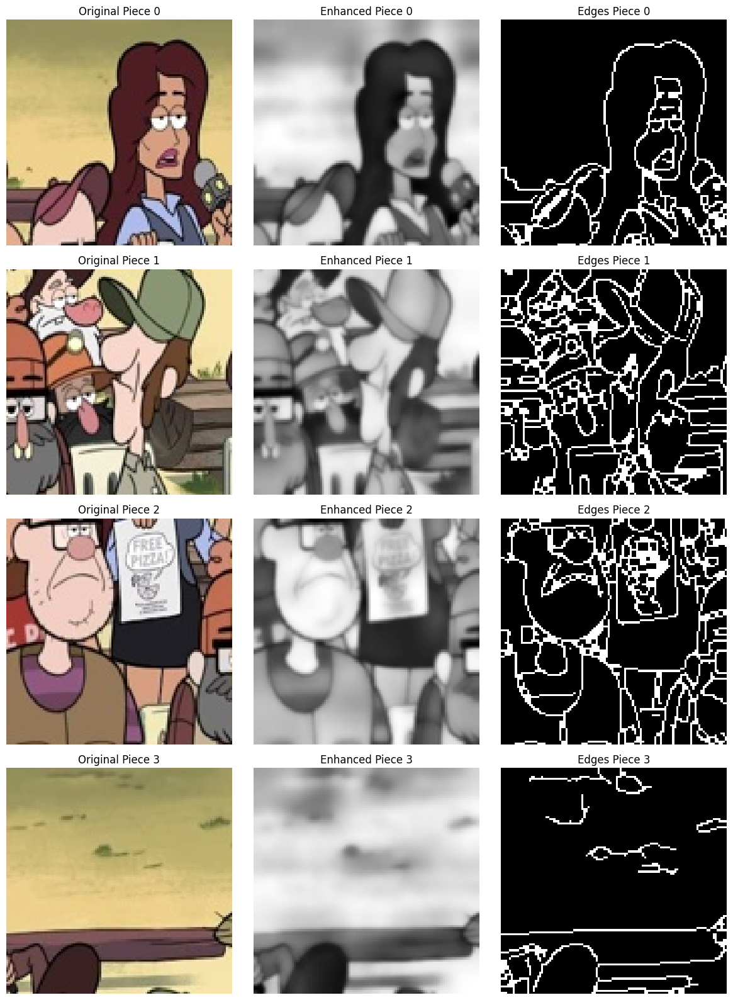

  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_91
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_92
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_93
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_94
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_95
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_96
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_97
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_98
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_2x2\image_99
  Progress: 110/110 images processed

Processing puzzle_4x4: 110 images
  Split into 16 pieces


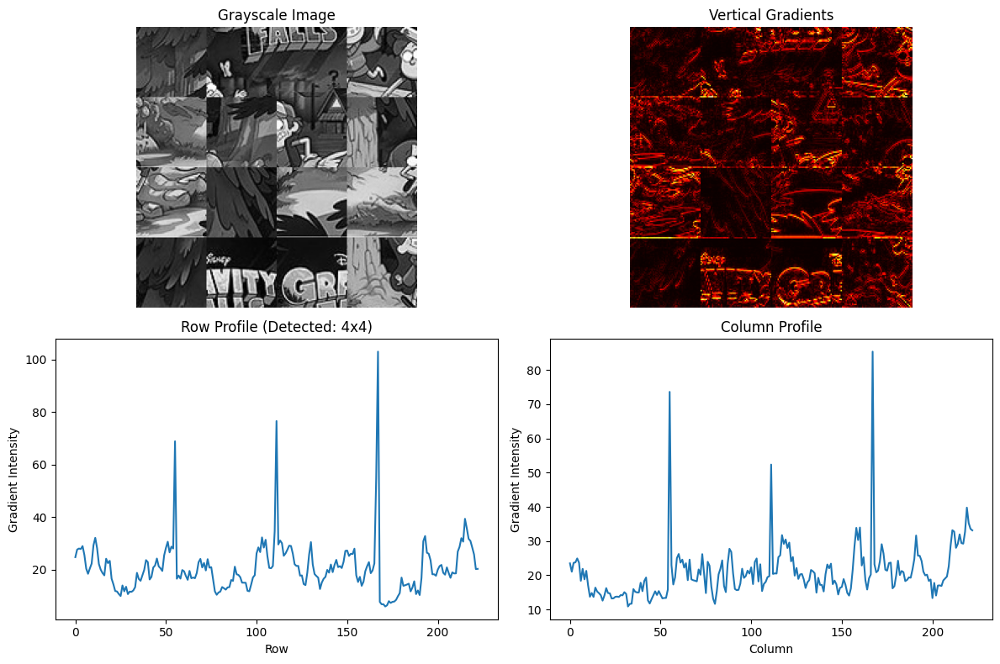

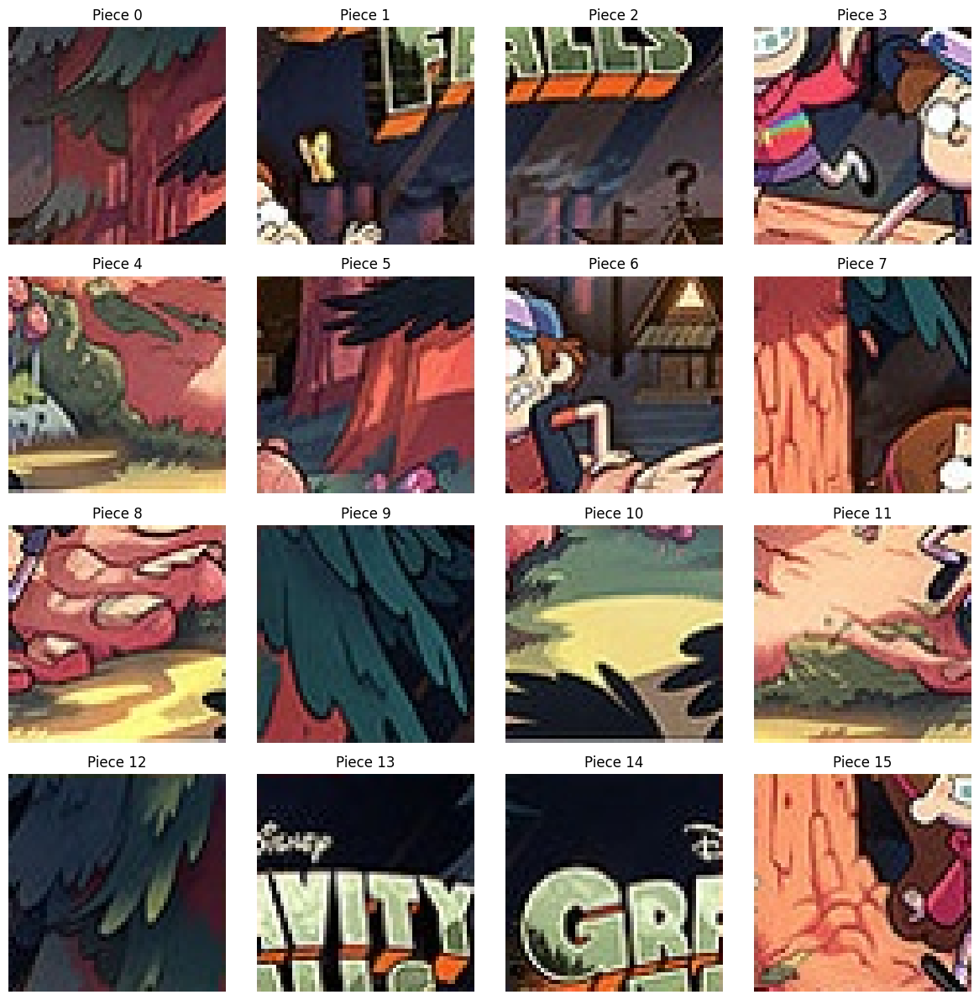

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_0


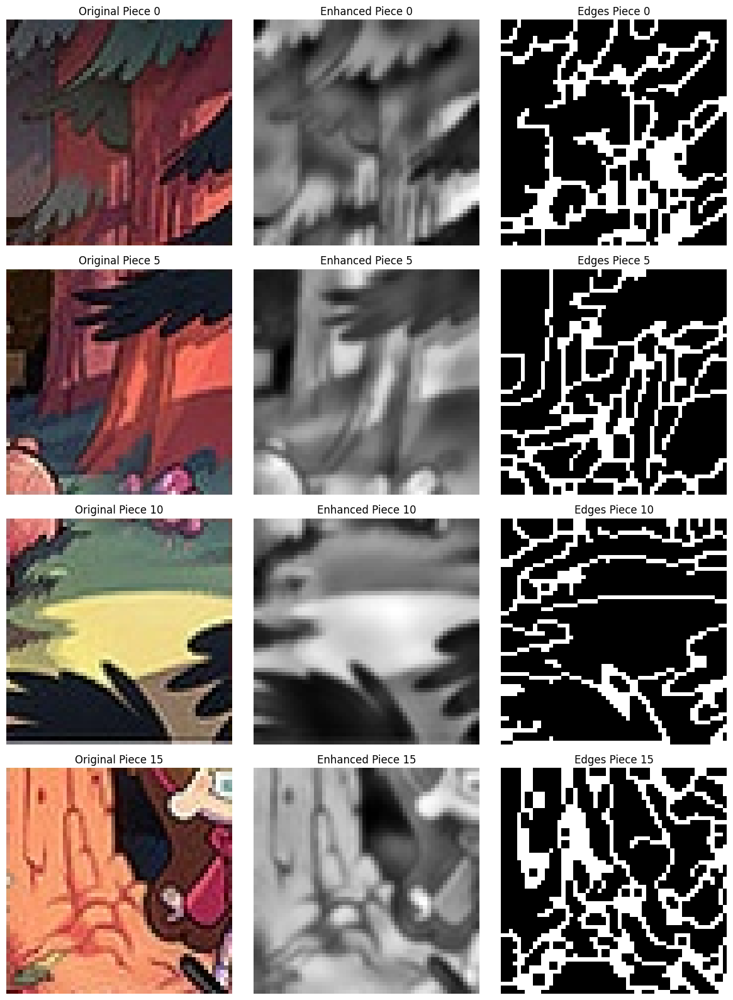

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_1
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_10
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_100
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_101
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_102
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_103
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_104
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_105
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_106
  Progress: 10/110 images processed
  Split into 16 pieces


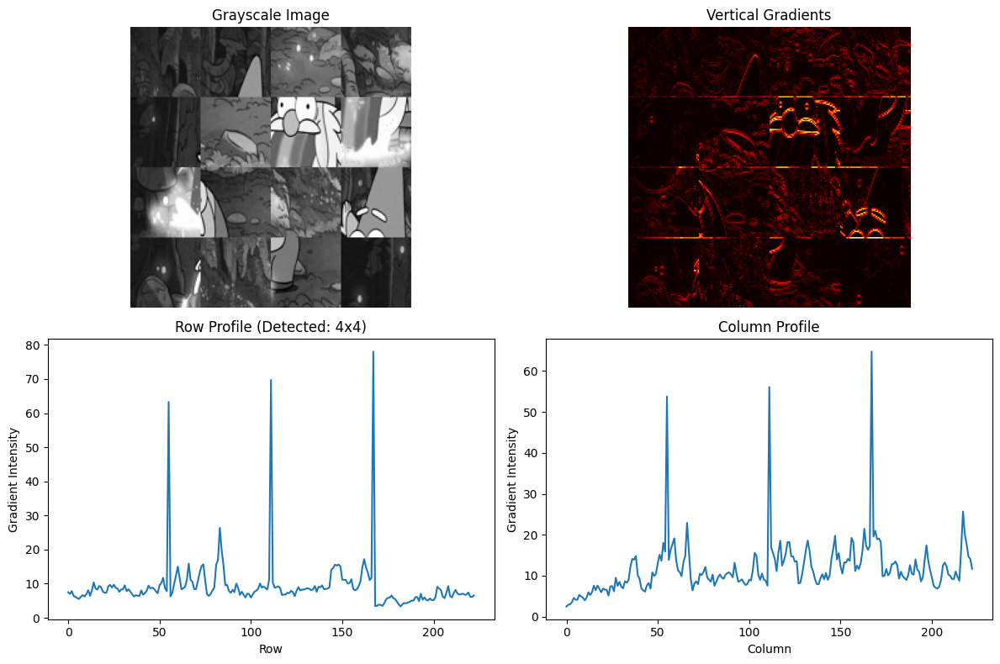

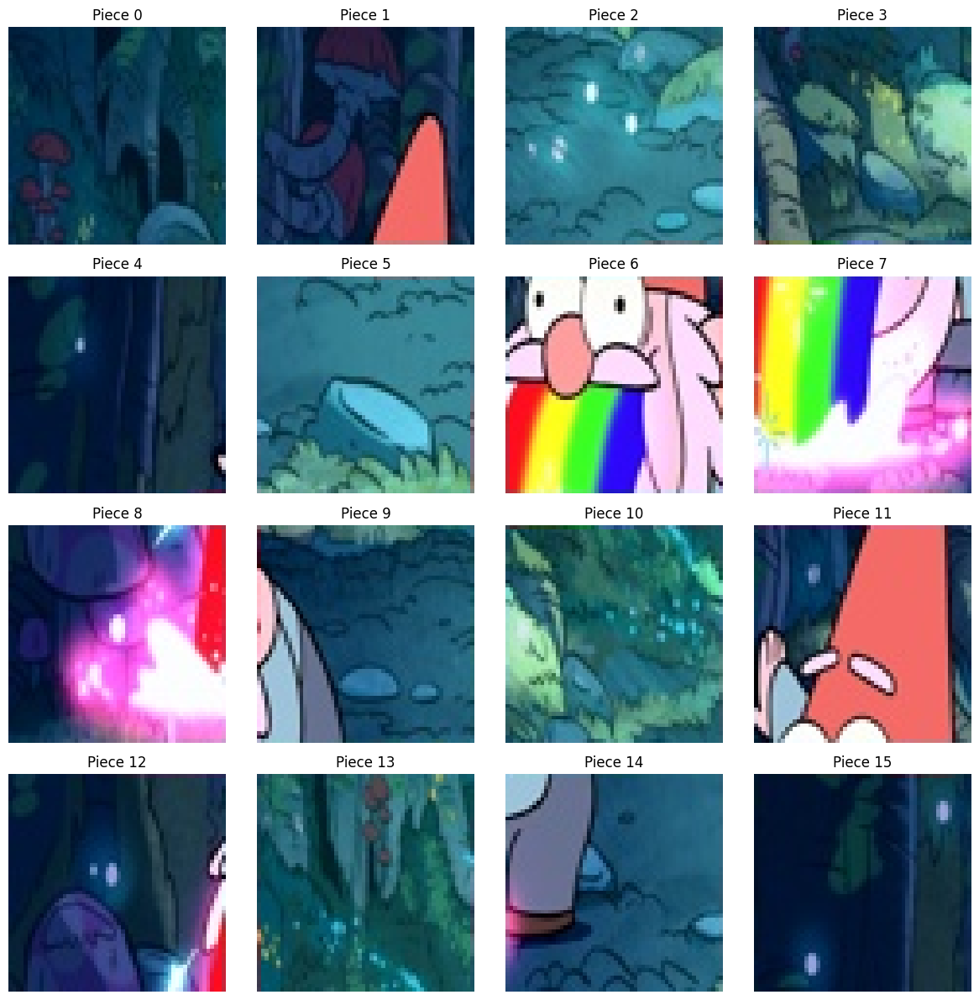

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_107


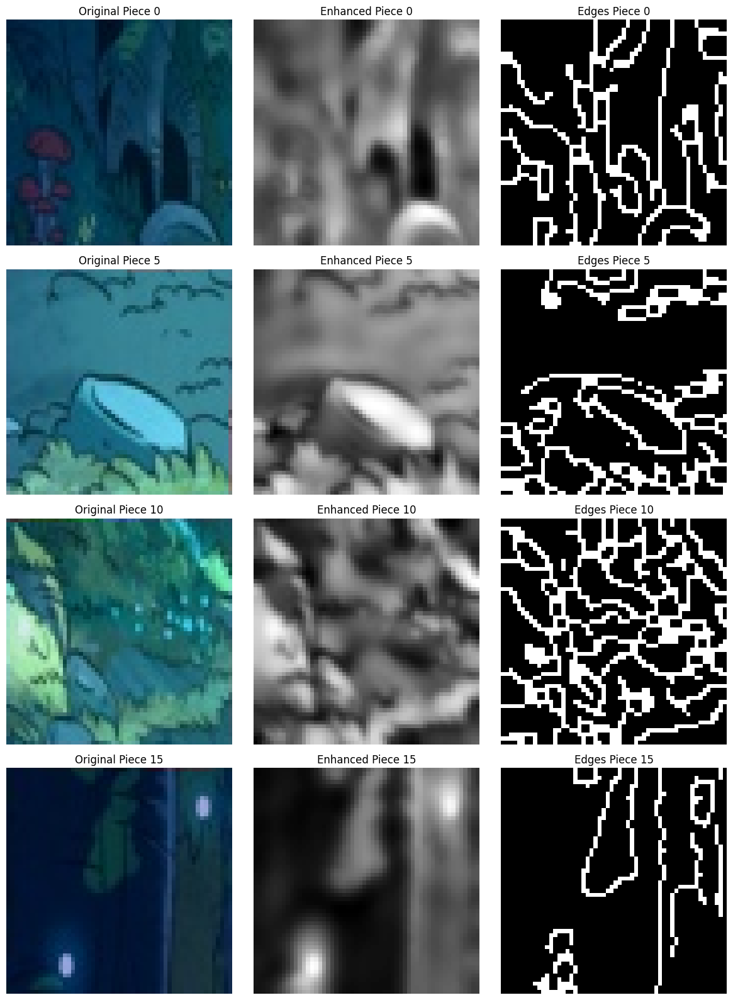

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_108
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_109
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_11
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_12
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_13
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_14
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_15
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_16
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_17
  Progress: 20/110 images processed
  Split into 16 pieces


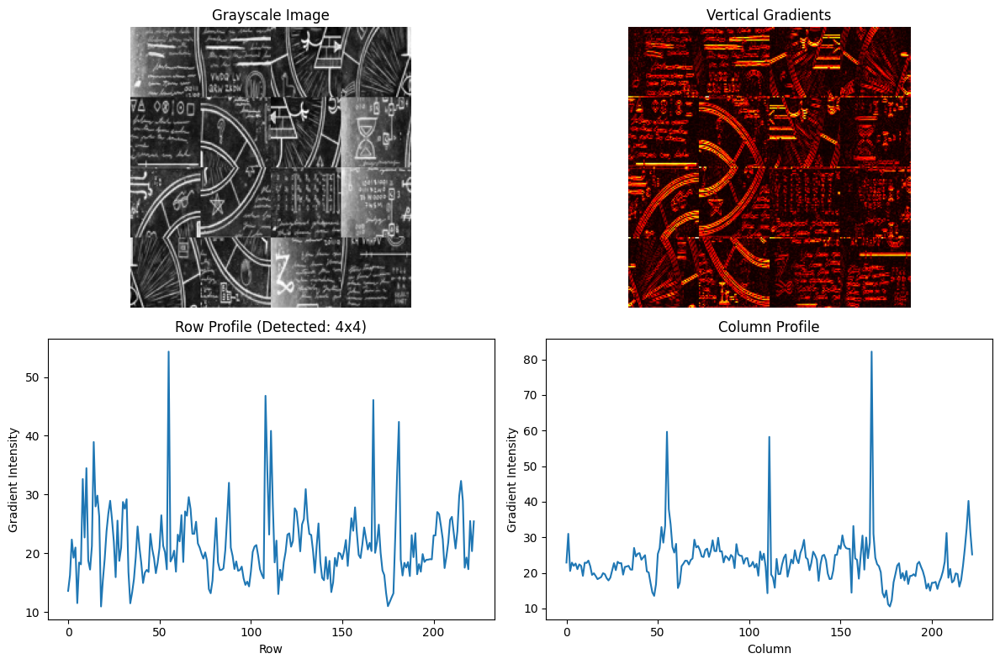

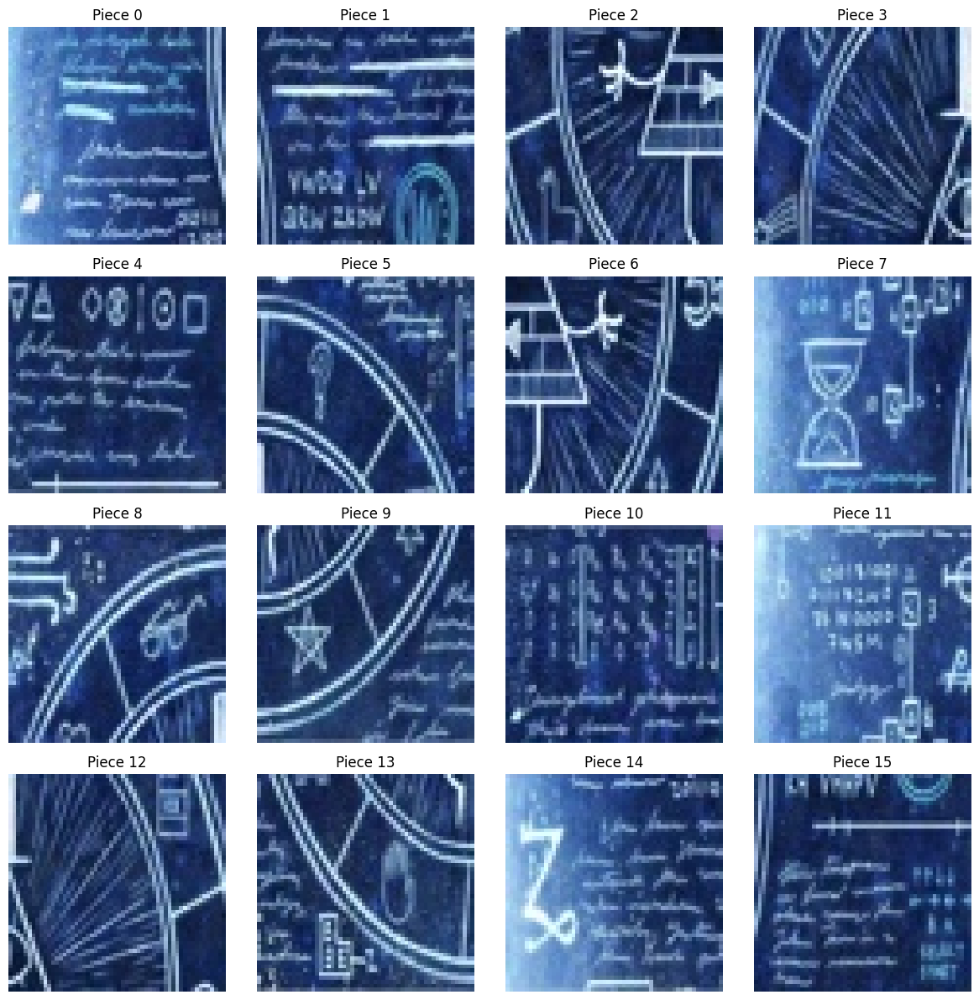

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_18


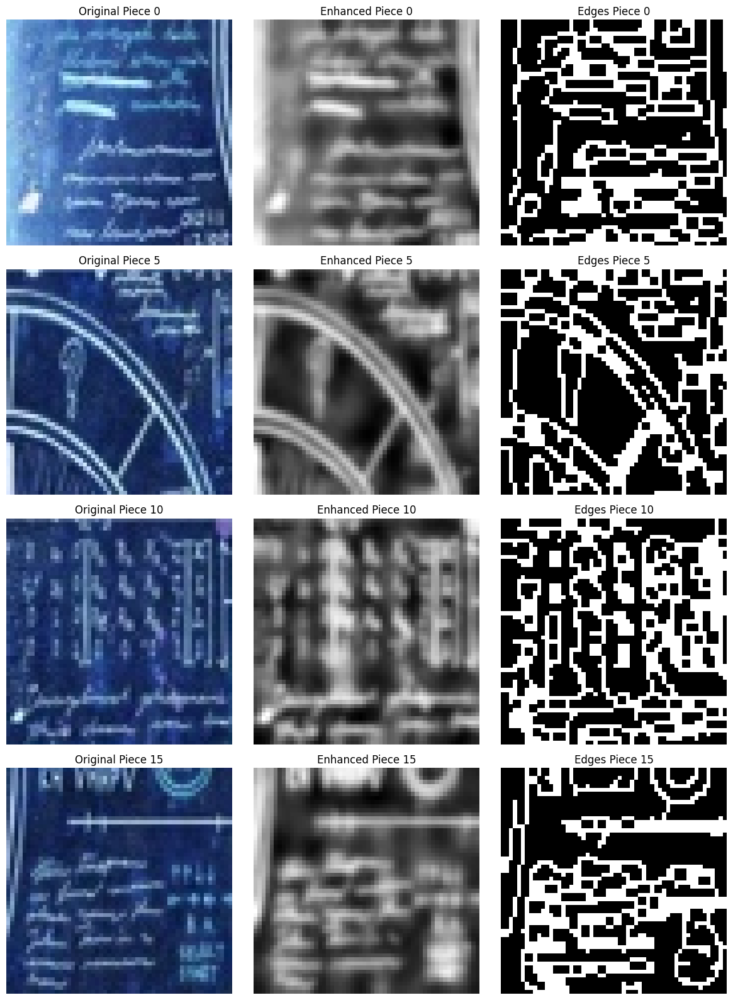

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_19
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_2
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_20
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_21
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_22
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_23
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_24
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_25
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_26
  Progress: 30/110 images processed
  Split into 16 pieces


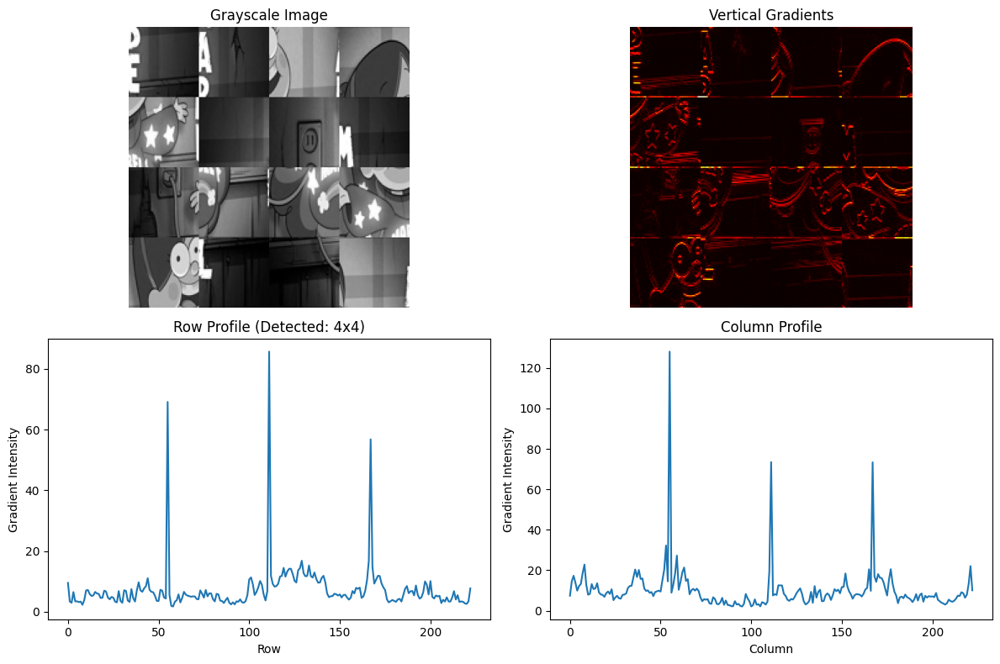

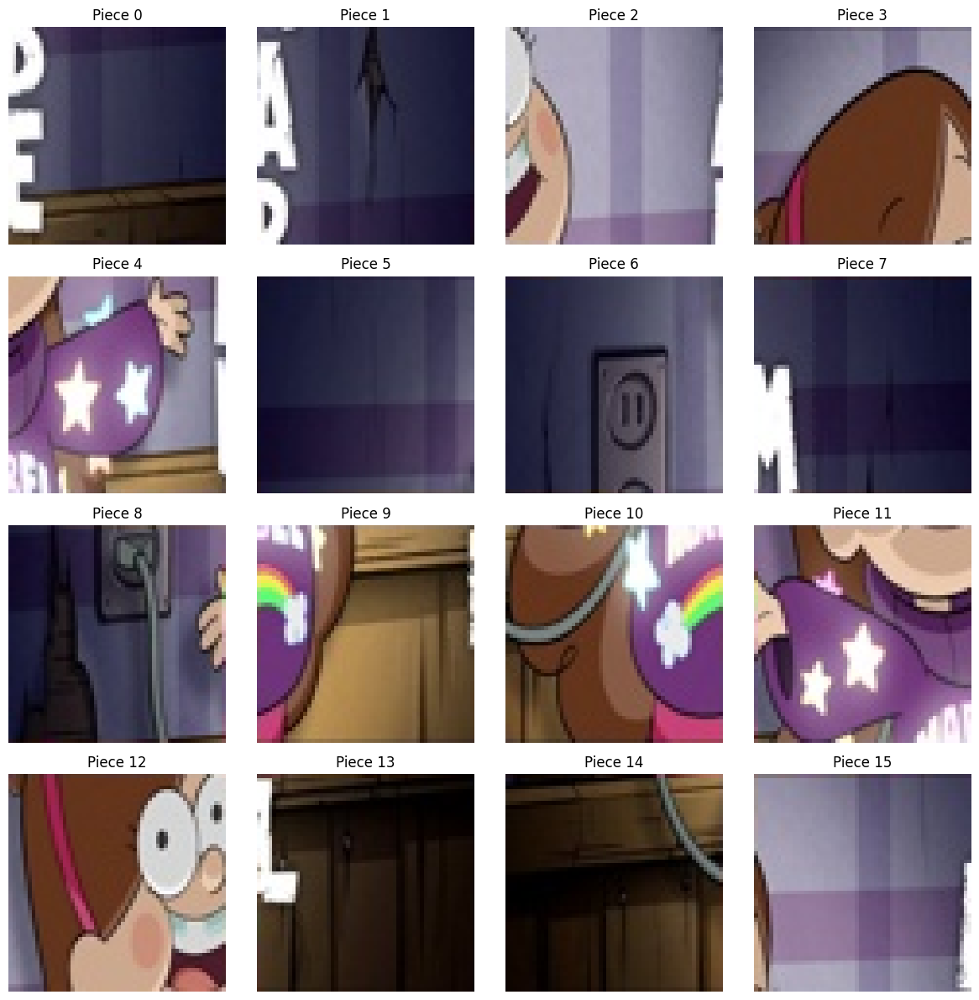

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_27


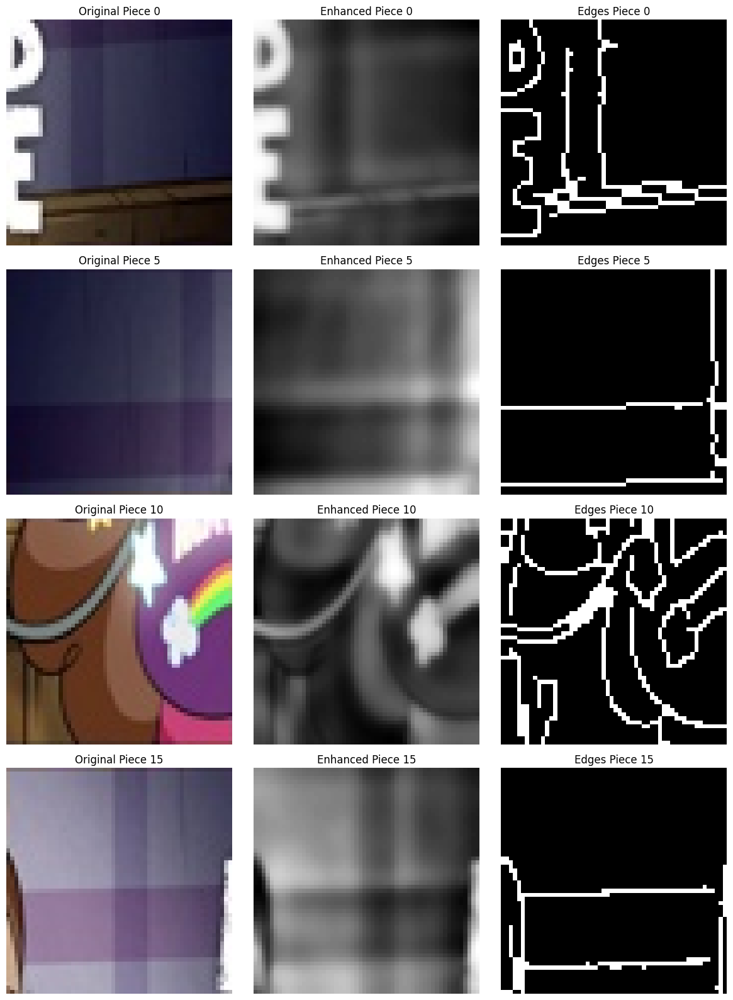

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_28
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_29
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_3
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_30
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_31
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_32
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_33
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_34
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_35
  Progress: 40/110 images processed
  Split into 16 pieces


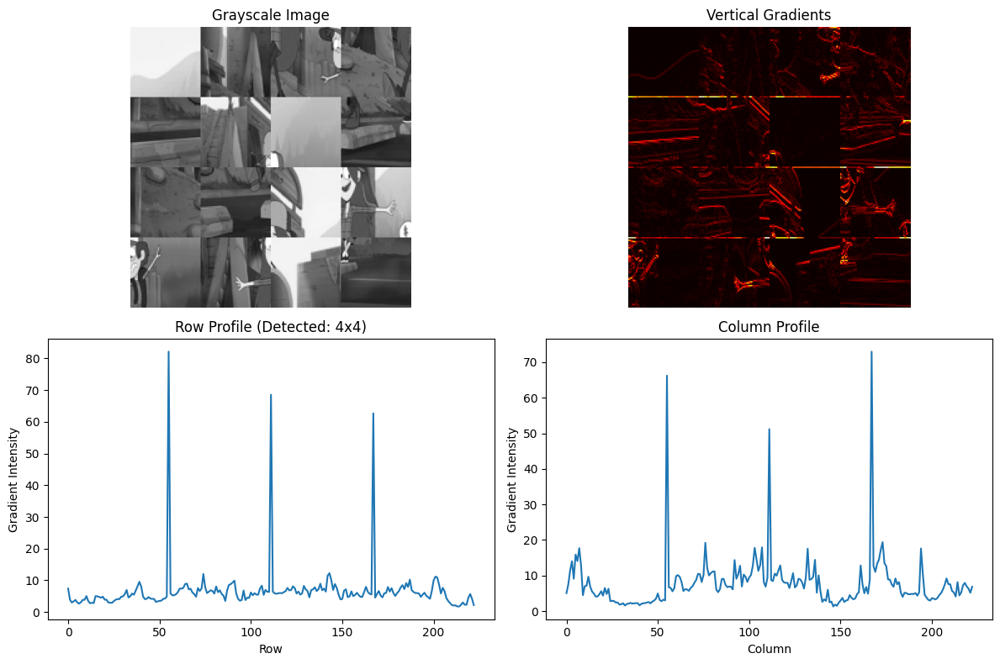

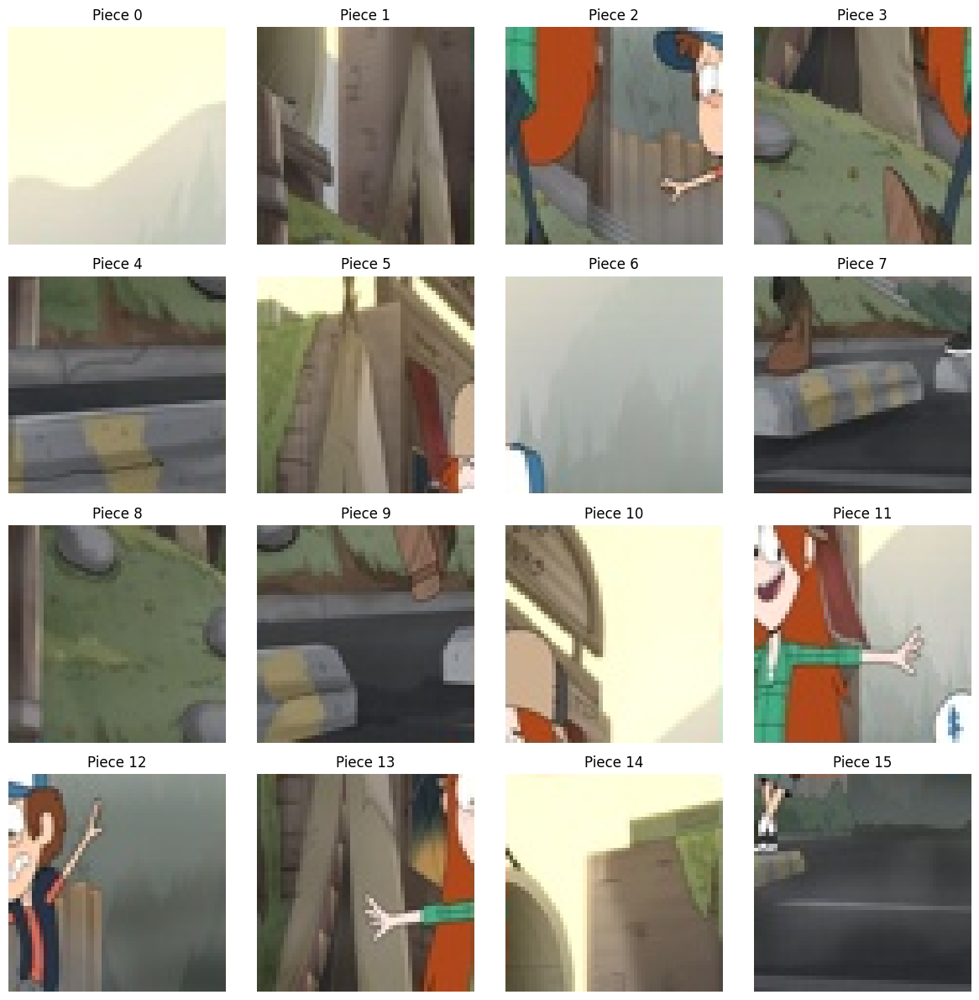

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_36


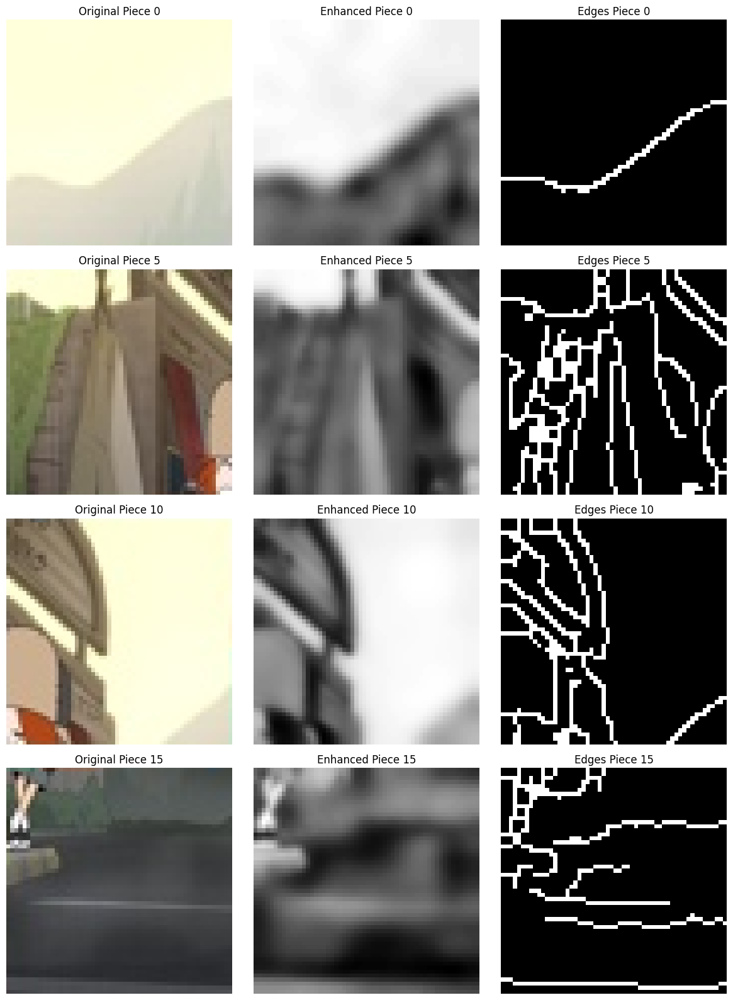

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_37
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_38
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_39
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_4
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_40
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_41
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_42
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_43
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_44
  Progress: 50/110 images processed
  Split into 16 pieces


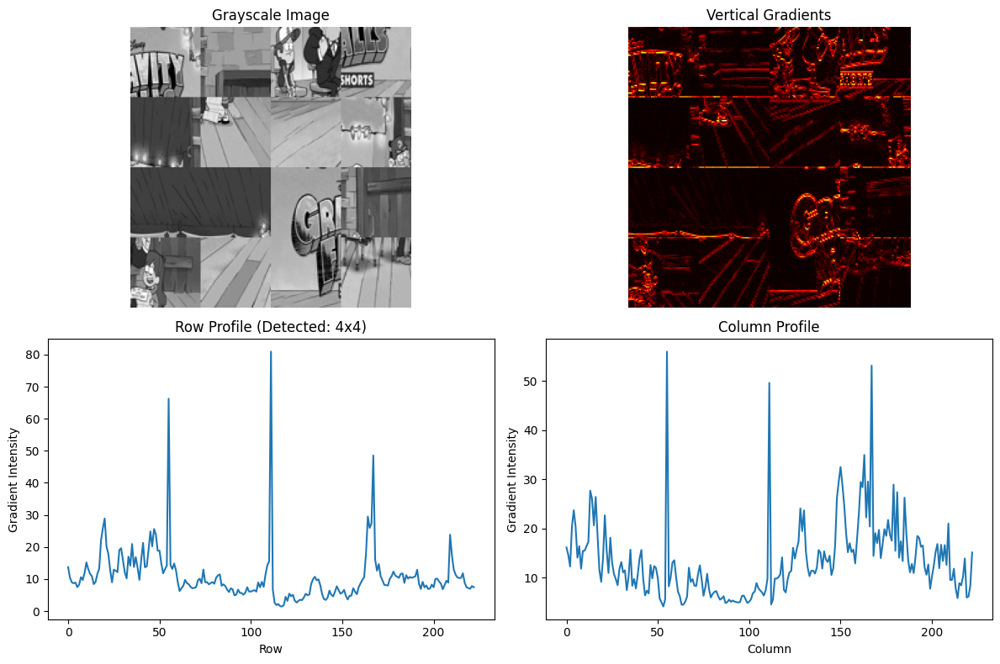

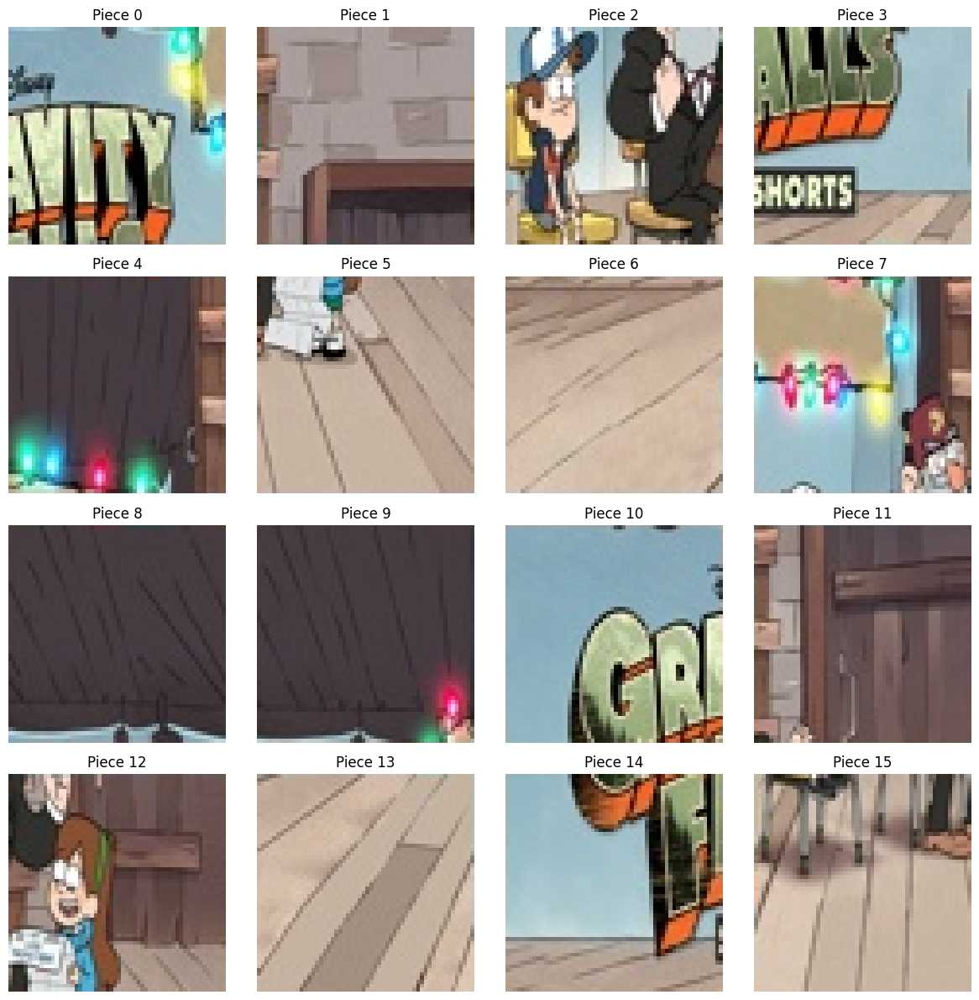

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_45


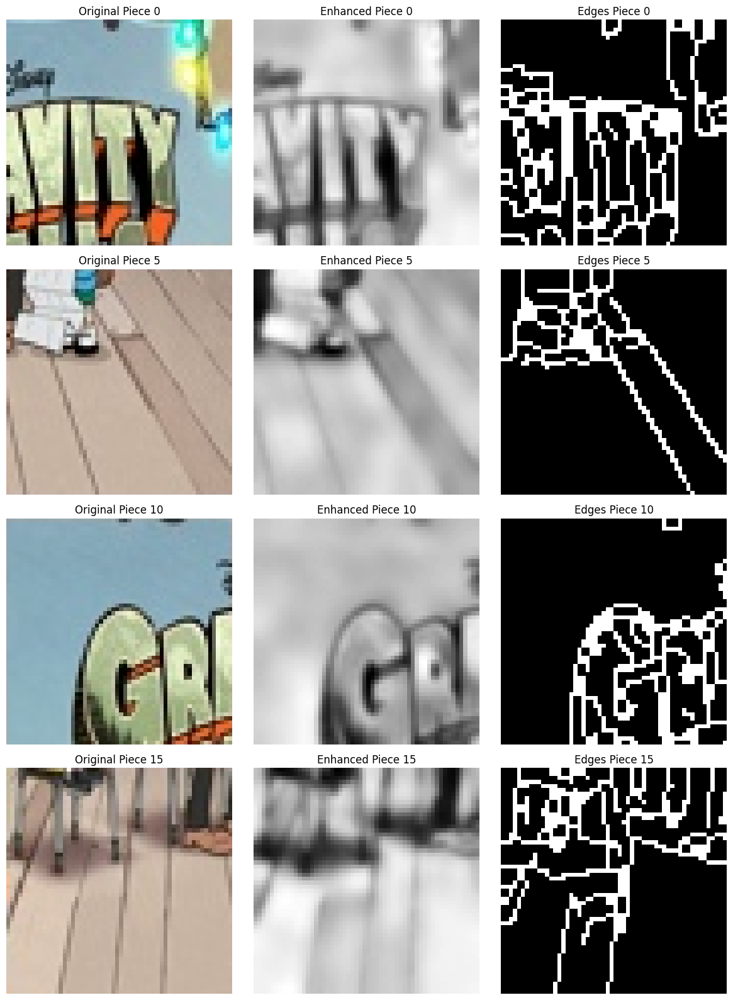

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_46
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_47
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_48
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_49
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_5
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_50
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_51
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_52
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_53
  Progress: 60/110 images processed
  Split into 16 pieces


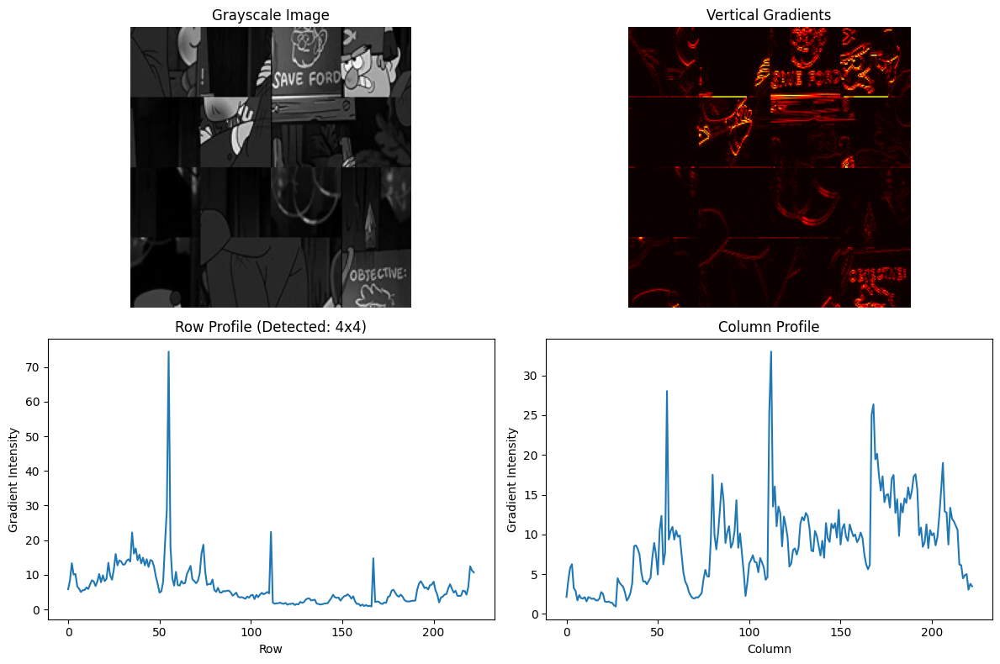

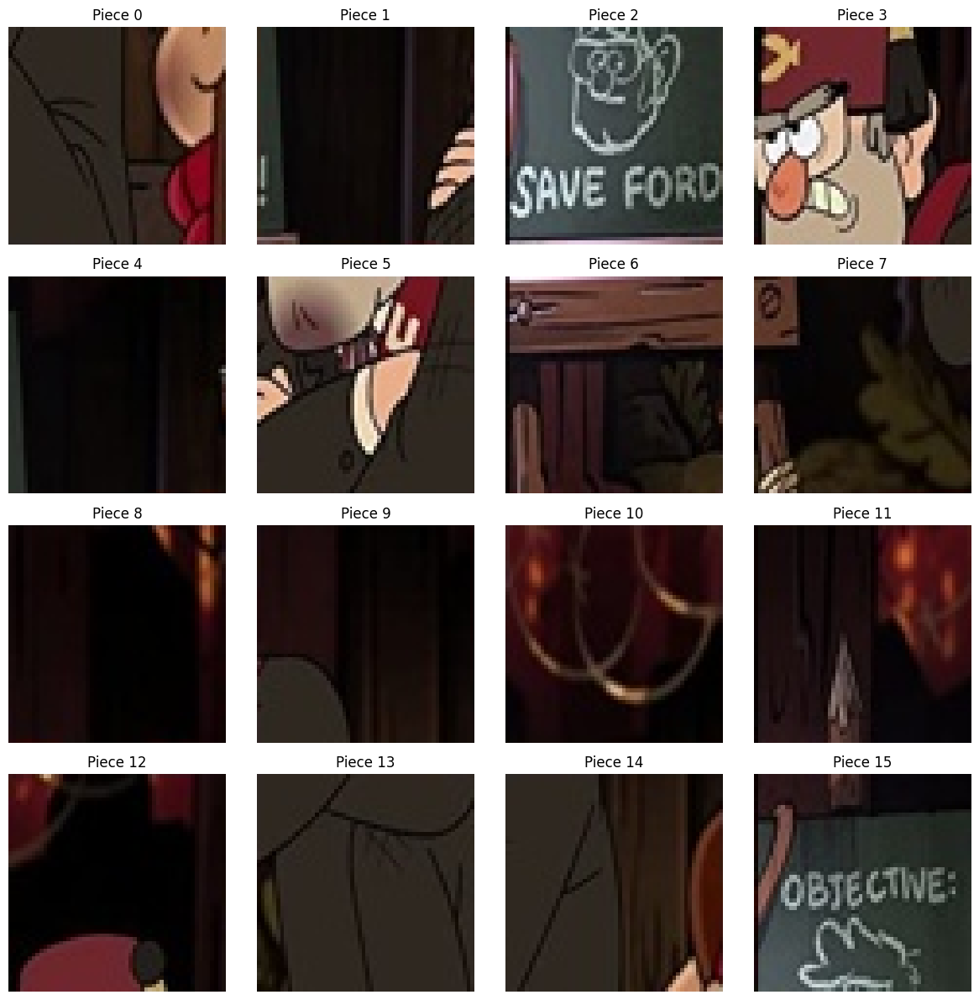

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_54


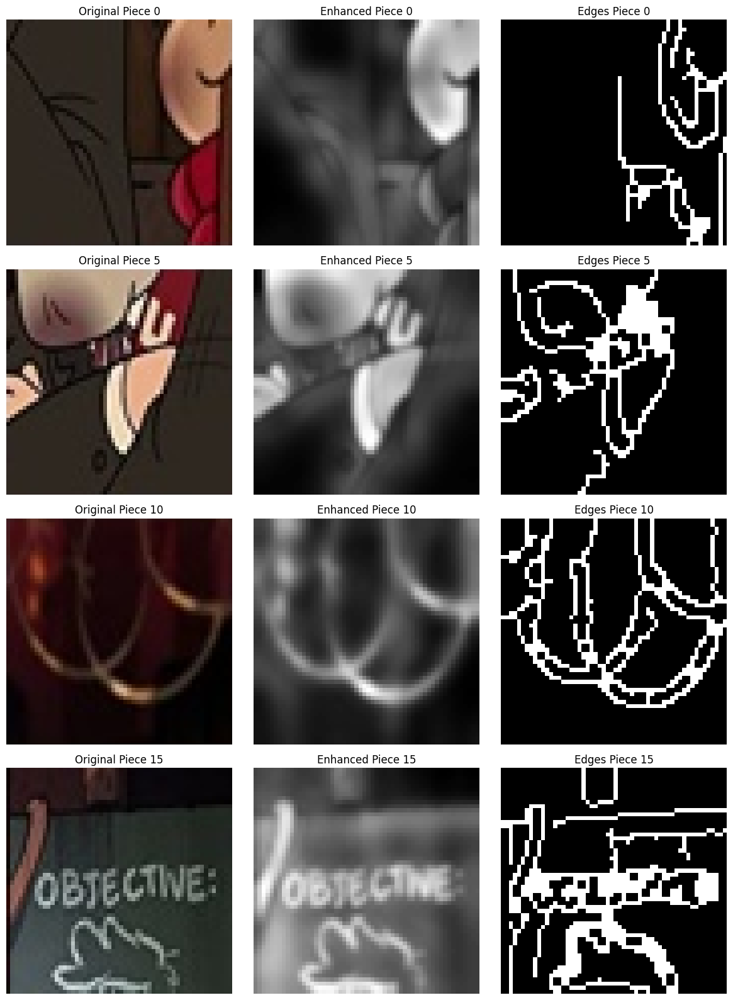

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_55
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_56
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_57
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_58
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_59
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_6
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_60
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_61
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_62
  Progress: 70/110 images processed
  Split into 16 pieces


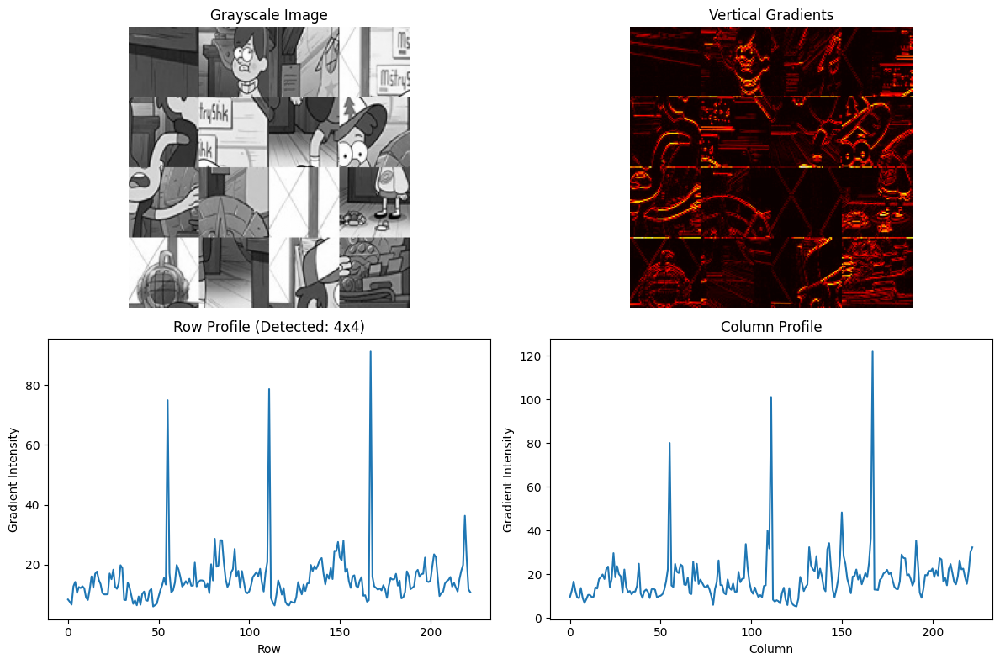

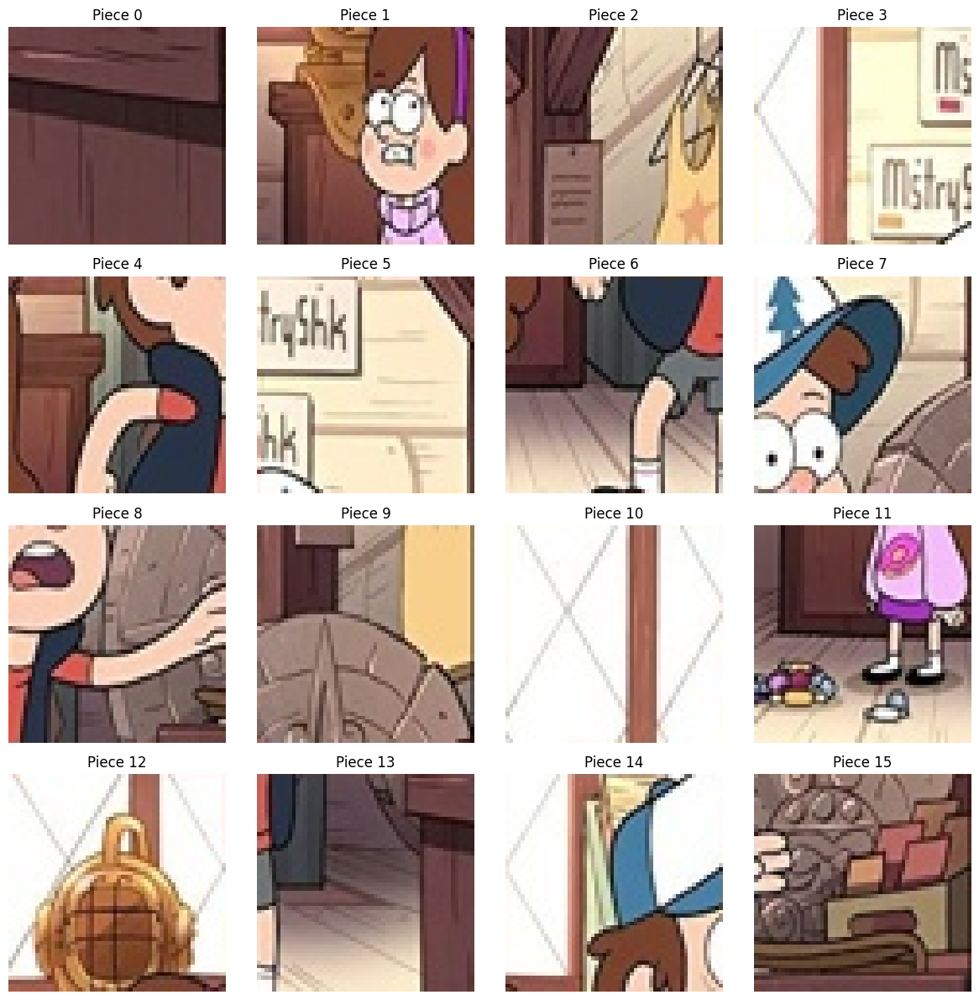

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_63


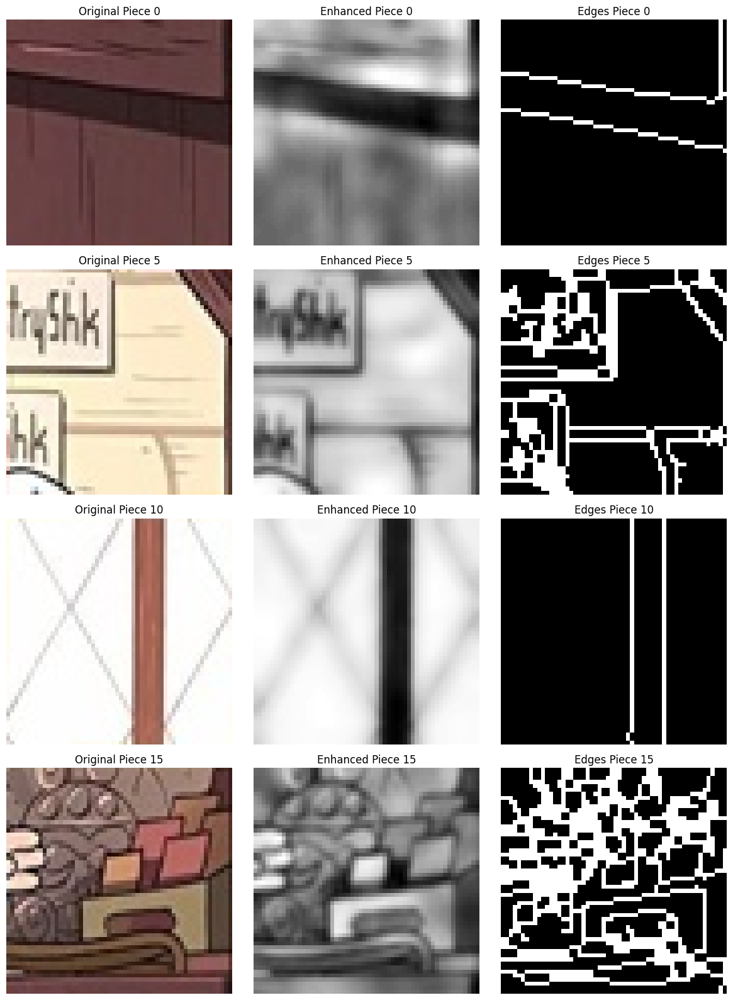

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_64
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_65
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_66
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_67
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_68
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_69
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_7
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_70
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_71
  Progress: 80/110 images processed
  Split into 16 pieces


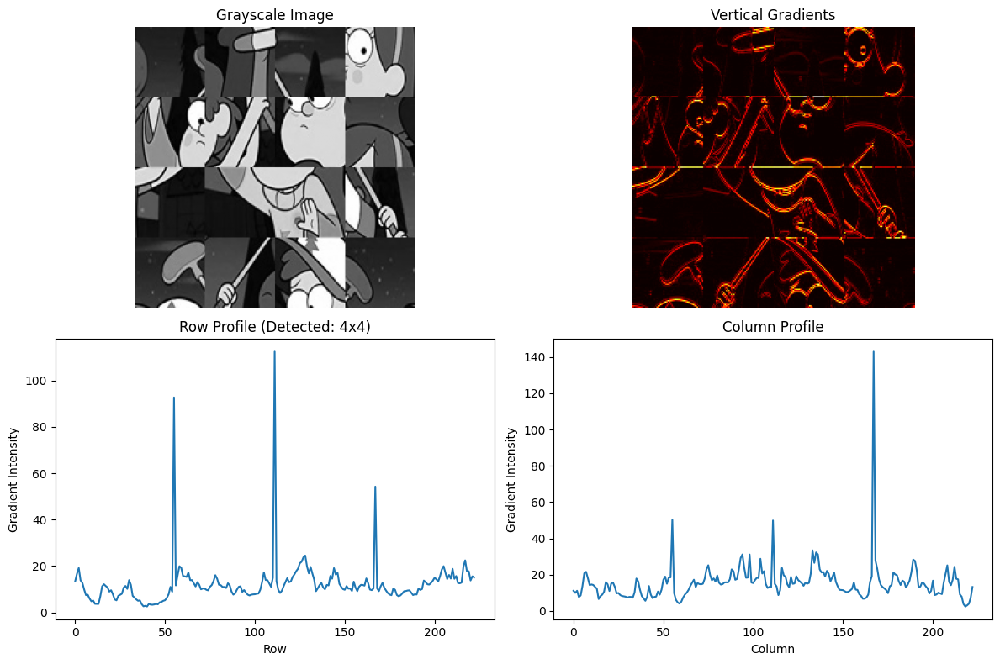

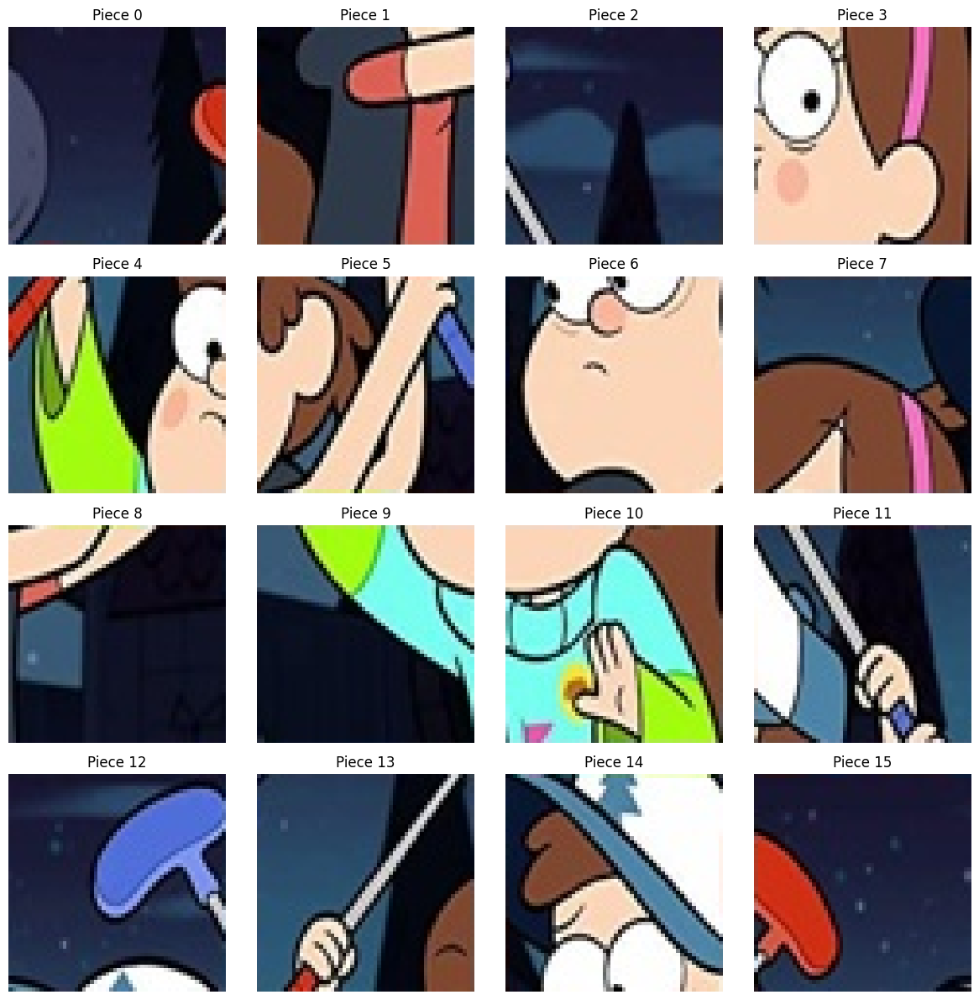

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_72


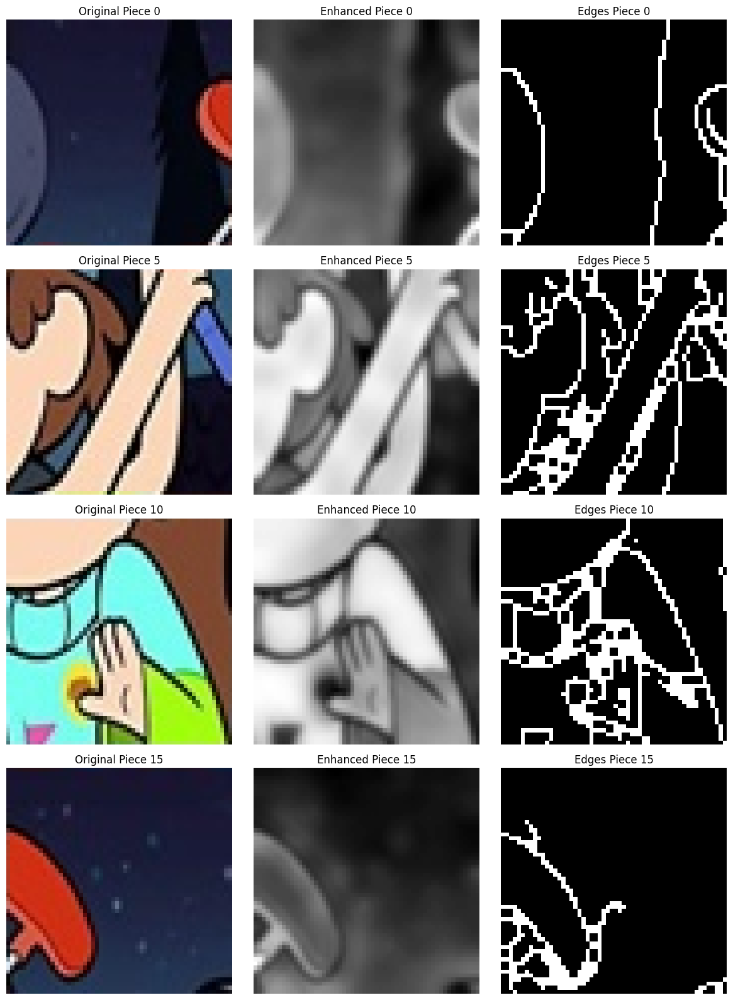

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_73
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_74
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_75
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_76
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_77
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_78
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_79
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_8
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_80
  Progress: 90/110 images processed
  Split into 16 pieces


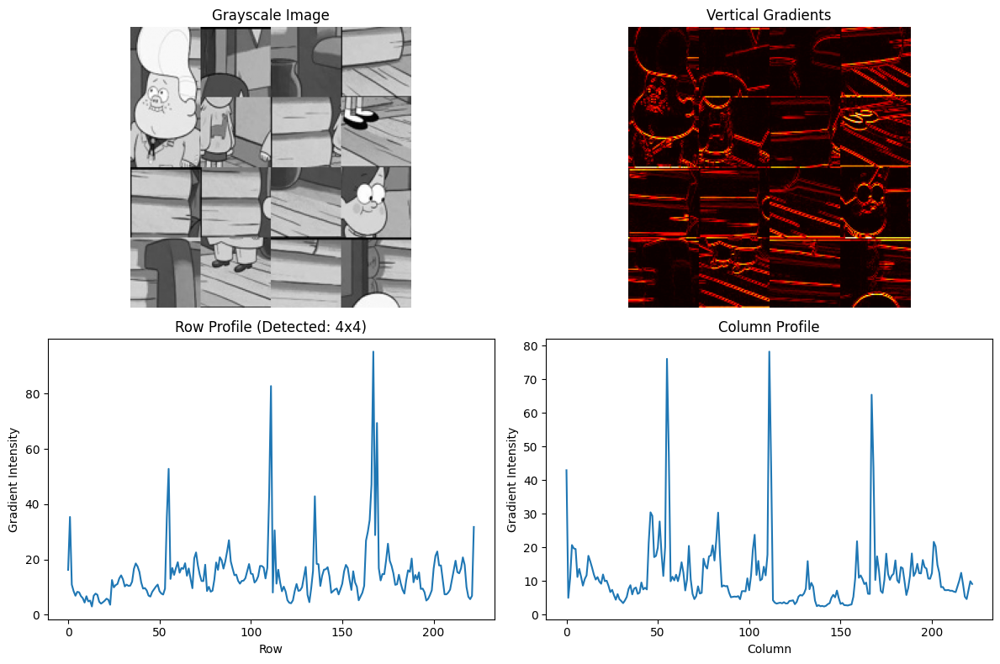

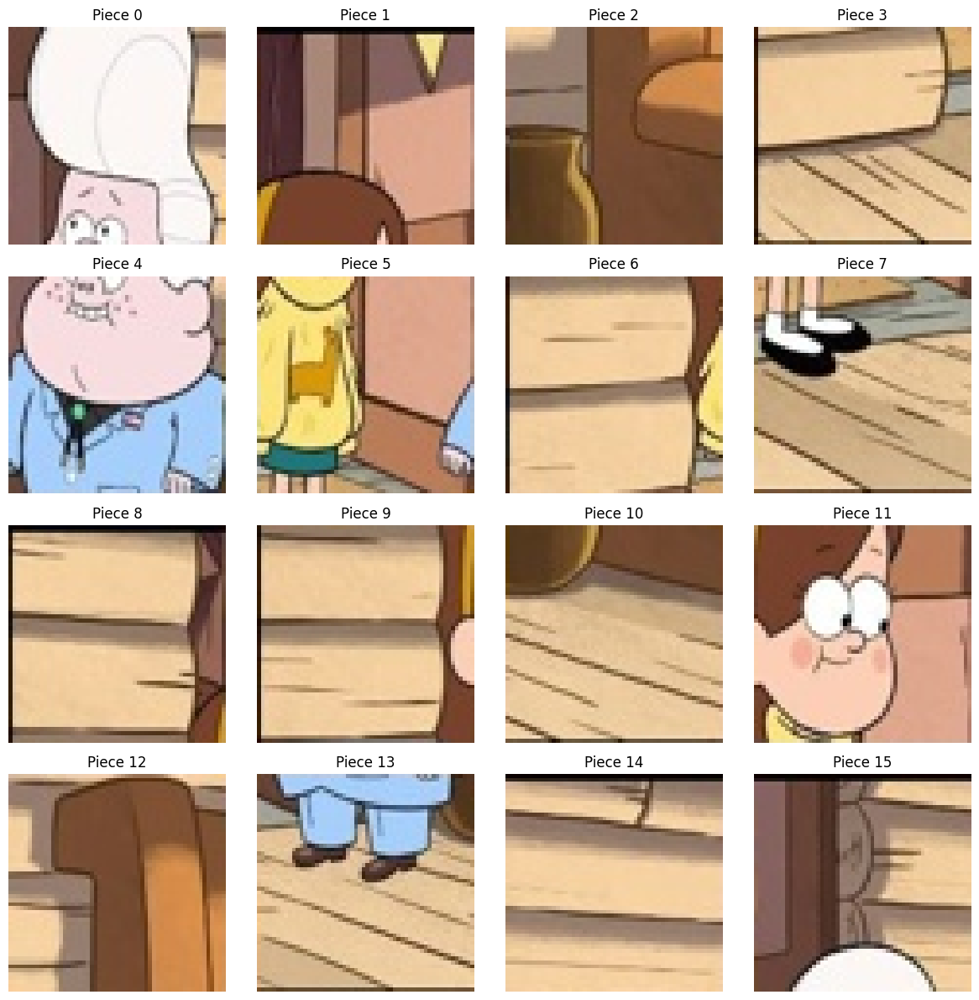

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_81


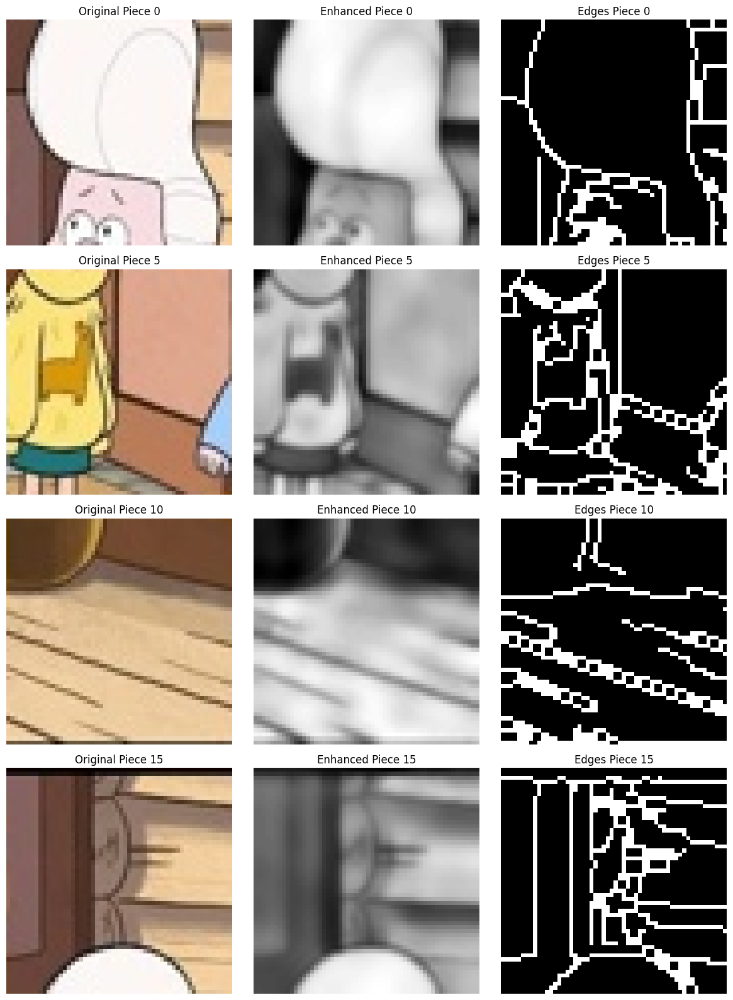

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_82
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_83
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_84
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_85
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_86
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_87
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_88
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_89
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_9
  Progress: 100/110 images processed
  Split into 16 pieces


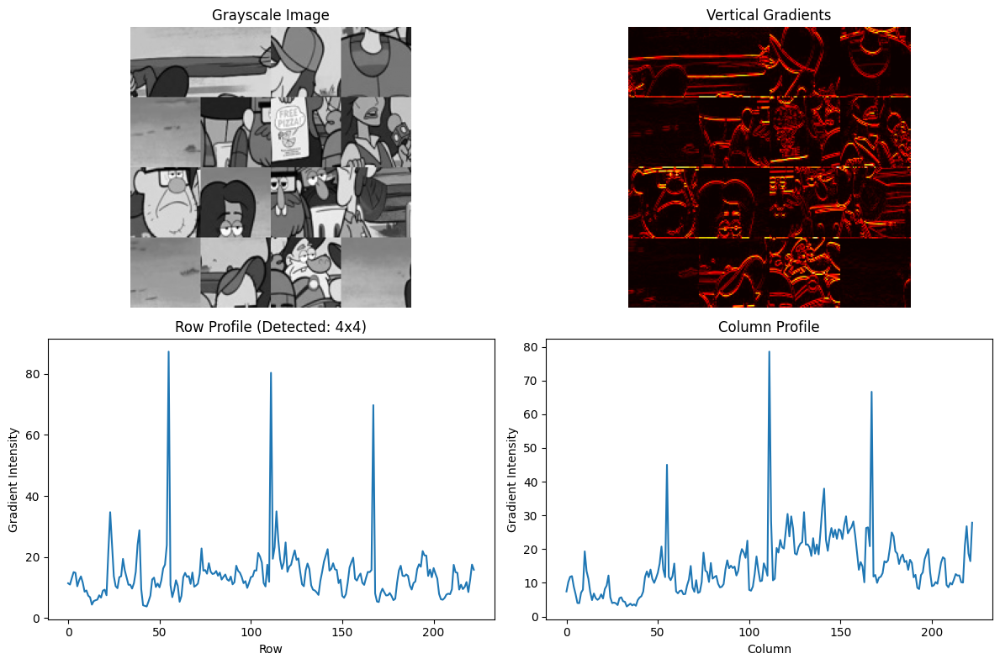

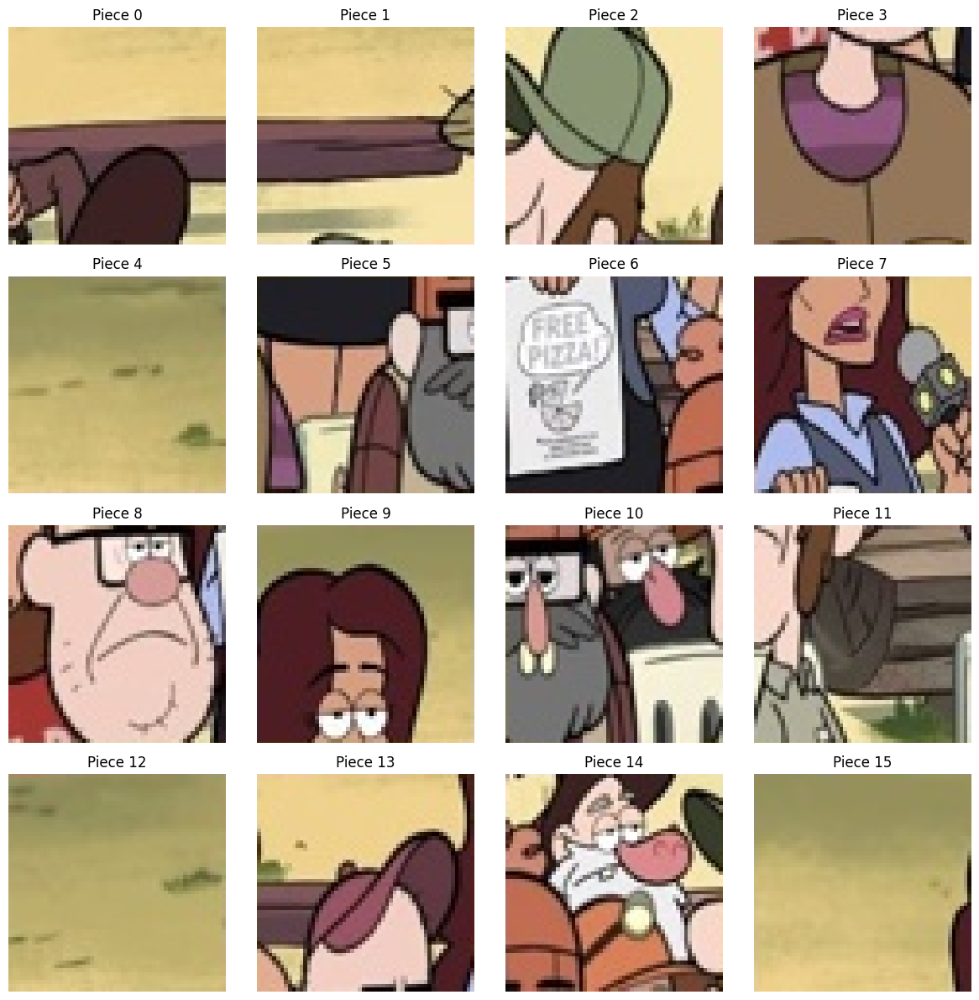

  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_90


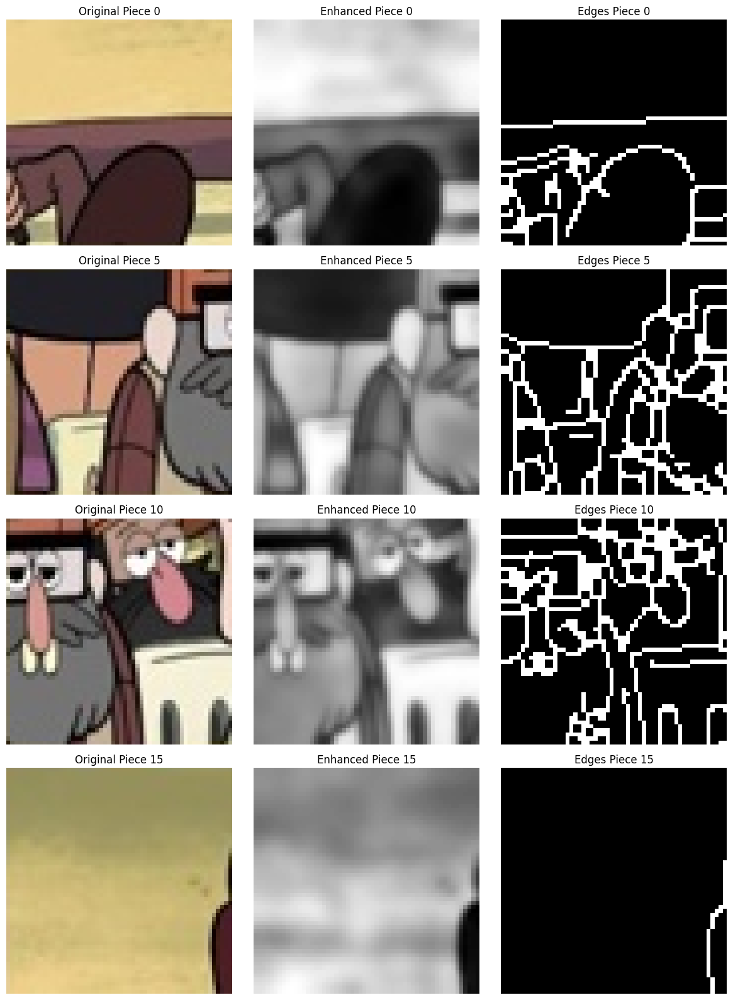

  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_91
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_92
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_93
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_94
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_95
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_96
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_97
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_98
  Split into 16 pieces
  Saved artifacts to ./processed_artifacts\puzzle_4x4\image_99
  Progress: 110/110 images processed

Processing puzzle_8x8: 110 images
  Split into 64 pieces


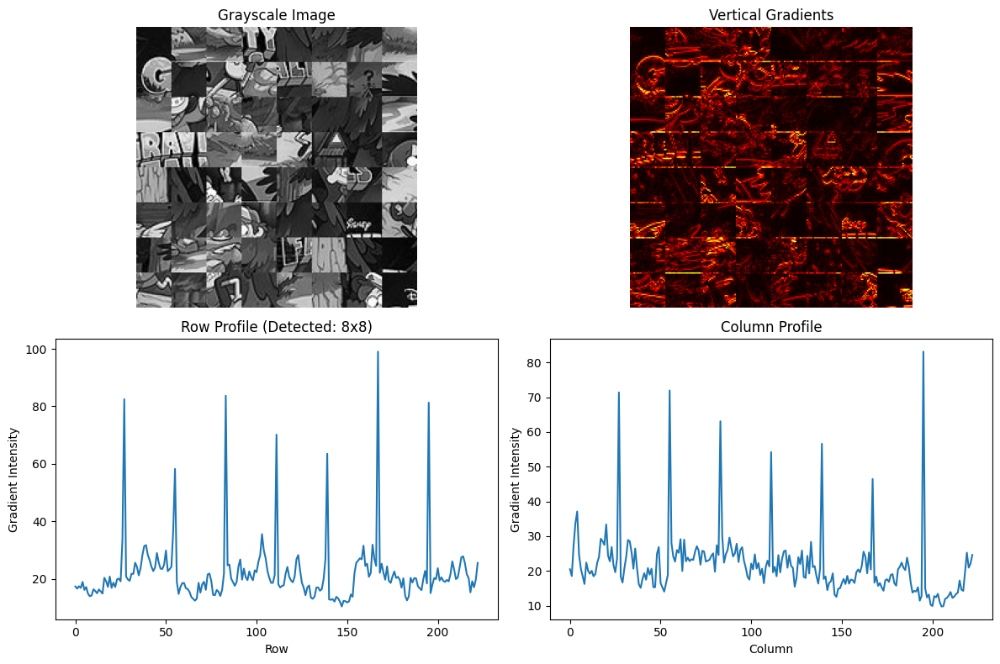

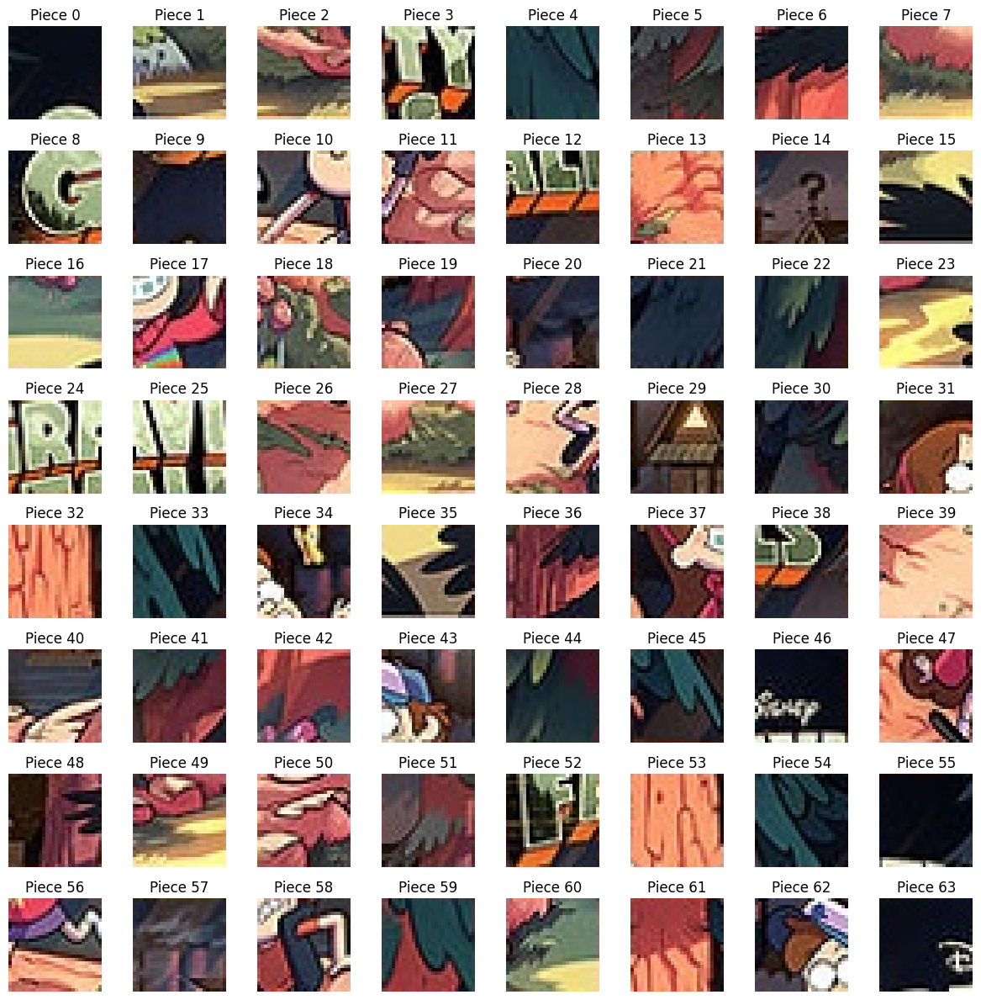

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_0


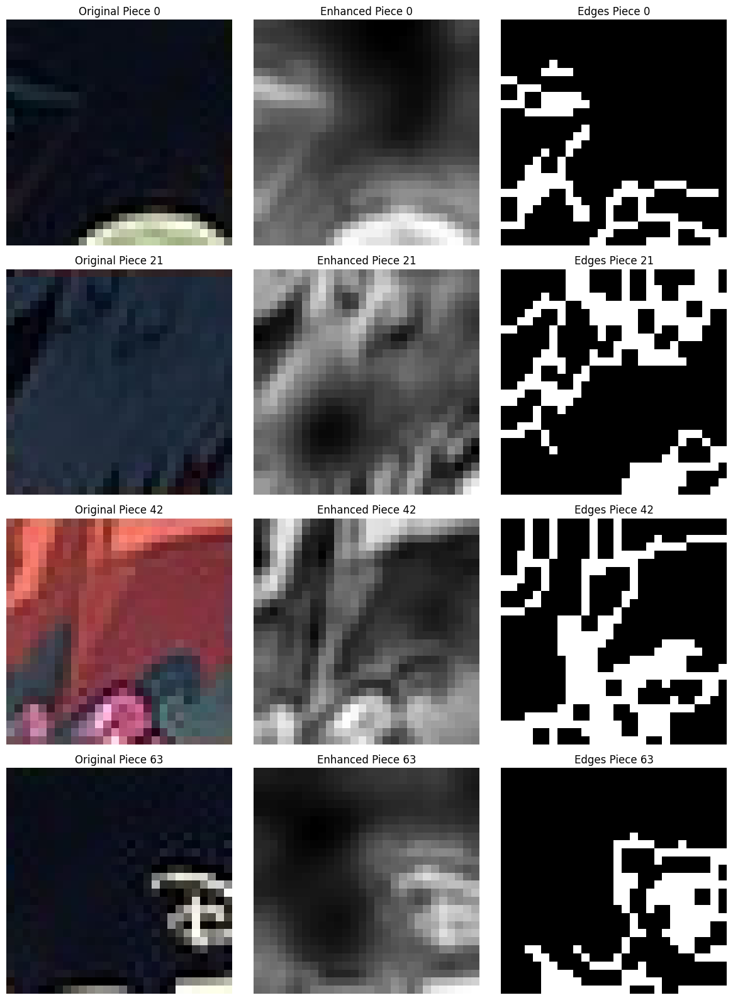

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_1
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_10
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_100
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_101
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_102
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_103
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_104
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_105
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_106
  Progress: 10/110 images processed
  Split into 64 pieces


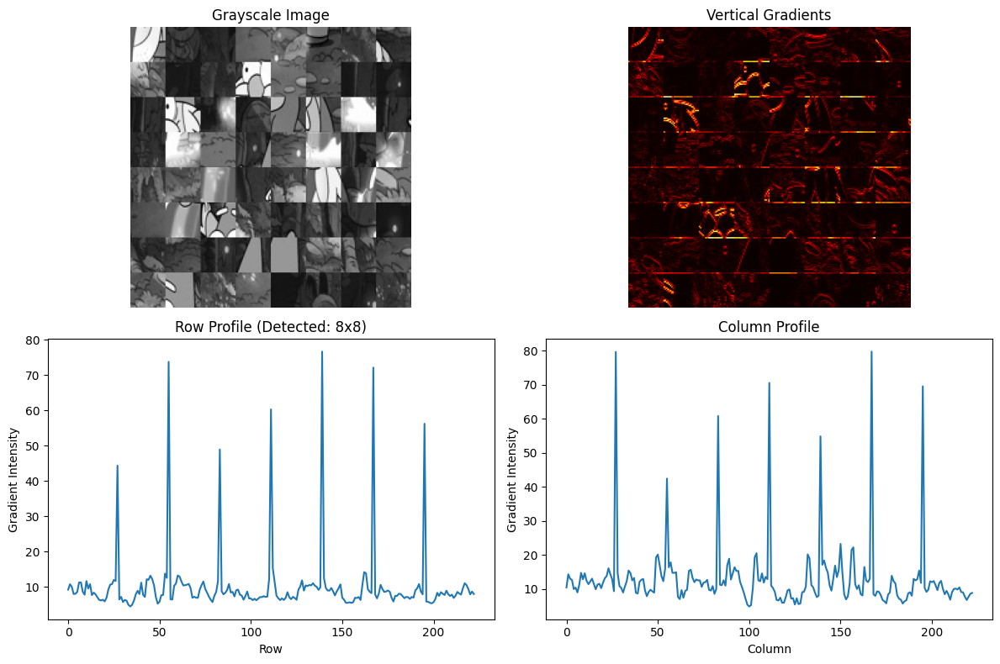

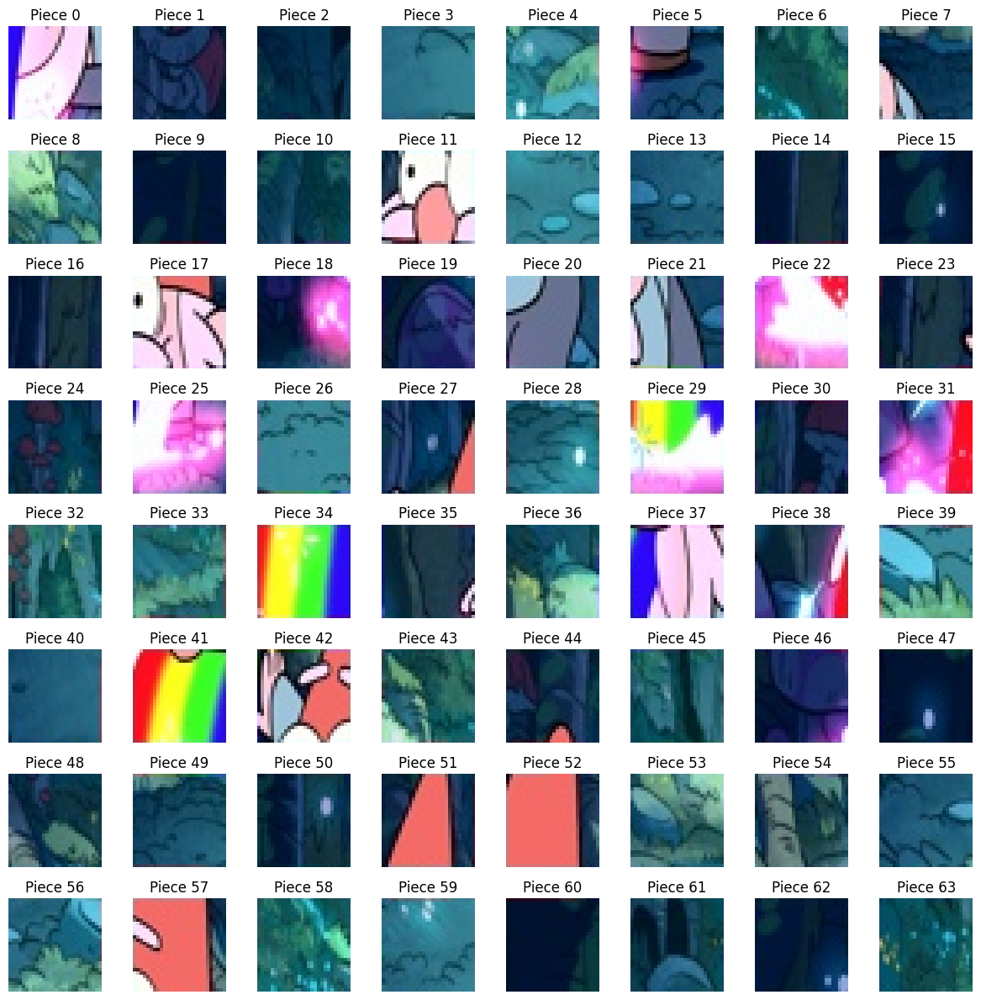

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_107


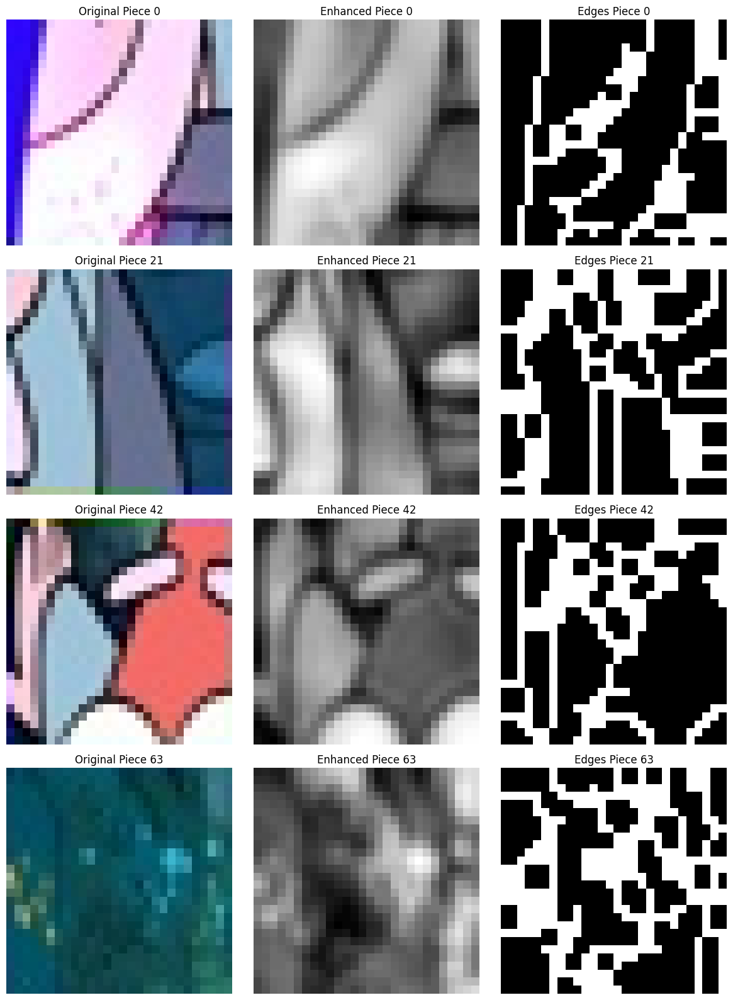

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_108
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_109
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_11
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_12
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_13
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_14
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_15
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_16
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_17
  Progress: 20/110 images processed
  Split into 64 pieces


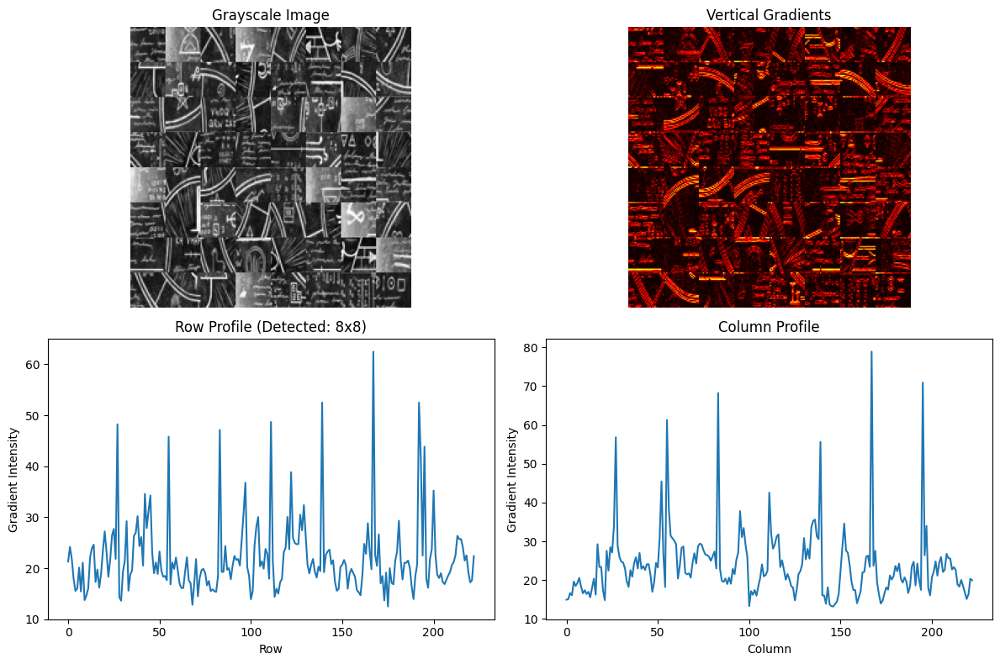

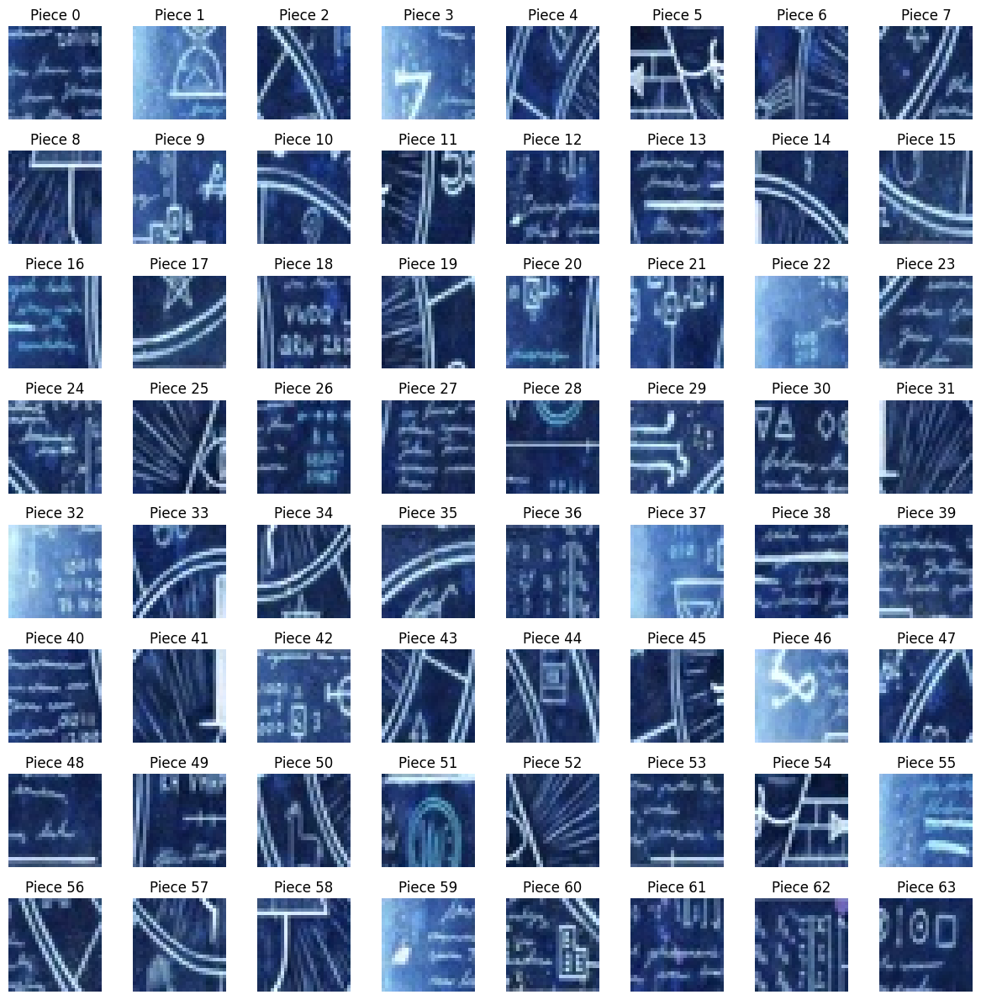

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_18


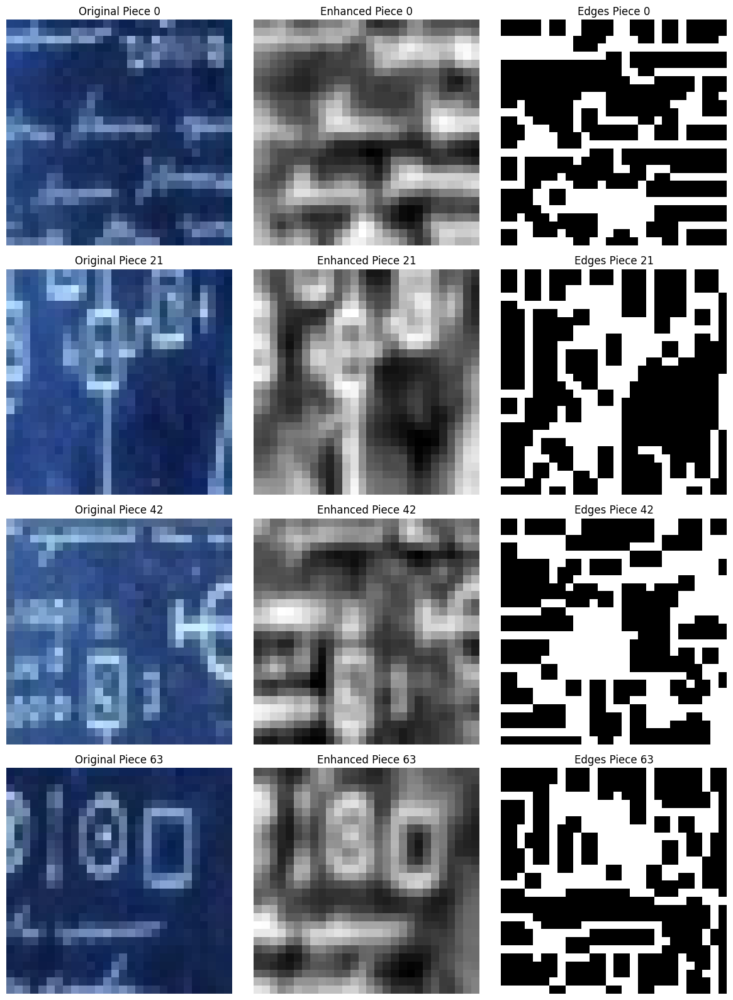

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_19
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_2
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_20
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_21
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_22
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_23
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_24
  Split into 4 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_25
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_26
  Progress: 30/110 images processed
  Split into 64 pieces


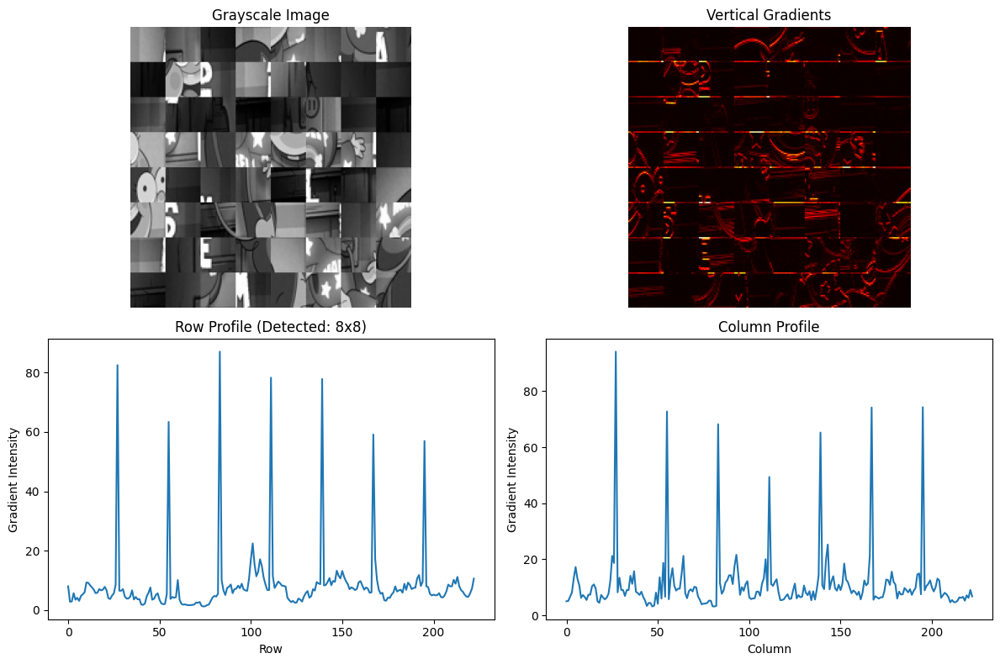

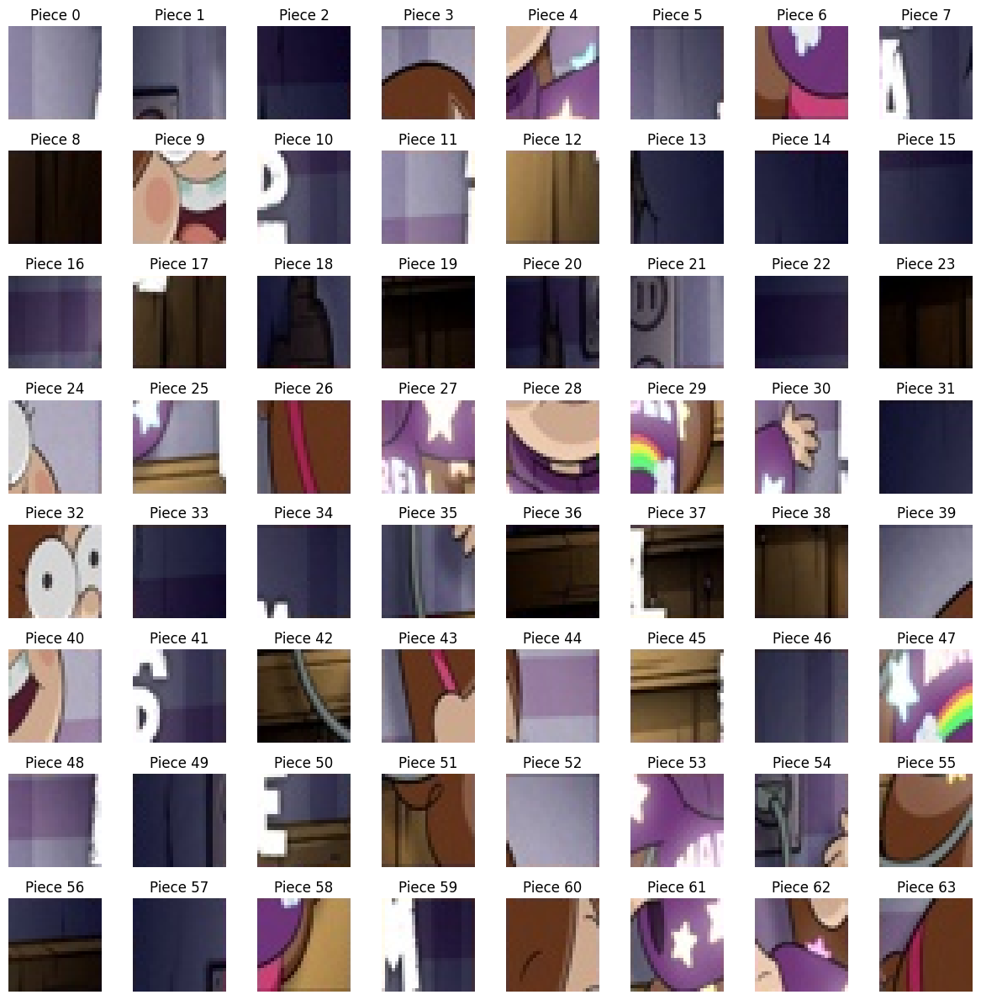

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_27


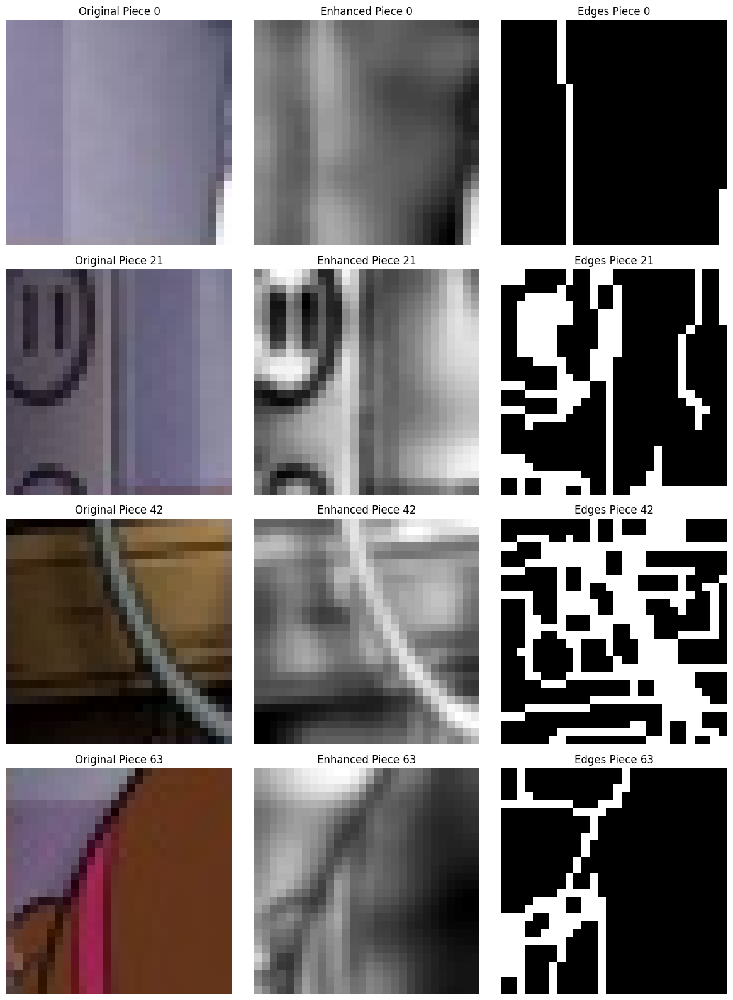

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_28
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_29
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_3
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_30
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_31
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_32
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_33
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_34
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_35
  Progress: 40/110 images processed
  Split into 64 pieces


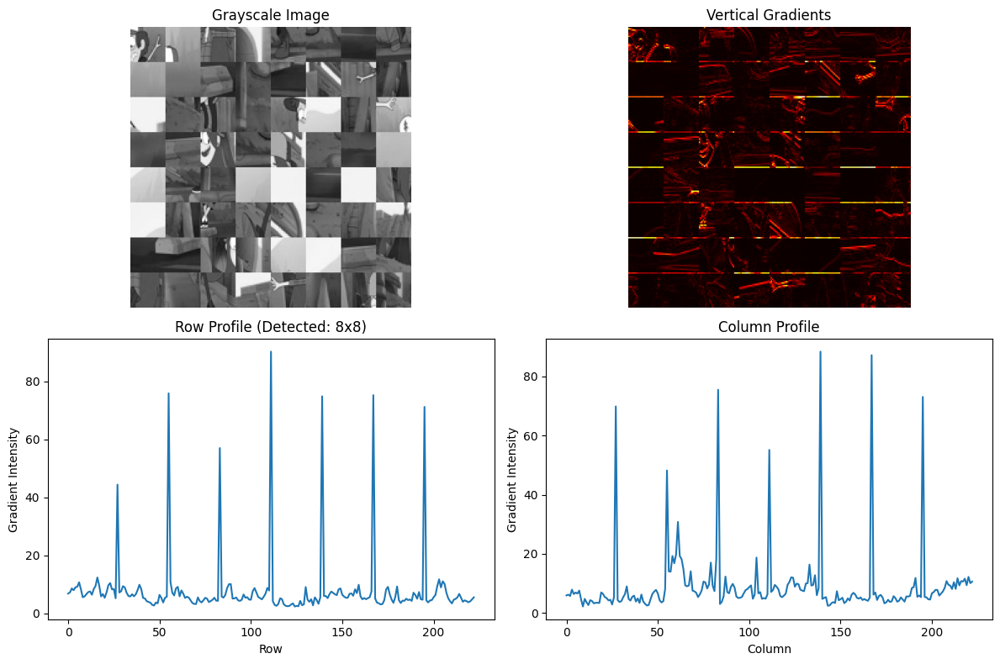

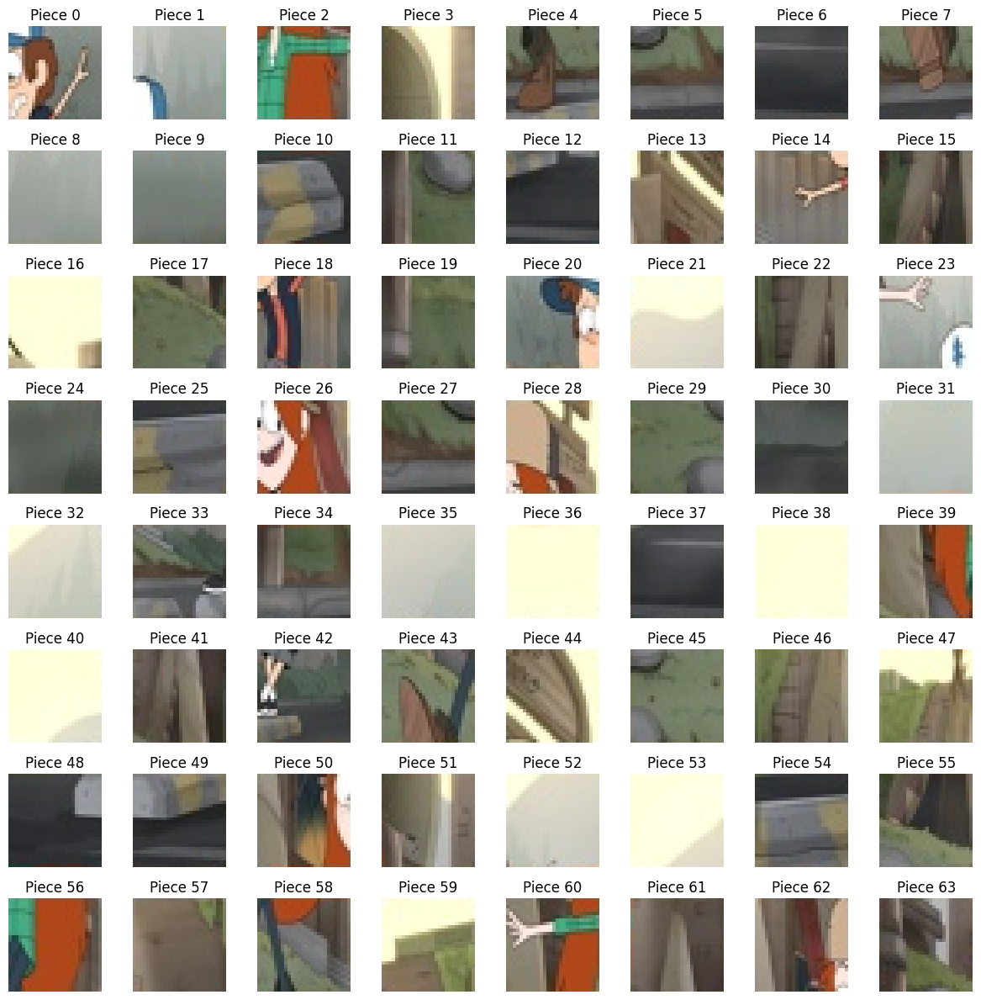

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_36


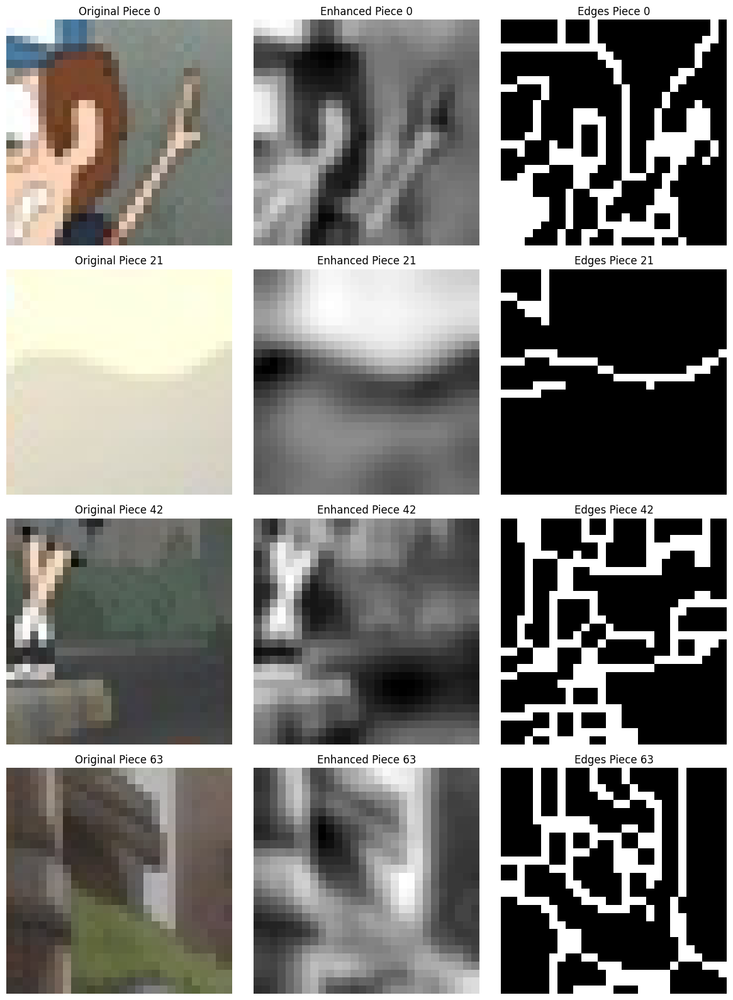

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_37
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_38
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_39
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_4
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_40
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_41
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_42
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_43
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_44
  Progress: 50/110 images processed
  Split into 64 pieces


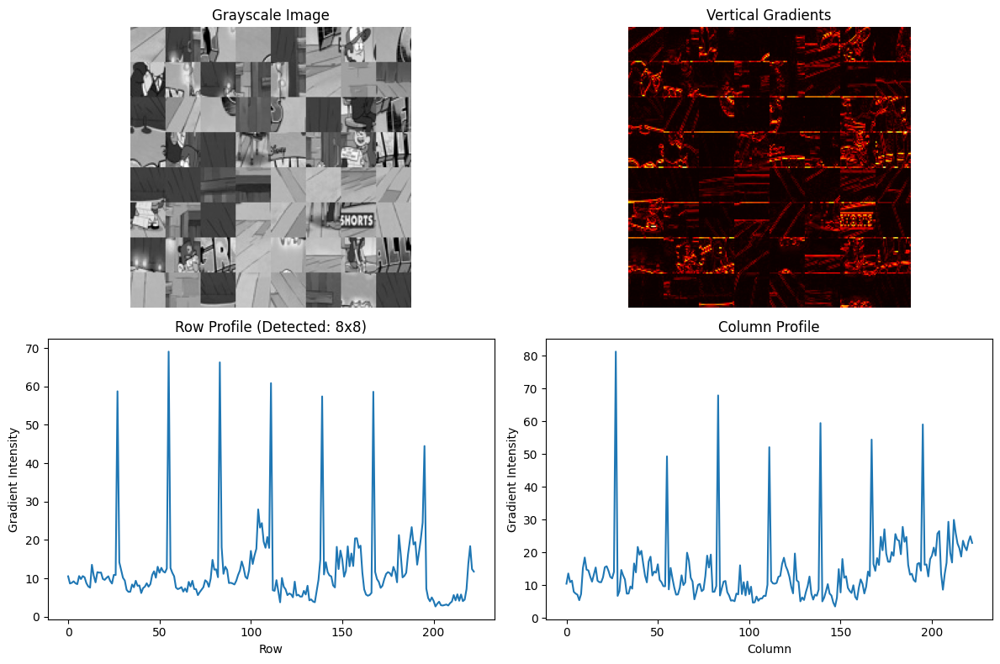

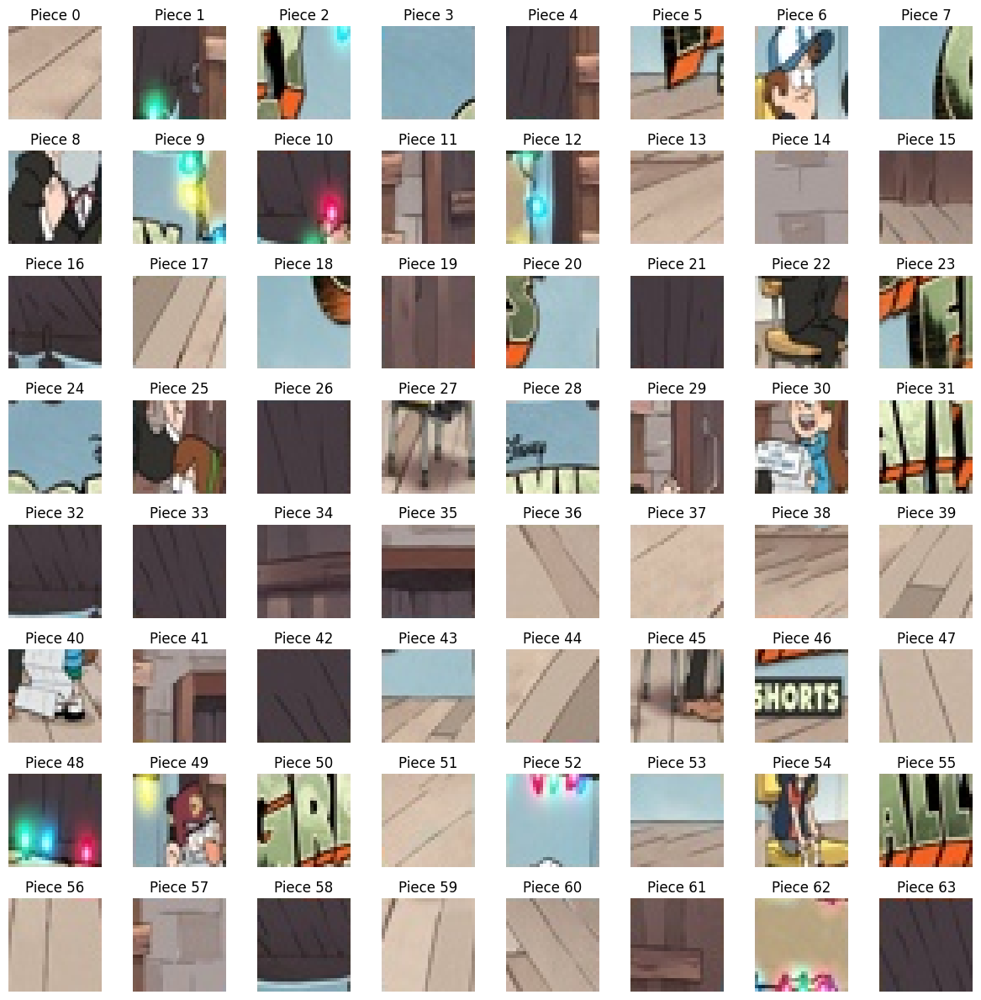

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_45


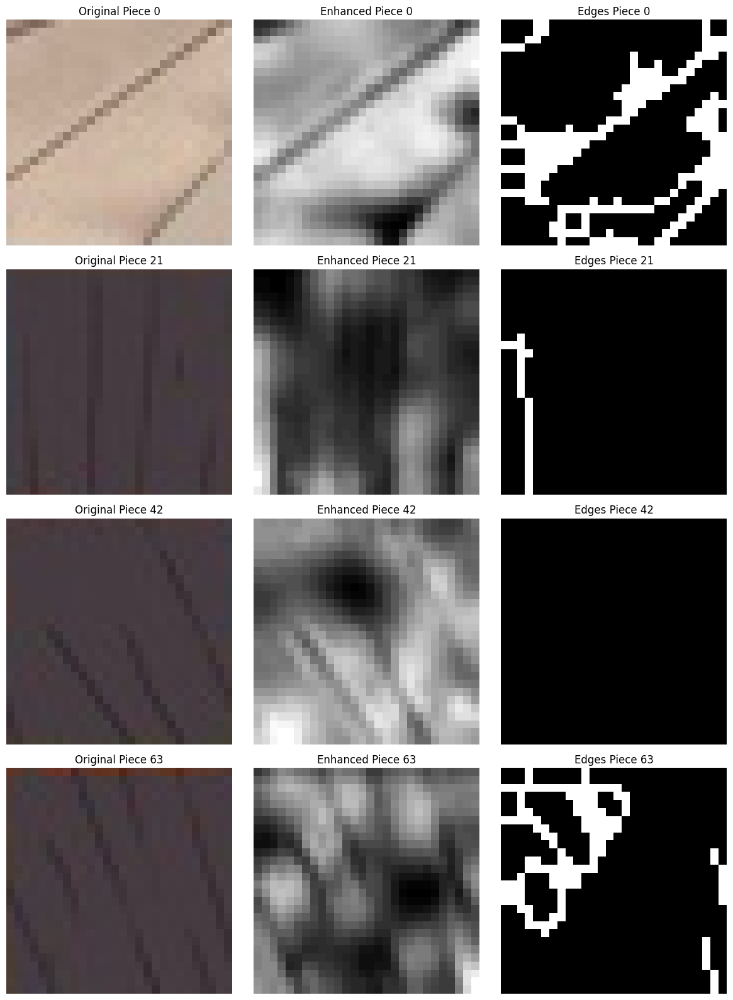

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_46
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_47
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_48
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_49
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_5
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_50
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_51
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_52
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_53
  Progress: 60/110 images processed
  Split into 64 pieces


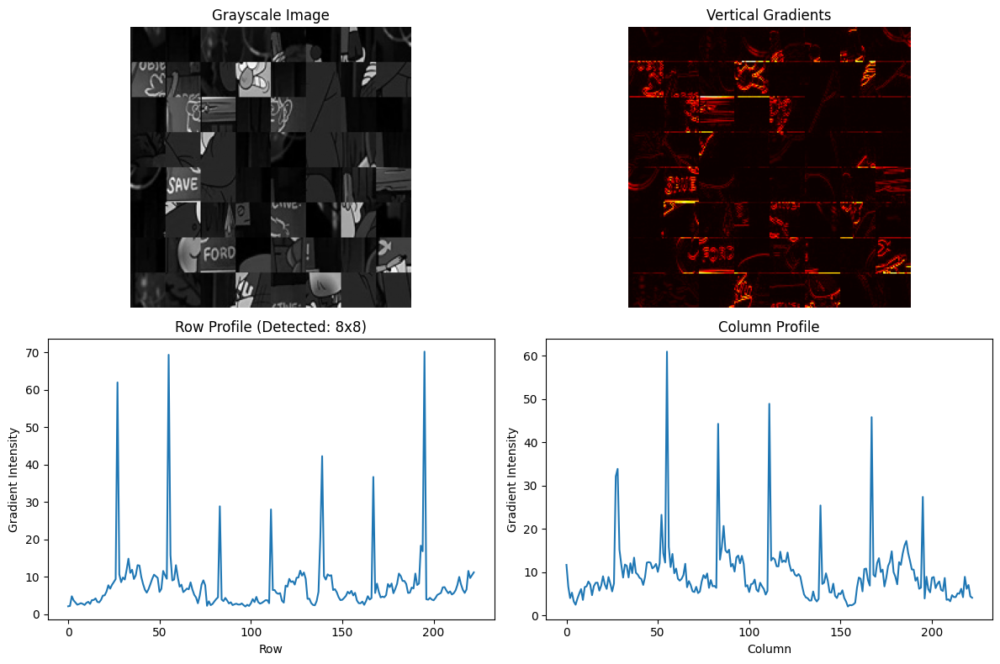

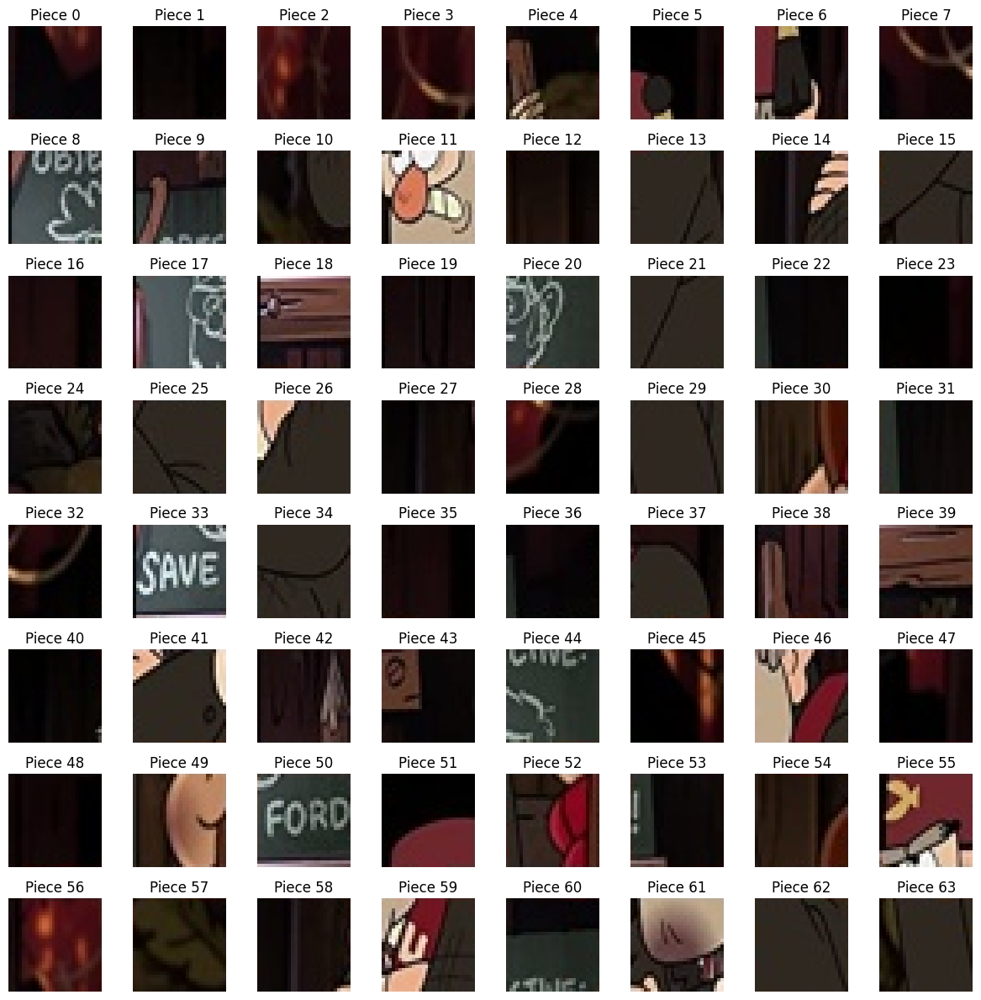

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_54


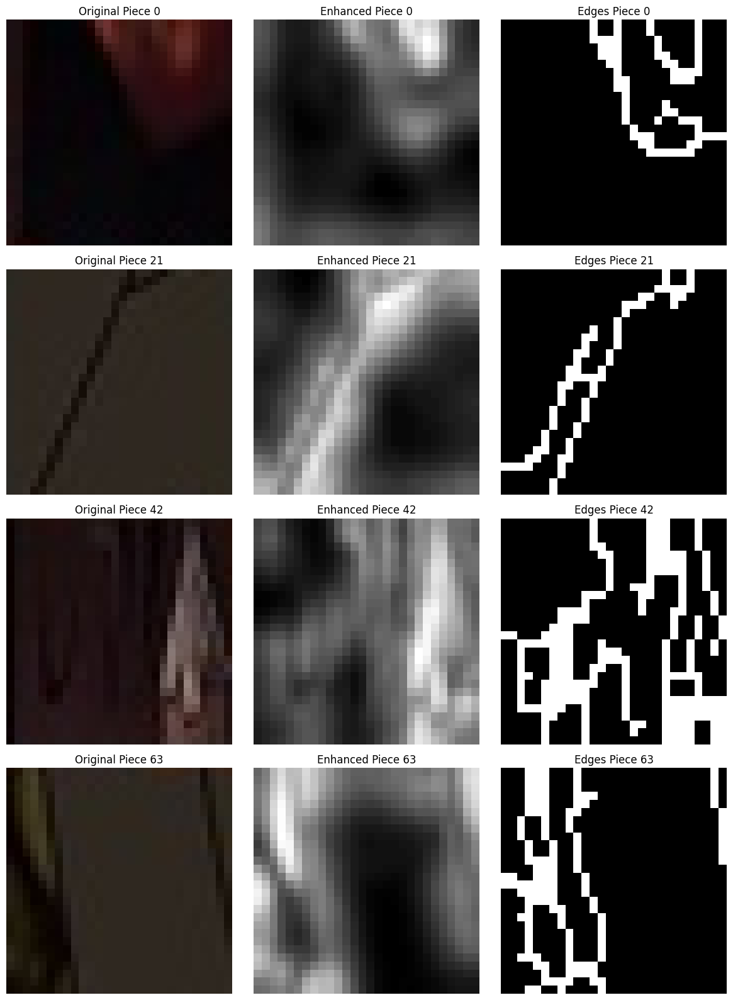

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_55
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_56
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_57
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_58
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_59
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_6
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_60
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_61
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_62
  Progress: 70/110 images processed
  Split into 64 pieces


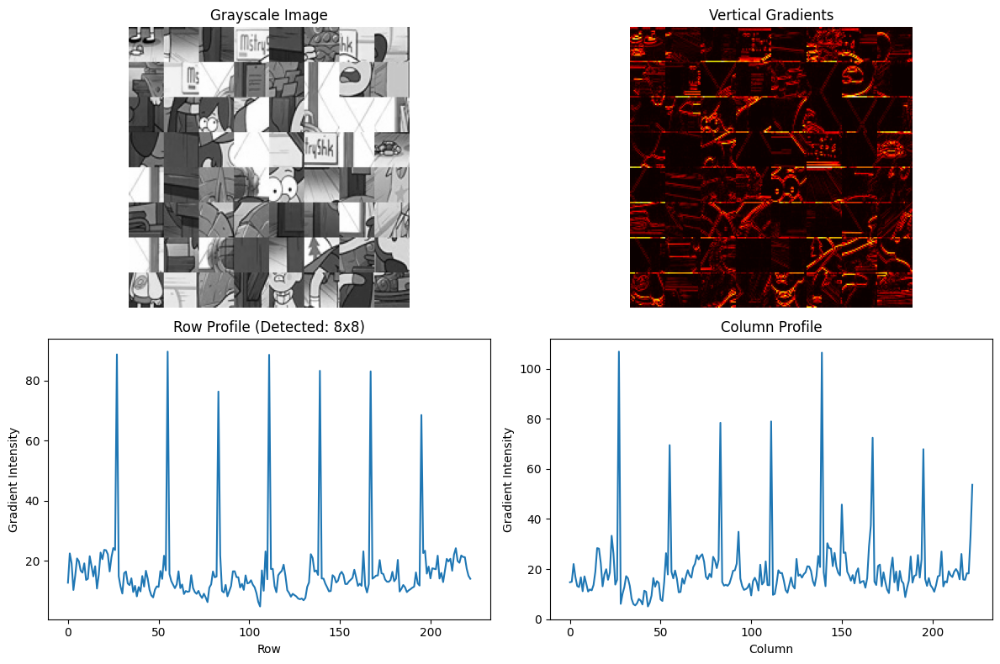

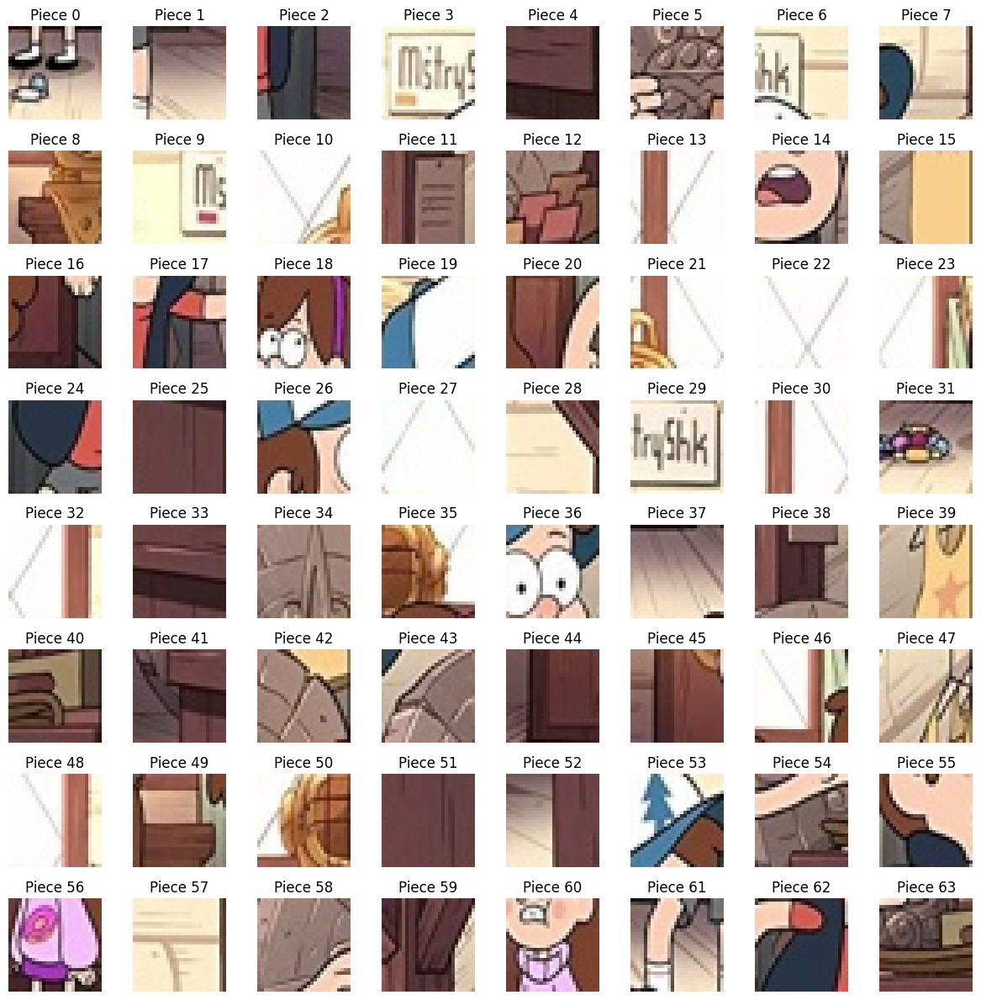

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_63


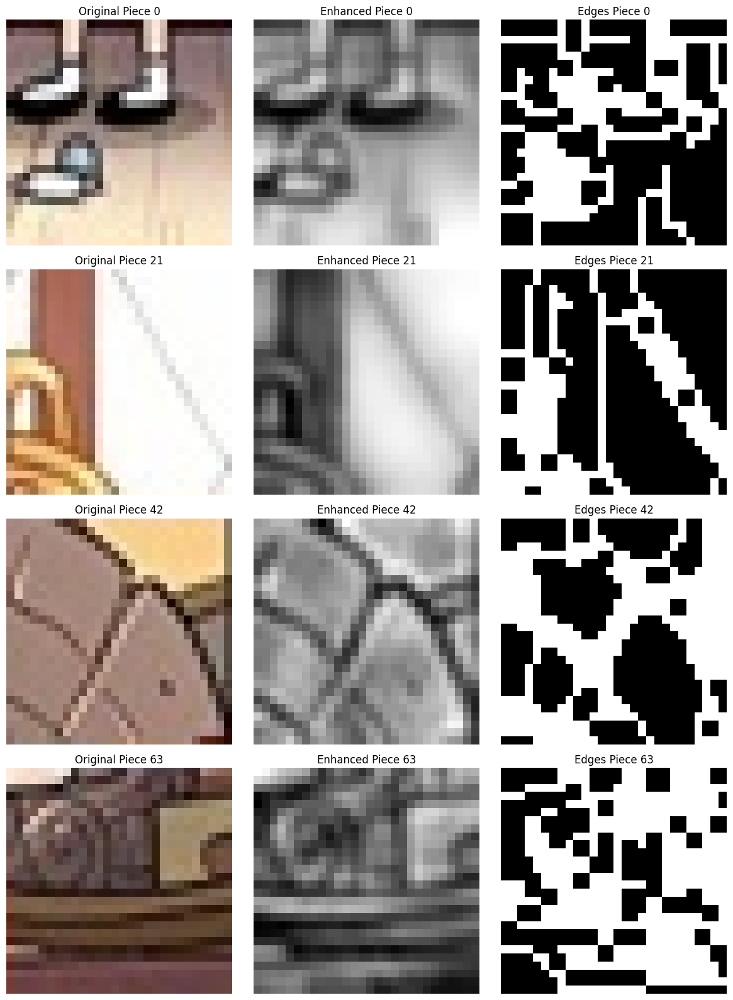

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_64
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_65
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_66
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_67
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_68
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_69
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_7
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_70
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_71
  Progress: 80/110 images processed
  Split into 64 pieces


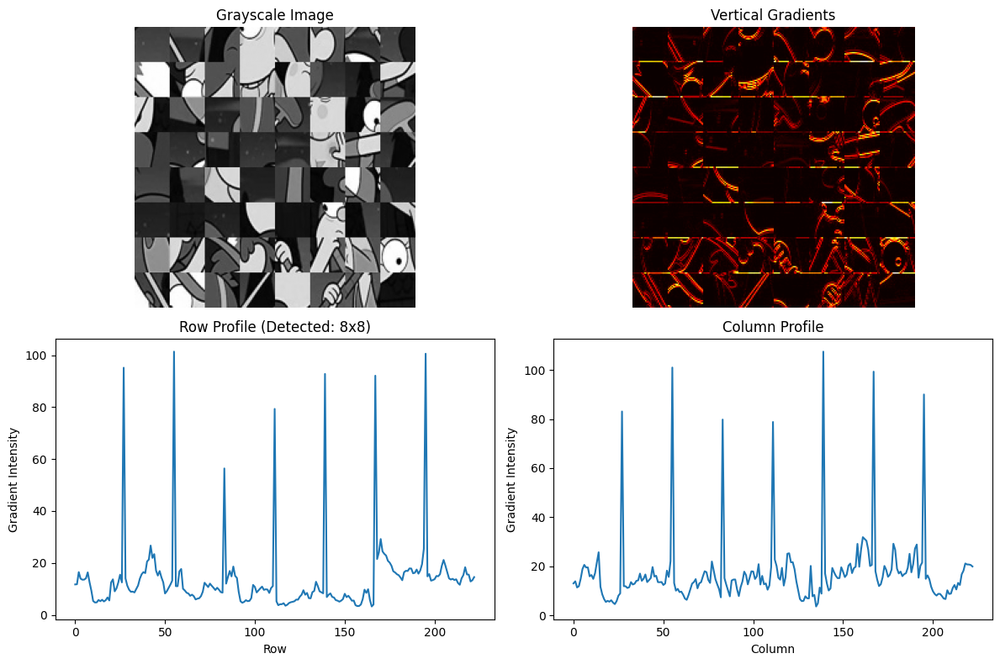

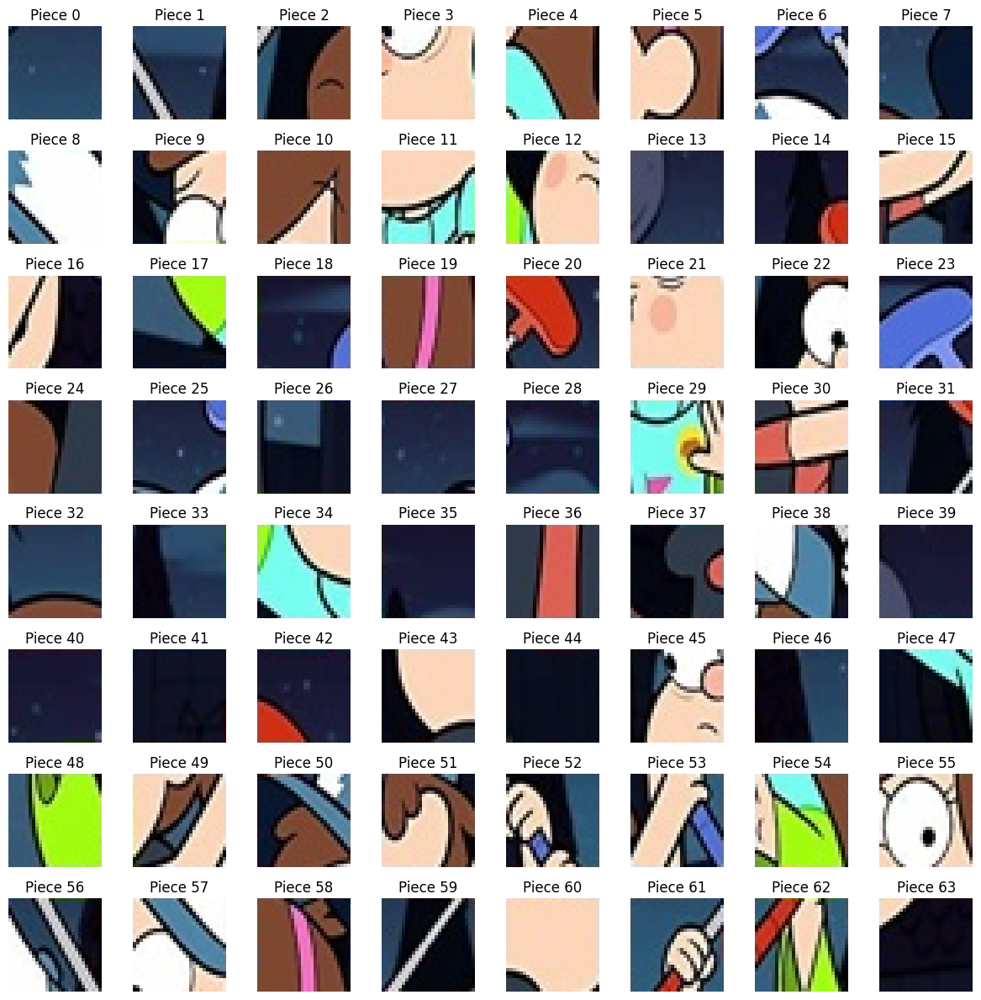

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_72


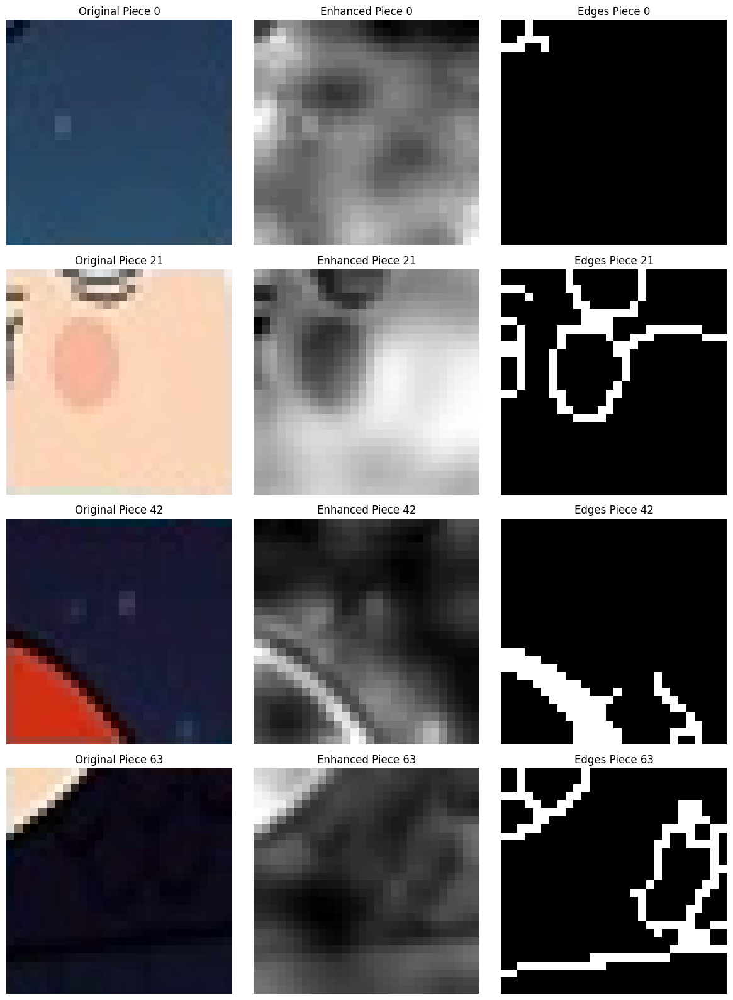

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_73
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_74
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_75
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_76
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_77
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_78
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_79
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_8
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_80
  Progress: 90/110 images processed
  Split into 64 pieces


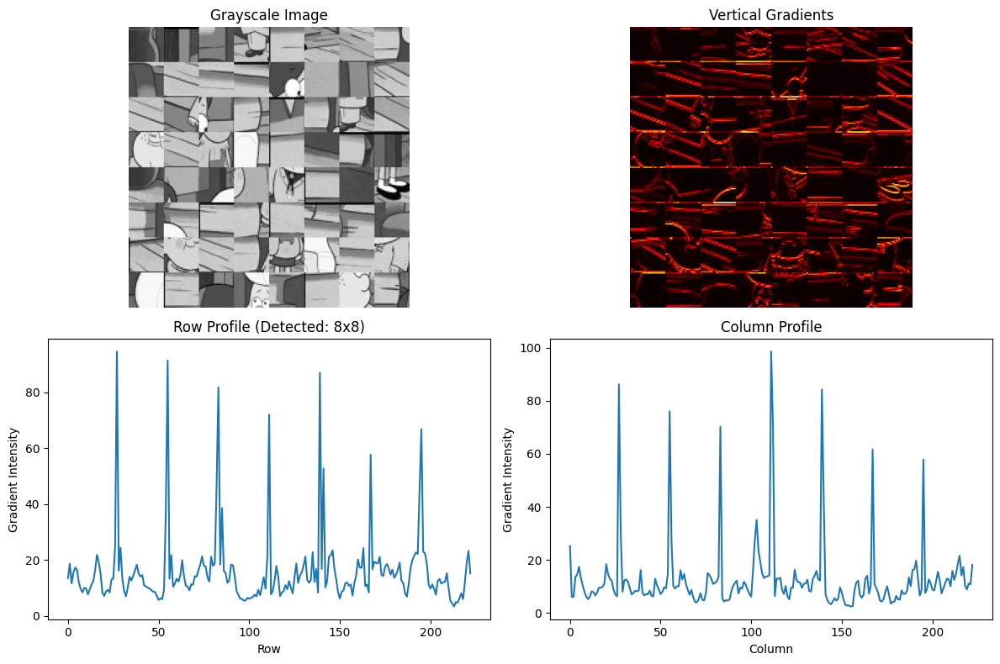

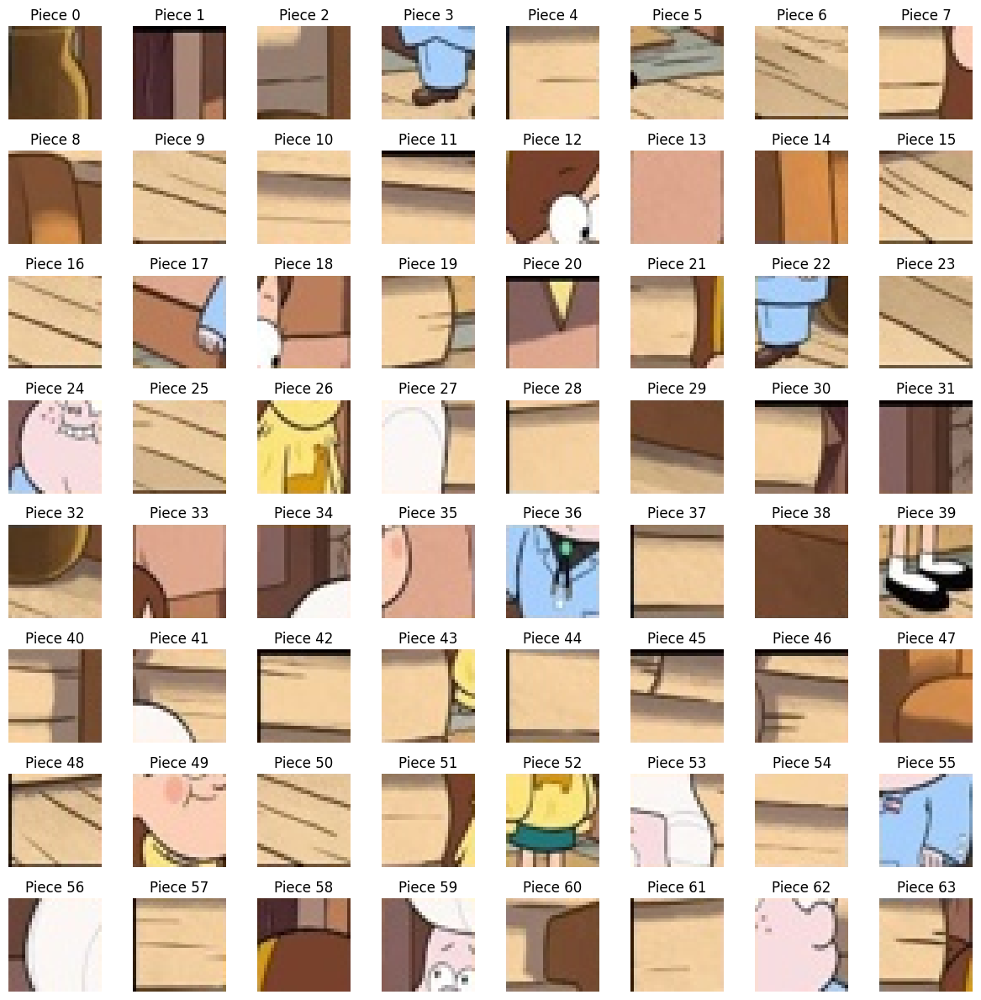

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_81


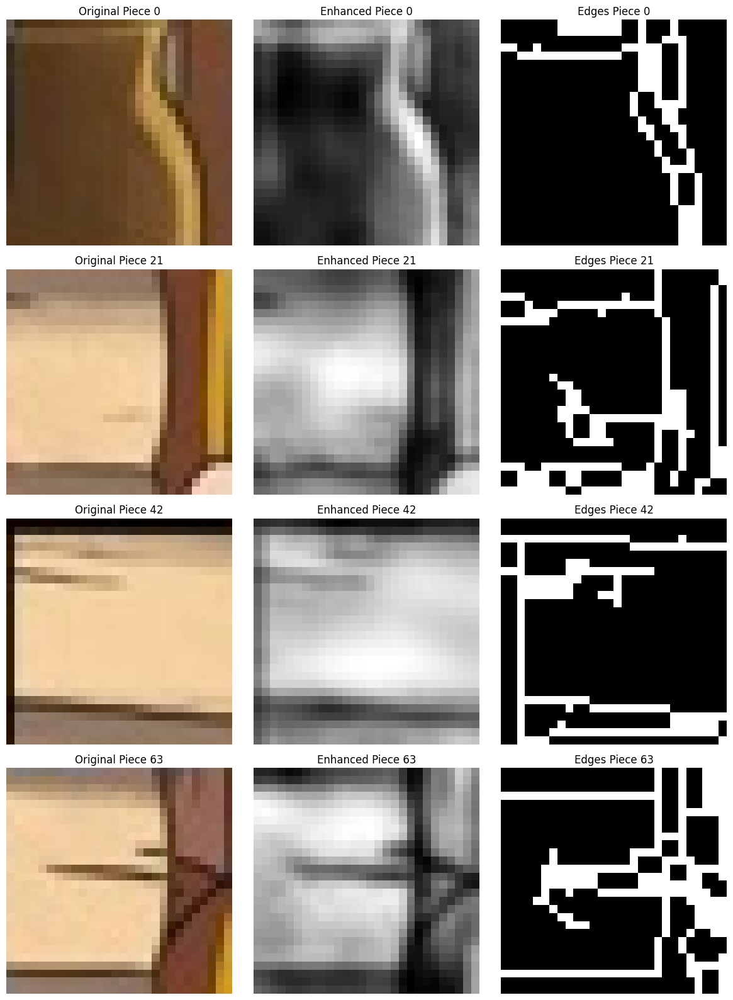

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_82
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_83
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_84
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_85
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_86
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_87
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_88
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_89
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_9
  Progress: 100/110 images processed
  Split into 64 pieces


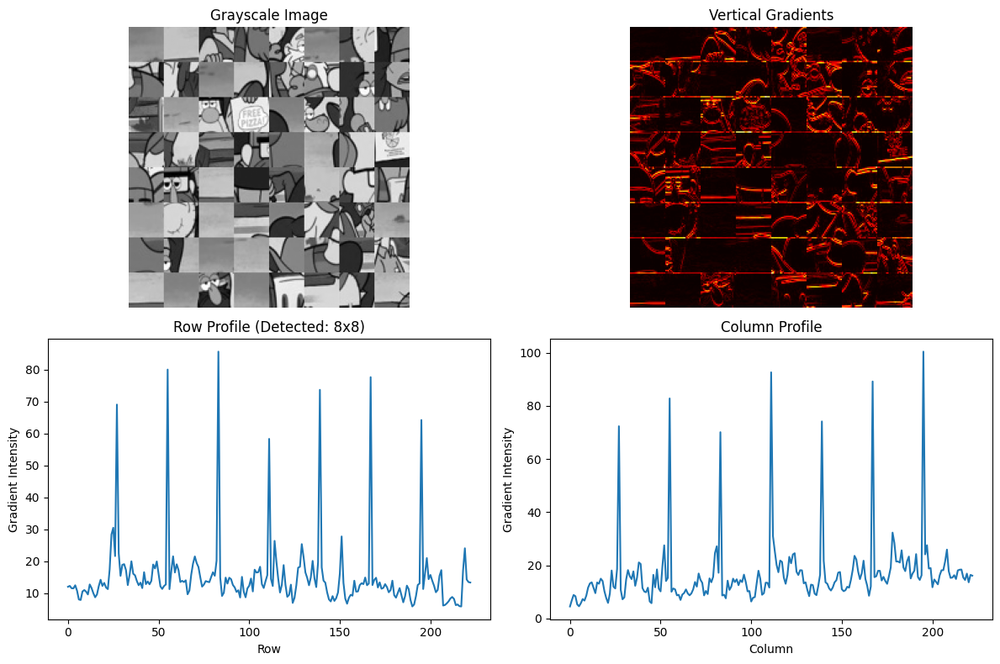

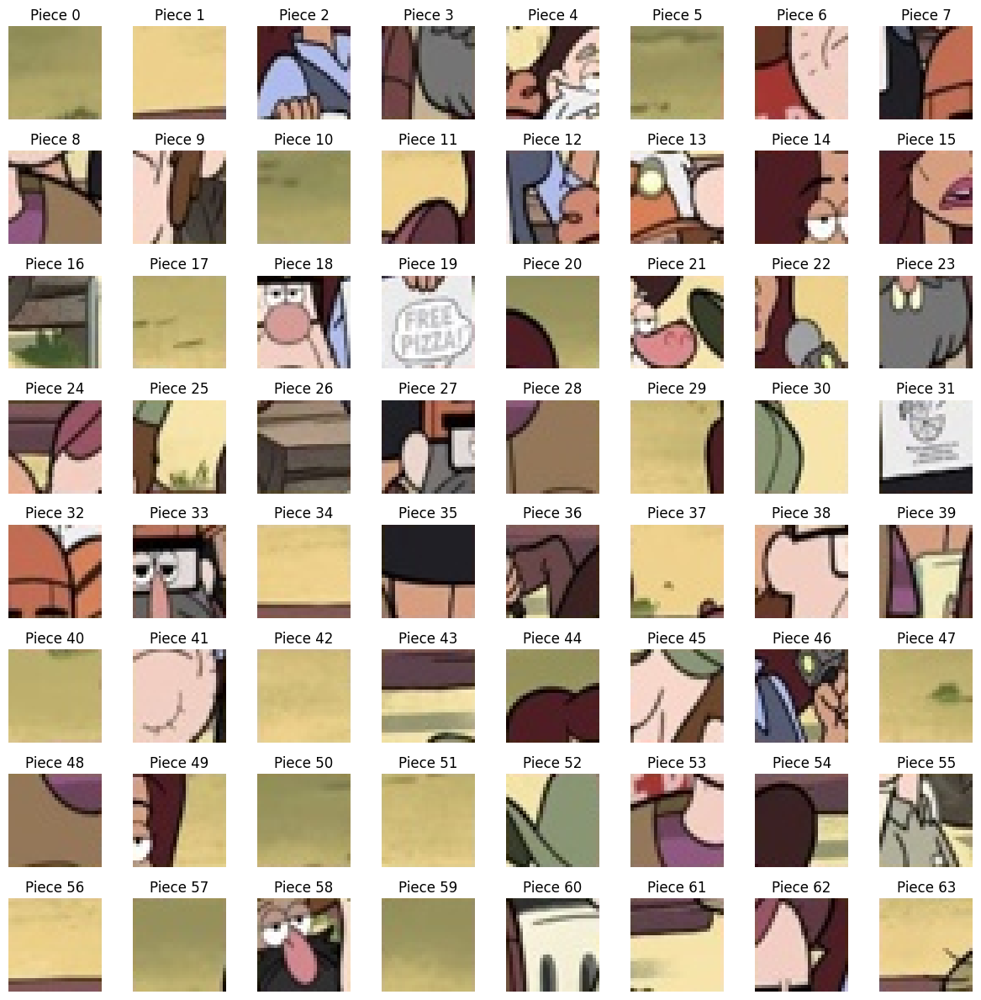

  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_90


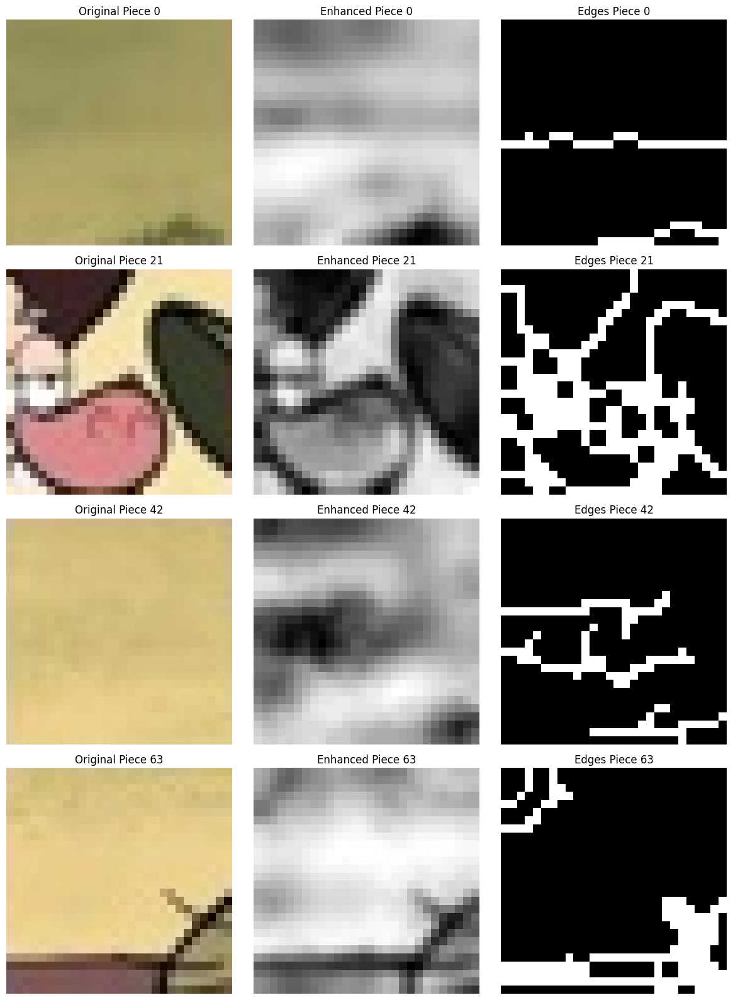

  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_91
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_92
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_93
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_94
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_95
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_96
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_97
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_98
  Split into 64 pieces
  Saved artifacts to ./processed_artifacts\puzzle_8x8\image_99
  Progress: 110/110 images processed

Processing Complete!
Total images processed: 330
Summary saved to: ./processed_artifacts\processing_summary.json


In [8]:
# Process entire dataset
# Uncomment the line below to process all images
results, summary = process_dataset(BASE_DIR, OUTPUT_DIR, max_images_per_type=None, visualize_every_n=10)

# Or process a subset for testing:
# results, summary = process_dataset(BASE_DIR, OUTPUT_DIR, max_images_per_type=5, visualize_every_n=1)


## 8. View Processing Summary


In [9]:
# Load and display processing summary
summary_path = os.path.join(OUTPUT_DIR, 'processing_summary.json')

if os.path.exists(summary_path):
    with open(summary_path, 'r') as f:
        summary = json.load(f)
    
    print("Processing Summary:")
    print(f"Total images processed: {summary['total_images_processed']}")
    print("\nResults by puzzle type:")
    for puzzle_type, count in summary['results_by_type'].items():
        print(f"  {puzzle_type}: {count} images")
    print("\nProcessing parameters:")
    for param, value in summary['processing_parameters'].items():
        print(f"  {param}: {value}")
else:
    print("No summary file found. Run batch processing first.")


Processing Summary:
Total images processed: 330

Results by puzzle type:
  puzzle_2x2: 110 images
  puzzle_4x4: 110 images
  puzzle_8x8: 110 images

Processing parameters:
  gaussian_kernel_size: [5, 5]
  canny_low: 50
  canny_high: 150
  clahe_clip_limit: 2.0
  clahe_tile_size: [8, 8]
